# NN track reco on pseudodata

The data input and NN architecture are largely following the HEPTrkX example.
The input here is including all straws for each event, which may be inefficient and alternatives should be explored.

## Generate straw tracker pseudodata

In [1]:
import os,sys
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

In [2]:
class Detector():
    """
    Simulate a 2D rectangular straw setup.
    Made of successive modules, each one consisting of U/V double layers of straws.
    """
    n_modules=8 ## number of modules, each with 4 layers of straws
    n_layersPerModule=4
    n_layers = n_modules*n_layersPerModule
    n_straws=32 #or 16, or 24 -- allow for variable number of straws per layer
    
    straw_radius=0.5 # [cm]
    straw_distance=1.2 # distance between neighboring straw centers in same layer [cm]
    UV_distance=1.7   # distance between successive U/V submodules [cm]
    module_distance=7   # distance between successive modules [cm]
    yOffset_PerModule = 5 # y-offset per module, to allow for inward bend of tracks

    module_length = (n_layersPerModule/2)*straw_distance + UV_distance + 2*straw_radius
    length=n_modules*module_length + (n_modules-1)*module_distance
    width=n_straws*straw_distance+2*straw_radius
    
    ## Occupancy characteristics
    avg_tracks=2 ## avg number of tracks per event
    max_tracks=4 ## max number of tracks allowed per event

    
    layers=np.zeros(n_layers)
    straws=np.zeros(n_straws)
    x=np.zeros(n_layers)
    y=np.zeros((n_layers, n_straws))
    
    def make_straws(self):
        ## returns the x,y (length,width) vectors of straw locations
        for i_module in range(self.n_modules):
            for i_layer in range(self.n_layersPerModule):
                layer = i_module*self.n_layersPerModule + i_layer
                self.layers[layer]=layer
                layer_x = i_module*self.module_length + self.straw_radius
                if i_module>0: layer_x += i_module*self.module_distance
                if i_layer>=1: layer_x += self.straw_distance
                if i_layer>=2: layer_x += self.UV_distance
                if i_layer==3: layer_x += self.straw_distance
                self.x[layer] = layer_x
                ## vertical stagger for this layer:
                if (i_layer==1) or (i_layer==2):  stagger = self.straw_distance/2
                else: stagger=0
                for i_straw in range(self.n_straws):
                    #if (i_module<=2) and (i_straw>=16): continue
                    #if (i_module<=5) and (i_straw>=24): continue
                    if i_module==8: self.straws[i_straw]=i_straw
                    self.y[layer][i_straw]=i_module*self.yOffset_PerModule + i_straw*self.straw_distance + stagger

In [3]:
tracker=Detector()
tracker.make_straws()
print (tracker.x, '\n', tracker.y)

[ 0.5  1.7  3.4  4.6 12.6 13.8 15.5 16.7 24.7 25.9 27.6 28.8 36.8 38.
 39.7 40.9 48.9 50.1 51.8 53.  61.  62.2 63.9 65.1 73.1 74.3 76.  77.2
 85.2 86.4 88.1 89.3] 
 [[ 0.   1.2  2.4 ... 34.8 36.  37.2]
 [ 0.6  1.8  3.  ... 35.4 36.6 37.8]
 [ 0.6  1.8  3.  ... 35.4 36.6 37.8]
 ...
 [35.6 36.8 38.  ... 70.4 71.6 72.8]
 [35.6 36.8 38.  ... 70.4 71.6 72.8]
 [35.  36.2 37.4 ... 69.8 71.  72.2]]


In [4]:
def display_event(detector, straw_hits=None, track_ids=None, figsize=(15, 8)):
    """
    Draw hits and tracks from a single event (time window) in detector.
    Parameters:
        detector: The DetectorGeometry object
        straw_hits: 2D array with the straws that are hit in the event
        track_ids: The track identifier corresponding to each hit
    """

    fig, ax = plt.subplots(figsize=figsize) # note we must use plt.subplots, not plt.subplot
    
    full_width = detector.width + detector.n_modules * detector.yOffset_PerModule
    ax.set_xlim((-0.1*detector.length, 1.1*detector.length))
    ax.set_ylim((-0.1*full_width, 1.1*full_width))

    ## plot a circle at the location of each straw
    for i_layer in range(detector.n_layers):
        for i_straw in range(detector.n_straws):
            if (detector.x[i_layer]==0) or (detector.y[i_layer][i_straw]==0): continue
            circle = plt.Circle((detector.x[i_layer], detector.y[i_layer][i_straw]), detector.straw_radius, color='black', fill=False)
            ax.add_patch(circle)
    
    if straw_hits is not None:
        ## plot all hits
        layers,straws=np.where(straw_hits==1)
        ax.scatter(detector.x[layers],detector.y[layers,straws], marker='.', color='black')

    if track_ids is not None:
        ## plot all tracks with a separate color
        for itrack in range(1,int(np.max(track_ids))+1):
            layers,straws=np.where(track_ids==itrack)
            plt.scatter(detector.x[layers],detector.y[layers,straws], marker='o', label='track %d'%itrack)
        
        ## plot unassigned hits if they exist
        if -1 in track_ids:
            layers,straws=np.where(track_ids==-1)
            plt.scatter(detector.x[layers],detector.y[layers,straws], marker='o', color='black', label='unassigned hits')



    plt.legend(loc=1)
    plt.show()


No handles with labels found to put in legend.


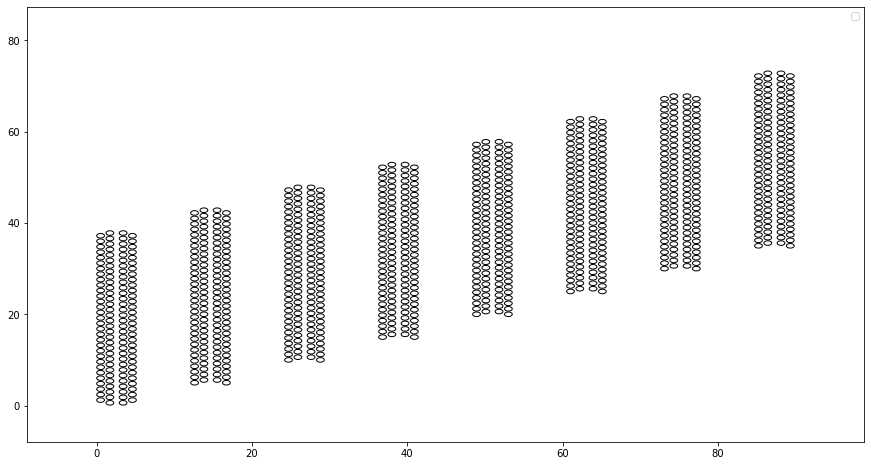

In [5]:
display_event(tracker)

## Generate fake tracks

In [6]:
def simulate_straight_track(intercept, slope, detector):
    """
    Simulate detector data for one straight track.
    Parameters:
        slope: track slope parameter [cm/cm]
        intercept: track intercept parameter [cm]
        detector: A Detector_Geometry that holds the straw positions
    Returns:
        straw_hits: ndarray of hit straws for one straight track
    """
    straw_hits= np.zeros((detector.n_layers,detector.n_straws))
    for ilayer,straw_x in enumerate(detector.x):
        for istraw,straw_y in enumerate(detector.y[ilayer]):
            if (straw_x==0) or (straw_y==0): continue
            ## check each straw to see if it is hit by the track
            track_y = intercept + slope*straw_x
            ## this only identifies a track if it intersects the straw at x=straw_x, which may miss some hits.
            ## instead for full accuracy should consider something like:
            ## sqrt( (track_x-straw_x)**2 + (track_y-straw_y)**2 )<straw_radius,
            ## where track_x, track_y are given by a function.
            ## that would require a function minimization, see eg: 
            ## https://stackoverflow.com/questions/18965195/find-minimum-and-maximum-values-of-a-function
            if np.abs( track_y - straw_y )<detector.straw_radius:
                straw_hits[ilayer][istraw]=1
                break
    return straw_hits


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


No handles with labels found to put in legend.


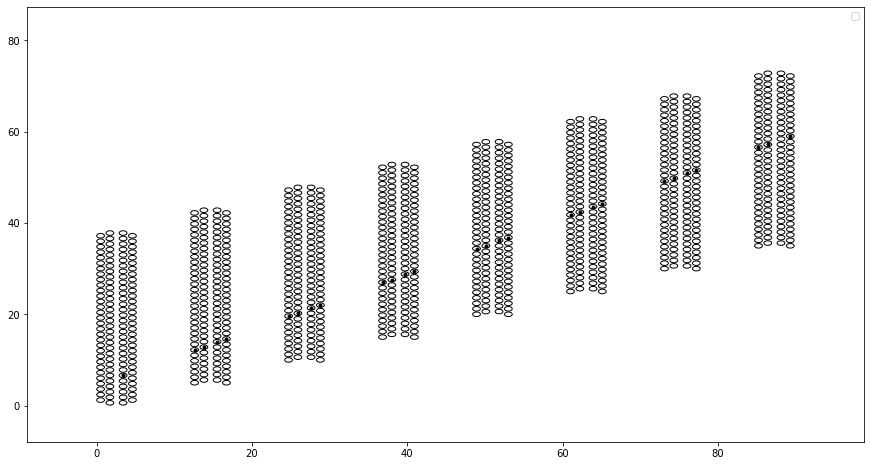

In [7]:
straw_hits = simulate_straight_track(5,0.6,tracker)
print(straw_hits)
display_event(tracker,straw_hits)

In [8]:
'''
Use this as generator 

# Generator for single track
def generate_track(batch_size=batch_size, det_shape=det_shape):
    """Arguments: 
         batch_size: number of events to yield for each call
       Yields: batches of training data for use with the keras fit_generator function
    """
    while True:
        # Entry and exit points are randomized
        bs = np.random.random_sample(size=batch_size)*det_width
        b2s = np.random.random_sample(size=batch_size)*det_width
        ms = (b2s-bs)/det_depth*slope_scale # scaled slope
        tracks = np.zeros((batch_size, 1, det_depth, det_width))
        targets = zip(bs, ms)
        for i, (b, m) in enumerate(targets):
            tracks[i,0] = simulate_straight_track(m/slope_scale, b, det_shape)
        targets = np.asarray(targets)
        yield tracks, targets
'''

'\nUse this as generator \n\n# Generator for single track\ndef generate_track(batch_size=batch_size, det_shape=det_shape):\n    """Arguments: \n         batch_size: number of events to yield for each call\n       Yields: batches of training data for use with the keras fit_generator function\n    """\n    while True:\n        # Entry and exit points are randomized\n        bs = np.random.random_sample(size=batch_size)*det_width\n        b2s = np.random.random_sample(size=batch_size)*det_width\n        ms = (b2s-bs)/det_depth*slope_scale # scaled slope\n        tracks = np.zeros((batch_size, 1, det_depth, det_width))\n        targets = zip(bs, ms)\n        for i, (b, m) in enumerate(targets):\n            tracks[i,0] = simulate_straight_track(m/slope_scale, b, det_shape)\n        targets = np.asarray(targets)\n        yield tracks, targets\n'

In [9]:
def simulate_window_tracks(ntracks, detector, single_track_simulator=simulate_straight_track):
    """
    Simulate detector data for one time window.
    Parameters:
        ntracks: Number of tracks to be generated within the window
        detector: A Detector_Geometry that holds the straw positions
        track_simulator: Function that simulates individual tracks
    Returns:
        straw_hits: ndarray of hit straws for all tracks
        track_ids: ndarray where each hit is assigned an id based on the track it belongs to
        
    *** To do:
        * add noise hits, based on some parameter in Detector
    """
    
    ## intercept, slope randomization range
    int_low,int_high=detector.y[0,0]-detector.width/10, detector.y[0,-1]+detector.width/10
    slope_high = 0.5* detector.width/detector.length
    slope_low = -slope_high
    
    straw_hits= np.zeros((detector.n_layers,detector.n_straws))
    track_ids= np.zeros((detector.n_layers,detector.n_straws))

    itrack=0
    for i in range(ntracks):
        intercept=np.random.uniform(int_low,int_high)
        slope=np.random.uniform(slope_low,slope_high)
        
        straw_hits_track = simulate_straight_track(intercept,slope,detector)
        straw_hits[straw_hits_track>0]=1
        if np.sum(straw_hits_track)>3:
            itrack+=1
            track_ids[straw_hits_track>0]=int(itrack)
        else:
            track_ids[straw_hits_track>0]=-1
    return straw_hits, track_ids
        

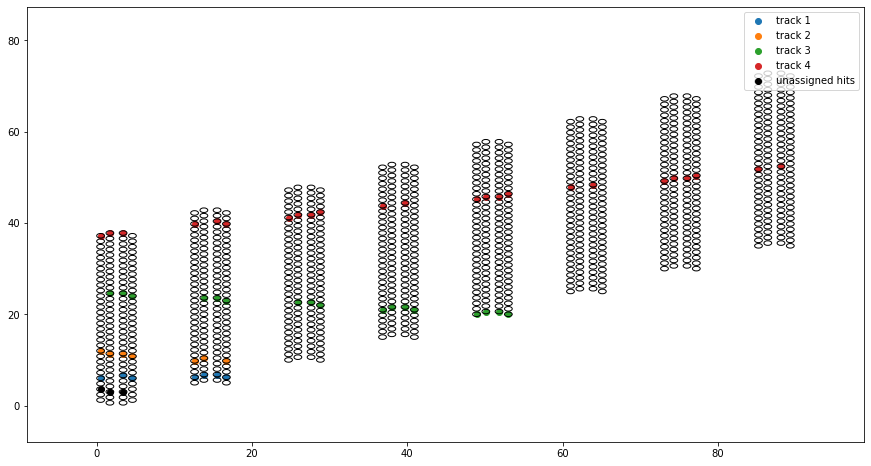

In [10]:
straw_hits, track_ids=simulate_window_tracks(5,tracker)
display_event(tracker,straw_hits,track_ids)

In [11]:
def make_seeds(ids):
    """
    Generate seeds.
    Seeds are defined for now as: at least 3 hits on the first 4 layers (1st module) from the same track.
    Parameters:
        ids: 2D array of track ids within a window
        #detector: The Detector_Geometry geometry object holds the straw positions and occupancy characteristics
    Returns:
        A 2D array (same dimension as ids, for simplicity) with seeds in first two layers.
    """
    
    seeds=np.zeros_like(ids)
    ntracks=int(np.max(ids))
    for i_track in range(1,ntracks+1):
        nHits_inFirstModule=0
        for i_layer in range(4):
            if (i_track in ids[i_layer,:]):
                nHits_inFirstModule+=1
        if (nHits_inFirstModule>=3):
            ## this track has >=3 hits in the first 4 layers, forming a seed
            ix,iy=np.where(ids==i_track)
            for i_layer in range(4):
                if len(iy[ix==i_layer])>0:
                    seeds[i_layer][iy[ix==i_layer][0]]=int(i_track)
    
    return seeds


In [12]:
def make_seeds_anywhere(ids):
    """
    Generate seeds -- anywhere in the detector.
    Seeds are defined as: at least 3 hits in any module (set of 4 layers) from the same track.
    Parameters:
        ids: 2D array of track ids within a window
        #detector: The Detector_Geometry geometry object holds the straw positions and occupancy characteristics
    Returns:
        A 2D array (same dimension as ids, for simplicity) with seeds_ids.
        
    """

    ## For now assume as hard-coded (this can be easily amended by passing the detector)
    n_modules=8 ## number of modules, each with 4 layers of straws
    n_layersPerModule=4
    
    seeds=np.zeros_like(ids)
    tracks = [i for i in np.unique( ids[np.where(ids>0)] ) if i>0]
    ntracks=len(tracks)
    
    for i_track in tracks:
        track_x,track_y=np.where(ids==i_track)
        
        ## iterate in all modules, see in which this track leaves a seed        
        for i_module in range(n_modules):
            mask = (track_x>=n_layersPerModule*i_module) & (track_x<n_layersPerModule*i_module+n_layersPerModule)
            ix,iy= track_x[mask], track_y[mask]
            if len(ix)>=3:
                ## more than 3 hits in this module from this track, make seed
                seeds[ix,iy]=i_track
    
    return seeds



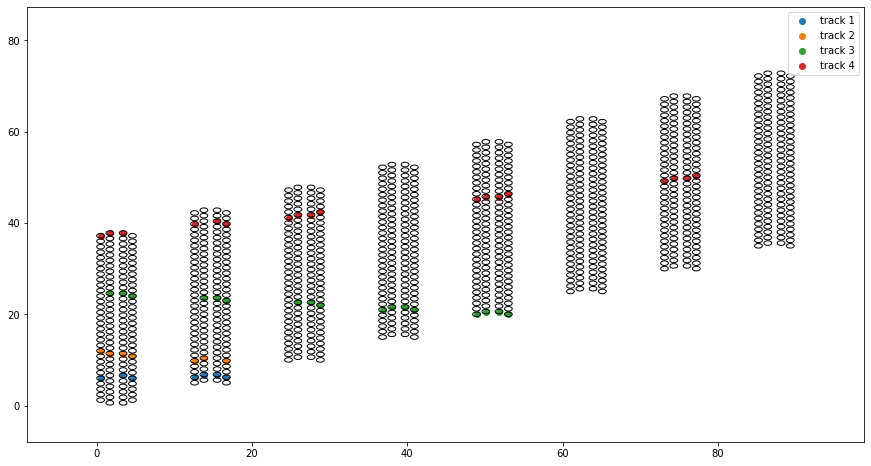

In [13]:
seeds=make_seeds_anywhere(track_ids)
display_event(tracker,track_ids=seeds)

## Create many windows/events

We need many events for training and testing.
Create many windows, with random number of tracks in each.

In [14]:
def simulate_events(n_evts, detector):
    """
    Simulate event windows.
    Parameters:
        n_evts: Number of events to simulate
        detector: The Detector_Geometry geometry object holds the straw positions and occupancy characteristics
    Returns:
        A series of straw_hits, track_ids (these are the per-event arrays):
        events_hits: [n_evts, (det_shape)] array of hit straws for all tracks in each event
        events_ids: track_ids, same shape as events_hits
    """
    
    evts_hits,evts_ids=[],[]

    for i_evt in range(n_evts):
        
        ## randomize number of tracks in this event
        ntracks=min( detector.max_tracks, np.random.poisson(detector.avg_tracks) )
        
        hits,ids=simulate_window_tracks(ntracks, detector)
        if np.sum(hits)>0:## extremely unlikely but possible
            evts_hits+=[hits]
            evts_ids+=[ids]
        
    return np.array(evts_hits), np.array(evts_ids)



In [15]:
n_training_events=10000

In [16]:
evts_hits, evts_ids = simulate_events(n_training_events,tracker)

In [17]:
evts_ids.shape

(8408, 32, 32)

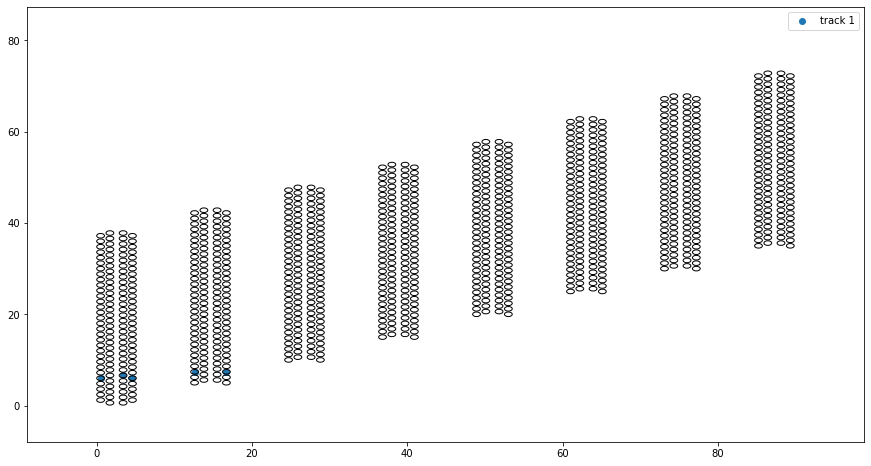

In [18]:
i_evt=1
display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])

## Format data exactly as in HEPTrkX

In [19]:
import keras
import pandas as pd

In [20]:
from sklearn.base import BaseEstimator
class Clusterer(BaseEstimator):
    def __init__(self, hidden_dim=50,
                 batch_size=128, n_epochs=5, val_frac=0.1, detector=tracker):
        """
        LSTM model example.
        TODO: fill in more details.
        """
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.n_epochs = n_epochs
        self.val_frac = val_frac
        self.detector=detector
        
        self.model=None

        self.train_input = None
        self.train_target = None
        self.prepared = False

        

    def build_model(self, 
                    loss='binary_crossentropy',## the HEPTrkX code was using categorical_ce
                    optimizer='Nadam', metrics=['accuracy']):
        n_hidden=self.hidden_dim
        length=self.detector.n_layers
        width=self.detector.n_straws 
        ## flatten the hits/seeds for each straw into a single dimension of 2*width elements
        inputs = keras.layers.Input(shape=(length, 2*width))
        ##bi-directional LSTM layer:
        hidden_1 = keras.layers.Bidirectional(keras.layers.LSTM(n_hidden, return_sequences=True))(inputs)
        ## could try adding more LSTM layers, with dropout inbetween to prevent overfitting
        dropout_1 = keras.layers.Dropout(0.2)(hidden_1)
        hidden_2 = keras.layers.Bidirectional(keras.layers.LSTM(n_hidden, return_sequences=True))(dropout_1)
        dropout_2 = keras.layers.Dropout(0.2)(hidden_2)
        outputs = keras.layers.TimeDistributed( keras.layers.Dense(width, activation='softmax'))(dropout_2)
        self.model = keras.Model(inputs, outputs)
        self.model.compile(loss=loss, optimizer=optimizer, metrics=metrics)            
          
    '''
    Can we make loss function give bigger weight to events with many hits?
    That would train the model to deal with complexity.
    
    Also consider "momentum acceleration" or other modifications of learning rate for better convergence.
    '''

        
    def prepare_training_data(self, evts_hits, evts_ids):
        """
        Prepare training data. 
        Reads in 3D arrays of hits and ids in many event windows.
        The 1st dimension is the event number.
        The hits and ids within each window  are of the same shape: (length,width).
        Within each window generate seeds.
        *** In this iteration, seeds are genrated anywhere in the tracker, and multiple per track ***
        Training input and target are prepared in the same way as the HEPTrkX example.
        The input will be of shape (n_seeds, length, width)
        """
        if self.prepared: return
        self.prepared = True
        
        n_events = evts_hits.shape[0]
        n_seeds = 0 # this will be a counter for seeds we find
        max_seeds = n_events * self.detector.max_tracks * self.detector.n_modules
        print_freq = int(max_seeds / 20)
        
        holder_input = np.zeros((max_seeds, 
                                 self.detector.n_layers, 
                                 2*self.detector.n_straws))
        holder_target = np.zeros((max_seeds, 
                                  self.detector.n_layers, 
                                  self.detector.n_straws))
    
        ## Iterate over all windows (events)
        for i_evt in range(n_events):

            ## All hits coordinates in this event
            allhits_layers,allhits_straws=np.where(evts_hits[i_evt]>0)

            ## Get all seeds in this event
            seeds=make_seeds_anywhere(evts_ids[i_evt])
        
            ## Step through each module
            for i_module in range(self.detector.n_modules):
                ## Get seeds in this module
                seed_ids = [i for i in np.unique(seeds[i_module*4:i_module*4+4]) if i>0]
                #n_seeds_evt = len(seed_ids)
                
                for i_seed in seed_ids:
                    ## format input for this seed     
                                    
                    ## first turn on the seed hits after finding their (layer,straw) location
                    seed_layers,seed_straws = np.where(seeds[i_module*4:i_module*4+4]==i_seed)
                    for i,ilayer in enumerate(seed_layers):
                        istraw=seed_straws[i]
                        ## turn on both hits and seeds elements
                        holder_input[n_seeds][ilayer][istraw] = 1   
                        holder_input[n_seeds][ilayer][self.detector.n_straws+istraw] = 1   

                    ## now turn on all the hits from different modules in the event
                    not_module_mask = (allhits_layers<4*i_module) | (allhits_layers>=4*i_module+4)
                    ilayers,istraws=allhits_layers[not_module_mask], allhits_straws[not_module_mask] # this excludes hits from the same module as the seed 
                    for i,ilayer in enumerate(ilayers):
                        istraw=istraws[i]
                        holder_input[n_seeds][ilayer][istraw] = 1

                    ## now set the target as an image of all hits from the same track as the seed
                    ilayers,istraws=np.where((evts_ids[i_evt]==i_seed))
                    for i,ilayer in enumerate(ilayers):
                        istraw=istraws[i]
                        holder_target[n_seeds][ilayer][istraw] = 1

                    ## finished processing this seed, increment
                    n_seeds += 1
                    if (n_seeds % print_freq == 0):
                        print (' Processing seed #', n_seeds)

        print ('\nTotal seeds processed: ', n_seeds)
              
        ## Now remove all the extra array dimensions, keep only n_seeds
        self.train_input = holder_input[:n_seeds,:,:]
        self.train_target = holder_target[:n_seeds,:,:]
        

            
    def fit(self, evts_hits, evts_ids):
        #self.prepare_training_data_NoDF(evts_hits, evts_ids)
        self.prepare_training_data(evts_hits, evts_ids)
        print('Starting training...')
        self.history = self.model.fit(
            self.train_input, self.train_target,
            batch_size=self.batch_size, epochs=self.n_epochs,
            validation_split=self.val_frac)

      
    def prepare_event_for_prediction(self, evt_hits, evt_ids):
        """
        After the model has been trained, we will want to predict individual events.
        This function processes the 2D arrays of individual events in the proper format for model.predict().
        Reads in 2D arrays of hits and ids in the event, both of shape: (length,width).
        Find and generate seeds.
        *** In this iteration, seeds are genrated anywhere in the tracker, and multiple per track ***
        The input for prediction will be of shape (n_seeds, length, width)
        """
        
        ## All hits coordinates in this event
        allhits_layers,allhits_straws=np.where(evt_hits>0)

        ## First form seeds in the event
        seeds=make_seeds_anywhere(evt_ids)

        ## count seeds
        n_seeds=0   
        seed_ids={}
        ## Step through each module to count seeds
        for i_module in range(self.detector.n_modules):
            ## Get seeds in this module
            seed_ids[i_module] = [i for i in np.unique(seeds[i_module*4:i_module*4+4]) if i>0]
            n_seeds += len(seed_ids[i_module])
        print(' Found %d seeds in the event' % n_seeds)                    
        
        ## Input format
        model_input = np.zeros((n_seeds, 
                                self.detector.n_layers,  
                                2*self.detector.n_straws))

        input_seed=0 ## counter for seeds; must equal n_seeds eventually
        ## Step through each module to format input for each seed
        for i_module in range(self.detector.n_modules):
            for i_seed in seed_ids[i_module]:
                ## format input for this seed
                                
                ## first turn on the seed hits after finding their (layer,straw) location
                seed_layers,seed_straws = np.where(seeds[i_module*4:i_module*4+4]==i_seed)
                model_input[input_seed][4*i_module+seed_layers,seed_straws] = 1   
                model_input[input_seed][4*i_module+seed_layers,seed_straws+self.detector.n_straws] = 1   

                ## now turn on all the hits from different modules in the event
                # (exclude other hits from the same module as the seed)
                not_module_mask = (allhits_layers<4*i_module) | (allhits_layers>=4*i_module+4)
                ilayers,istraws=allhits_layers[not_module_mask], allhits_straws[not_module_mask] 
                model_input[input_seed][ilayers,istraws] = 1

                ## finished processing this seed, increment
                input_seed += 1
            
        print ('\nSeeds processed: ', input_seed)
        return model_input
    
        
    def cleanup_event_prediction(self, model_input, model_prediction):
        """
        Cleanup the model's prediction.
        Note that input and prediction are expected to be both for a single event, 
        potentially with many tracks and seeds.
        The first dimension is equal to the number of seeds in the event. 
        * Set all straws that weren't hit to 0
        * Check whether some seeds can be combined into a single track
        * Pass the combined seeds through a (new?) track search
        * Disambiguate straw hits that are assigned to multiple tracks
        * Round probabilistic track assignment to binary yes/no
        * Return the prediction for tracks in the event
        Note that the return prediction matrix will be of smaller dimension than the input
        """
        ## First set all straws that weren't hit to 0
        model_prediction[np.where((model_input[:,:,:self.detector.n_straws]==0))] = 0
                
        n_seeds=model_input.shape[0]
        if n_seeds<=1: # no disambiguation needed
            return model_prediction

        ## Disambiguate doubly assigned straw hits
        for i_seed in range(n_seeds):
            ## Here we should also assign input seeds definitely in output
            ## (though that ultimately depends on seed format)

            ## Check for ambiguities with all other tracks in event
            for i_seed_check in [x for x in range(n_seeds) if x!=i_seed]:
                ilayers,istraws = np.where((model_prediction_rounded[i_seed]>0) &
                                           (model_prediction_rounded[i_seed]== model_prediction_rounded[i_seed_check]))
                if len(ilayers)==0: continue
                for i,ilayer in enumerate(ilayers):
                    istraw=istraws[i]
                    if model_prediction[i_seed][ilayer][istraw]>model_prediction[i_seed_check][ilayer][istraw]:
                        model_prediction[i_seed_check][ilayer][istraw]=0
                    else:
                        model_prediction[i_seed][ilayer][istraw]=0
                
        model_prediction_rounded = np.around(model_prediction)        
        return model_prediction_rounded
                
        
        
    def predict_event_ids(self, evt_hits, evt_ids):
        """
        After the model has been trained, predict all tracks in a single event.
        This function returns a 2D array predicted_ids, in the same 2D format as evt_ids.
        Reads in 2D arrays of hits and ids in the event, both of shape: (length,width).
        """
        ## Prepare 2D output
        predicted_ids = np.zeros_like(evt_ids)

        ## First get seeds in the event
        seeds=make_seeds(evt_ids)
        seed_ids = np.unique([x for x in seeds[0] if x>0])
        n_seeds = len(seed_ids)
        if n_seeds==0: return predicted_ids
        
        ## Format model input for event
        model_input = self.prepare_event_for_prediction(evt_ids)

        ## Get model prediction
        model_prediction = self.model.predict(model_input)
        
        ## Cleanup the prediction
        model_prediction = self.cleanup_event_prediction(model_input, model_prediction)

        
        ##
        ##**** Here could have some disambiguation for doubly-assigend track ids*****
        ##
        
        for i_seed in range(n_seeds):
            seed=i_seed+1
            
            ilayers,istraws=np.where(model_prediction[i_seed]==1)
            for i,ilayer in enumerate(ilayers):
                istraw=istraws[i]
                predicted_ids[ilayer][istraw] = seed

        return predicted_ids
        

        
        
        
    def predict_ids(self, evts_hits, evts_ids):
        """
        After the model has been trained, predict all tracks in all events.
        Reads in 3D arrays of hits and ids in all events, both of shape: (n_evts,length,width).
        Returns a 3D array of predicted_ids, of same shape.
        """
        predicted_ids=np.zeros_like(evts_ids)
        n_evts=evts_ids.shape[0]        
        for i_evt in range(n_evts):
            evt_hits=evts_hits[i_evt]
            evt_ids=evts_ids[i_evt]
            predicted_ids[i_evt] = self.predict_event_ids(evt_hits,evt_ids)
        return predicted_ids
    
    
        
      
    def plot_event_and_NNoutput(self, evt_hits, evt_ids, figsize=(15,10)):
        """
        After the model has been trained, plot individual event and the NN output.
        Reads in 2D arrays of hits and ids in the event, both of shape: (length,width).
        Find and generate seeds.
        Prepare input for model prediction.
        Plot each seed input, and then details about the NN output (before any 2nd-step disambiguation).
        """
                         
        ## Get all seeds in the event
        seeds=make_seeds_anywhere(evt_ids)
        seed_ids={}
        n_seeds=0
        ## Step through each module to count seeds
        for i_module in range(self.detector.n_modules):
            ## Get seeds in this module
            seed_ids[i_module] = [i for i in np.unique(seeds[i_module*4:i_module*4+4]) if i>0]
            n_seeds += len(seed_ids[i_module])
        if n_seeds==0: return 1

        ## Format model input for event
        model_input = self.prepare_event_for_prediction(evt_hits,evt_ids)

        ## Get model prediction
        model_prediction = self.model.predict(model_input)
        model_prediction_rounded = np.around( model_prediction)

        
        ### Now plot input and prediction per seed
        
        full_detector_width = self.detector.width + self.detector.n_modules * self.detector.yOffset_PerModule
        
        ## put all straw locations in a df
        layer_v, straw_v, x_v, y_v =[],[],[],[]
        for ilayer in range(self.detector.n_layers):
            for istraw in range(self.detector.n_straws):
                layer_v+= [ilayer]
                straw_v+= [istraw]
                x_v+= [self.detector.x[ilayer] ]
                y_v+= [self.detector.y[ilayer][istraw] ]
        df = pd.DataFrame({'layer':layer_v, 'straw':straw_v, 'x':x_v, 'y':y_v})

        ## Step through each module to format input for each seed
        input_seed=0       
        for i_module in range(self.detector.n_modules):
            for i_seed in seed_ids[i_module]:
                                
                ## Make vectors with the model predictions at each straw for this seed,
                ## and add to the df.
                ## This is used for the color-coded plot of the model prediction, remove if no longer necessary
                ## (though it could also be useful for event-level analysis/disambiguation)
                prediction_v, prediction_rounded_v =[],[]
                for ilayer in range(self.detector.n_layers):
                    for istraw in range(self.detector.n_straws):
                        prediction_v+= [ model_prediction[input_seed][ilayer][istraw] ]
                        prediction_rounded_v+= [ model_prediction_rounded[input_seed][ilayer][istraw] ]
                df['prediction'] = prediction_v
                df['prediction_rounded'] = prediction_rounded_v


                fig, axs = plt.subplots(figsize=figsize)        
                ## First plot the model input
                axs.set_title('Seed#%d for track#%d in module#%d'%(input_seed, i_seed,i_module))

                axs.set_xlim((-0.1*self.detector.length, 1.1*self.detector.length))
                axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))

                # plot a circle at the location of each straw
                for ilayer,straw_x in enumerate(self.detector.x):
                    for straw_y in self.detector.y[ilayer]:
                        circle = plt.Circle((straw_x, straw_y), self.detector.straw_radius, color='black', fill=False)
                        axs.add_patch(circle)

                # plot the model input for this seed/event
                hits_x,hits_y=np.where(model_input[input_seed][:,:self.detector.n_straws]==1)
                axs.scatter(self.detector.x[hits_x],self.detector.y[hits_x,hits_y], marker='.', color='black')
                plt.show()

                ## Plot the raw NN output, which is a number that roughly translates 
                ## to the probability that each straw (even those that weren't hit)
                ## belongs to the same track as the seed
                fig, axs = plt.subplots(figsize=figsize)        
                axs.set_title('NN raw output')

                axs.set_xlim((-0.1*self.detector.length, 1.1*self.detector.length))
                axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
                # plot a circle at the location of each straw
                for ilayer,straw_x in enumerate(self.detector.x):
                    for straw_y in self.detector.y[ilayer]:
                        circle = plt.Circle((straw_x, straw_y), self.detector.straw_radius, color='black', fill=False)
                        axs.add_patch(circle)

                plt.scatter( df['x'], df['y'] , c=df['prediction'], 
                            cmap = 'RdPu', alpha =0.5) 
                plt.show()


                ## Plot the rounded NN output, before any cleanup/disambiguation
                fig, axs = plt.subplots(figsize=figsize)        
                axs.set_title('NN rounded output')

                axs.set_xlim((-0.1*self.detector.length, 1.1*self.detector.length))
                axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
                # plot a circle at the location of each straw
                for ilayer,straw_x in enumerate(self.detector.x):
                    for straw_y in self.detector.y[ilayer]:
                        circle = plt.Circle((straw_x, straw_y), self.detector.straw_radius, color='black', fill=False)
                        axs.add_patch(circle)
                hits_x,hits_y=np.where(model_prediction_rounded[input_seed]==1)
                axs.scatter(self.detector.x[hits_x],self.detector.y[hits_x,hits_y], marker='.', color='blue')
                plt.show()
                
                
                ### Plot the NN output values corresponding to the straws that belong to the track
                fig, axs = plt.subplots()        
                axs.set_title('NN output for straws that belong to the track')
                hits_x,hits_y=np.where(seeds==i_seed)
                axs.hist(model_prediction[input_seed][hits_x,hits_y])
                plt.show()
                
                
                ### Plot the NN output values corresponding to the straws that are predicted to belong to the track
                fig, axs = plt.subplots()        
                axs.set_title('NN output for straws that are predicted to belong to the track')
                hits_x,hits_y=np.where(model_prediction_rounded[input_seed]==1)
                axs.hist(model_prediction[input_seed][hits_x,hits_y])
                plt.show()
                
                
                ### Plot the NN output values corresponding to the straws that are predicted to belong to the track,
                ### but actually don't
                fig, axs = plt.subplots()        
                axs.set_title("NN output for straws that are predicted to belong to the track, but don't")
                badpred_x,badpred_y=[],[]
                for i,ix in enumerate(hits_x):
                    iy=hits_y[i]
                    if seeds[ix][iy]!=i_seed:
                        badpred_x+=[ix]
                        badpred_y+=[iy]                        
                axs.hist(model_prediction[input_seed][badpred_x,badpred_y])
                plt.show()
                
                input_seed+=1

        
    
    
        
      
    def plot_event_and_prediction(self, evt_hits, evt_ids, figsize=(15,10)):
        """
        After the model has been trained, plot individual event and its model prediction.
        Reads in 2D arrays of hits and ids in the event, both of shape: (length,width).
        Find and generate seeds.
        Prepare input for model prediction.
        Plot each seed input and model prediction.
        """
        
        ## First form seeds in the event
        seeds=make_seeds(evt_ids)
        seed_ids = np.unique([x for x in seeds[0] if x>0])
        n_seeds = len(seed_ids)
        if n_seeds==0: return 0
        
        ## Format model input for event
        model_input = self.prepare_event_for_prediction(evt_hits,evt_ids)

        ## Get model prediction
        model_prediction = np.around( self.model.predict(model_input) )
        model_prediction = self.cleanup_event_prediction(model_input, model_prediction)

        ### Now plot input and prediction per seed
        full_detector_width = self.detector.width + self.detector.n_modules * self.detector.yOffset_PerModule
        
        for i_seed in range(n_seeds):
            seed=seed_ids[i_seed]

            fig, axs = plt.subplots(1, 2, figsize=figsize)        
            ## First, plot the model input in the left subplot
            axs[0].set_title('Event seed #%d'%(i_seed+1))

            axs[0].set_xlim((-0.1*self.detector.length, 1.1*self.detector.length))
            axs[0].set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
             
            # plot a circle at the location of each straw
            for ilayer,straw_x in enumerate(self.detector.x):
                for straw_y in self.detector.y[ilayer]:
                    circle = plt.Circle((straw_x, straw_y), self.detector.straw_radius, color='black', fill=False)
                    axs[0].add_patch(circle)
    
            # plot the model input for this seed/event
            hits_x,hits_y=np.where(model_input[i_seed][:,:self.detector.n_straws]==1)
            axs[0].scatter(self.detector.x[hits_x],self.detector.y[hits_x,hits_y], marker='.', color='black',
                           label='Model input')
            
            
            ## Then on the right, plot the model prediction
            axs[1].set_title('Model prediction')

            axs[1].set_xlim((-0.1*self.detector.length, 1.1*self.detector.length))
            axs[1].set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
             
            # plot a circle at the location of each straw
            for ilayer,straw_x in enumerate(self.detector.x):
                for straw_y in self.detector.y[ilayer]:
                    circle = plt.Circle((straw_x, straw_y), self.detector.straw_radius, color='black', fill=False)
                    axs[1].add_patch(circle)
    
            # plot the model prediction for this seed/event
            hits_x,hits_y=np.where(model_prediction[i_seed]==1)
            axs[1].scatter(self.detector.x[hits_x],self.detector.y[hits_x,hits_y], marker='.', color='blue',
                           label='Model prediction')


        plt.legend(loc=1)
        plt.show()


        

In [44]:
'''
Alt CNN + LSTM model, from https://github.com/HEPTrkX/heptrkx-ctd/blob/master/param_estimation/param_estimation.ipynb
This is used for feature extraction, getting track parameters from each seeded track.

# Model
def build_model_1():
    """Test model.  Consists of several convolutional layers followed by dense layers and an LSTM"""
    input_layer = layers.Input(shape=(1, det_depth, det_width))
    layer = layers.Convolution2D(8, 3, 3, border_mode='same')(input_layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Convolution2D(8, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.MaxPooling2D(pool_size=(2,2))(layer)
    layer = layers.Convolution2D(32, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Convolution2D(32, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Flatten()(layer)
    layer = layers.Dense(400)(layer)
    layer = layers.RepeatVector(mean_tracks)(layer)
    layer = layers.LSTM(400, return_sequences=True)(layer)
    output_layer = layers.TimeDistributed(layers.Dense(2))(layer)
    model = models.Model(input=input_layer, output=output_layer)
    model.compile(loss='mean_squared_error', optimizer='Adam')
    return model
'''

'\nAlt CNN + LSTM model, from https://github.com/HEPTrkX/heptrkx-ctd/blob/master/param_estimation/param_estimation.ipynb\nThis is used for feature extraction, getting track parameters from each seeded track.\n\n# Model\ndef build_model_1():\n    """Test model.  Consists of several convolutional layers followed by dense layers and an LSTM"""\n    input_layer = layers.Input(shape=(1, det_depth, det_width))\n    layer = layers.Convolution2D(8, 3, 3, border_mode=\'same\')(input_layer)\n    layer = layers.Activation(\'relu\')(layer)\n    layer = layers.Convolution2D(8, 3, 3, border_mode=\'same\')(layer)\n    layer = layers.Activation(\'relu\')(layer)\n    layer = layers.MaxPooling2D(pool_size=(2,2))(layer)\n    layer = layers.Convolution2D(32, 3, 3, border_mode=\'same\')(layer)\n    layer = layers.Activation(\'relu\')(layer)\n    layer = layers.Convolution2D(32, 3, 3, border_mode=\'same\')(layer)\n    layer = layers.Activation(\'relu\')(layer)\n    layer = layers.Flatten()(layer)\n    layer

# Build the NN

In [21]:
tracker_NN=Clusterer(hidden_dim=100,
                     batch_size=128, 
                     n_epochs=15, val_frac=0.1, detector=tracker)
tracker_NN.build_model()

In [22]:
tracker_NN.model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 32, 64)]          0         
_________________________________________________________________
bidirectional (Bidirectional (None, 32, 200)           132000    
_________________________________________________________________
dropout (Dropout)            (None, 32, 200)           0         
_________________________________________________________________
bidirectional_1 (Bidirection (None, 32, 200)           240800    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32, 200)           0         
_________________________________________________________________
time_distributed (TimeDistri (None, 32, 32)            6432      
Total params: 379,232
Trainable params: 379,232
Non-trainable params: 0
_______________________________________________________

In [22]:
tracker_NN.fit(evts_hits, evts_ids)

 Processing seed # 134177
 Processing seed # 268354
 Processing seed # 402531
 Processing seed # 536708

Total seeds processed:  670452
Starting training...
Epoch 1/15
4715/4715 [==============================] - 898s 189ms/step - loss: 0.0361 - accuracy: 0.5115 - val_loss: 0.0188 - val_accuracy: 0.6061
Epoch 2/15
4715/4715 [==============================] - 47550s 10s/step - loss: 0.0190 - accuracy: 0.6036 - val_loss: 0.0167 - val_accuracy: 0.6187
Epoch 3/15
4715/4715 [==============================] - 829s 176ms/step - loss: 0.0174 - accuracy: 0.6125 - val_loss: 0.0162 - val_accuracy: 0.6270
Epoch 4/15
4715/4715 [==============================] - 876s 186ms/step - loss: 0.0167 - accuracy: 0.6179 - val_loss: 0.0157 - val_accuracy: 0.6318
Epoch 5/15
4715/4715 [==============================] - 882s 187ms/step - loss: 0.0162 - accuracy: 0.6223 - val_loss: 0.0155 - val_accuracy: 0.6376
Epoch 6/15
4715/4715 [==============================] - 904s 192ms/step - loss: 0.0158 - accuracy: 0.62

In [28]:
## Save trained model
tracker_NN.model.save('tracker_NN_model.h5')
'''
Then to load use:
# load model
model = load_model('tracker_NN_model.h5')
model.summary()
'''

"\nThen to load use:\n# load model\nmodel = load_model('tracker_NN_model.h5')\nmodel.summary()\n"

In [23]:
tracker_NN.model = keras.models.load_model('tracker_NN_model.h5')
tracker_NN.model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 32, 64)]          0         
_________________________________________________________________
bidirectional (Bidirectional (None, 32, 200)           132000    
_________________________________________________________________
dropout (Dropout)            (None, 32, 200)           0         
_________________________________________________________________
bidirectional_1 (Bidirection (None, 32, 200)           240800    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32, 200)           0         
_________________________________________________________________
time_distributed (TimeDistri (None, 32, 32)            6432      
Total params: 379,232
Trainable params: 379,232
Non-trainable params: 0
_______________________________________________________

In [24]:
def draw_train_history(history, draw_val=True, figsize=(12,5)):
    """Make plots of training and validation losses and accuracies"""
    plt.figure(figsize=figsize)
    # Plot loss
    plt.subplot(121)
    plt.plot(history.epoch, history.history['loss'], label='Training set')
    if draw_val:
        plt.plot(history.epoch, history.history['val_loss'], label='Validation set')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training loss')
    plt.legend()
    plt.subplot(122)
    plt.plot(history.epoch, history.history['accuracy'], label='Training set')
    if draw_val:
        plt.plot(history.epoch, history.history['val_accuracy'], label='Validation set')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim((0, 1))
    plt.title('Training accuracy')
    plt.legend(loc=0)
    plt.tight_layout()



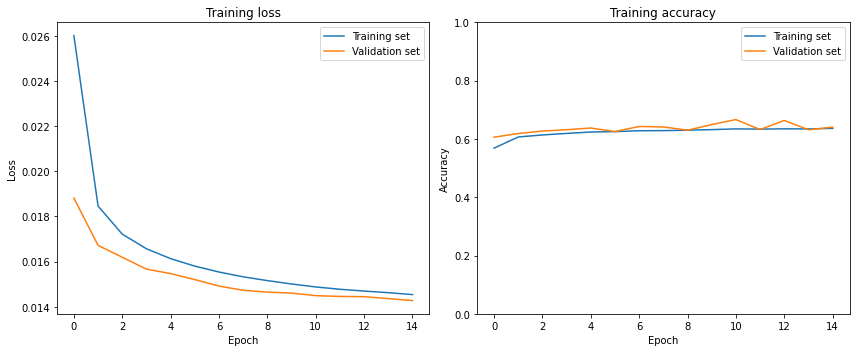

In [24]:
draw_train_history(tracker_NN.history)


### Examine output


 Event # 0


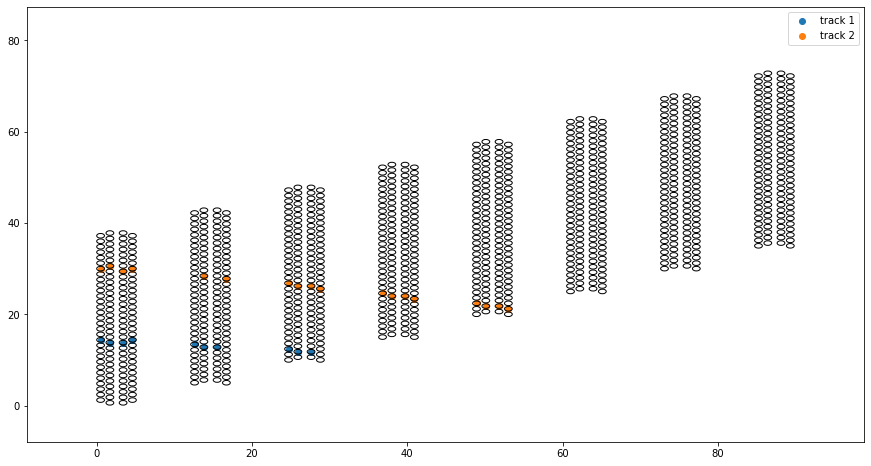

 Event # 1


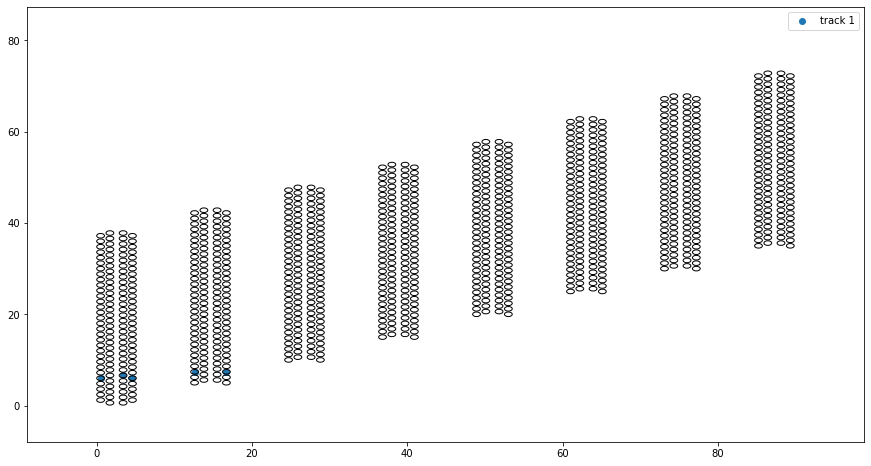

 Event # 2


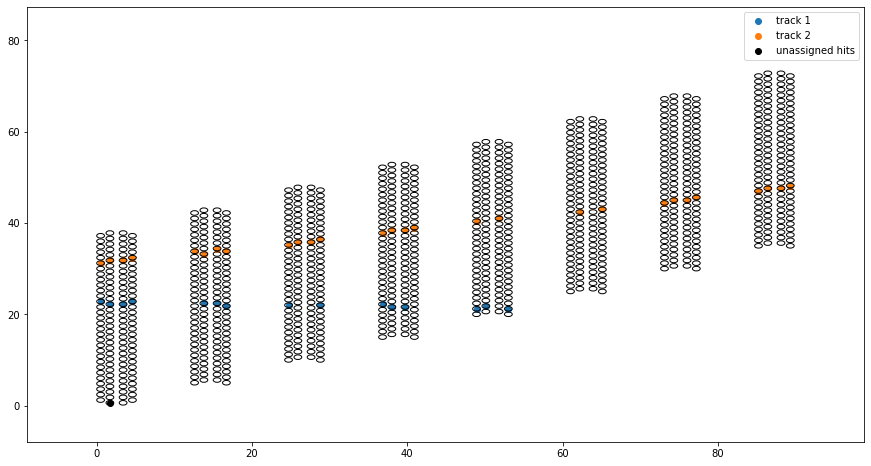

 Event # 3


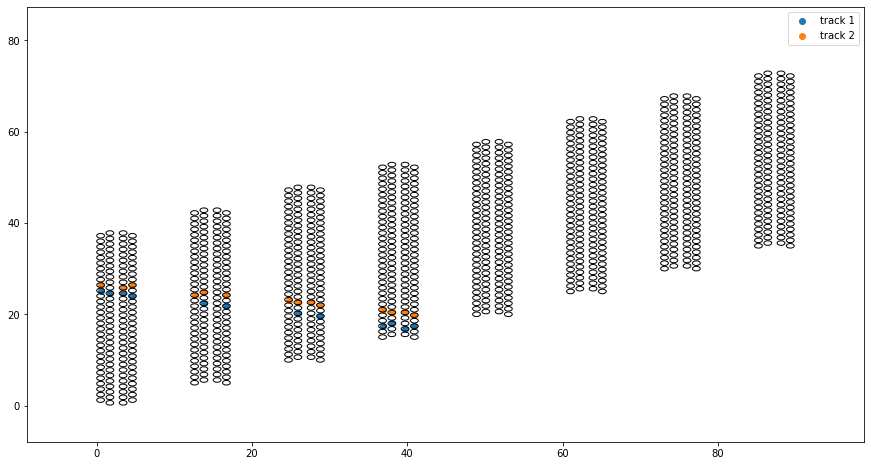

 Event # 4


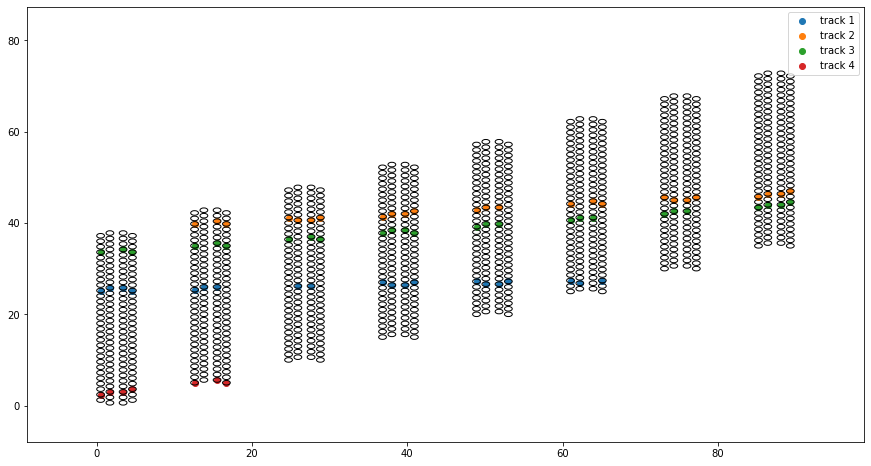

 Event # 5


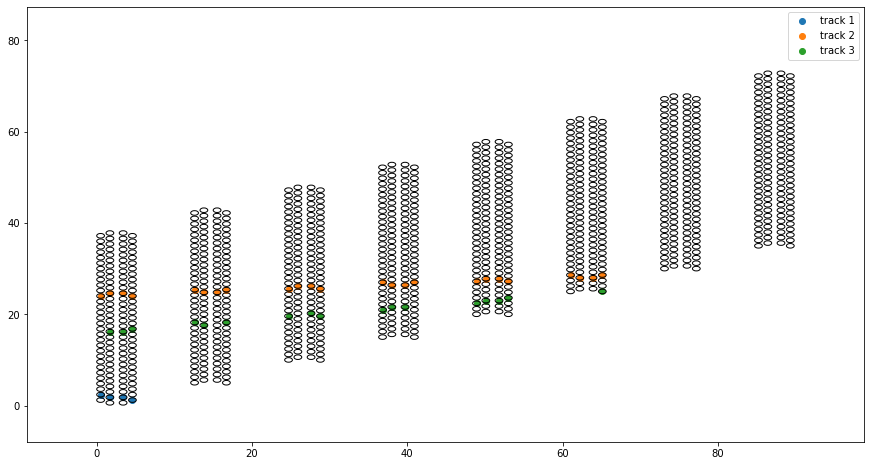

 Event # 6


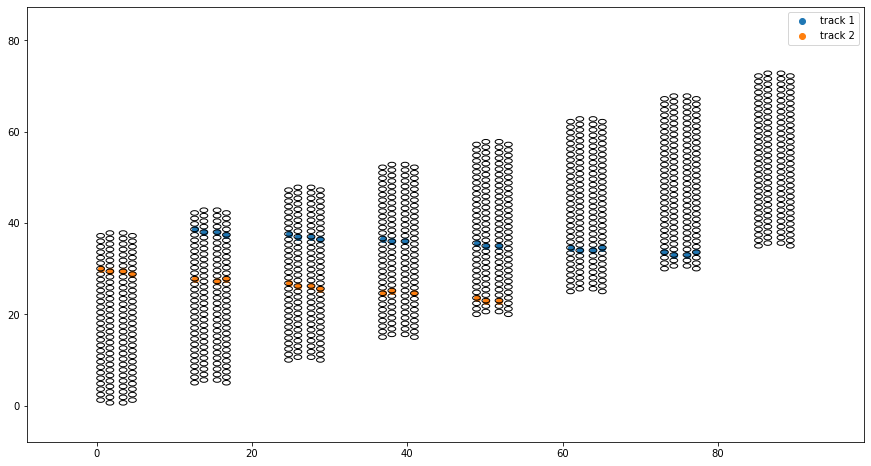

 Event # 7


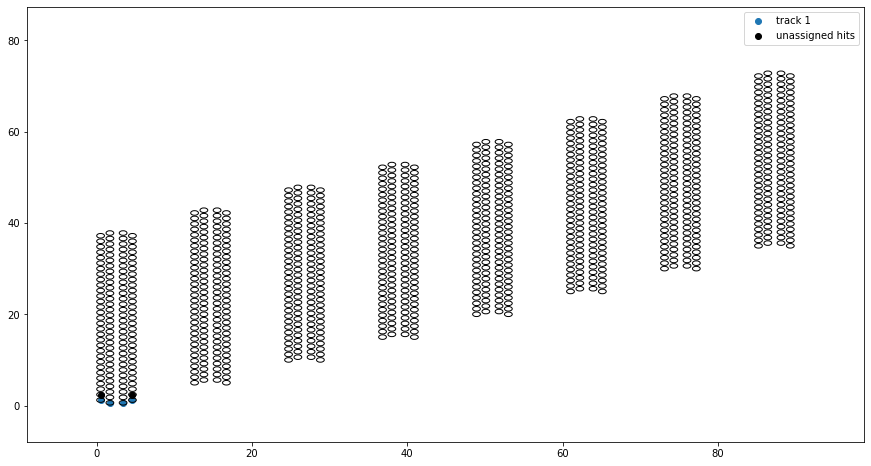

 Event # 8


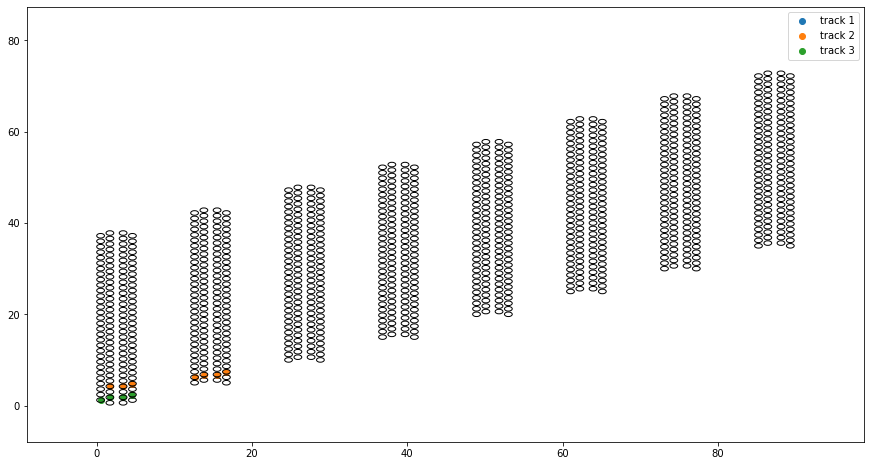

 Event # 9


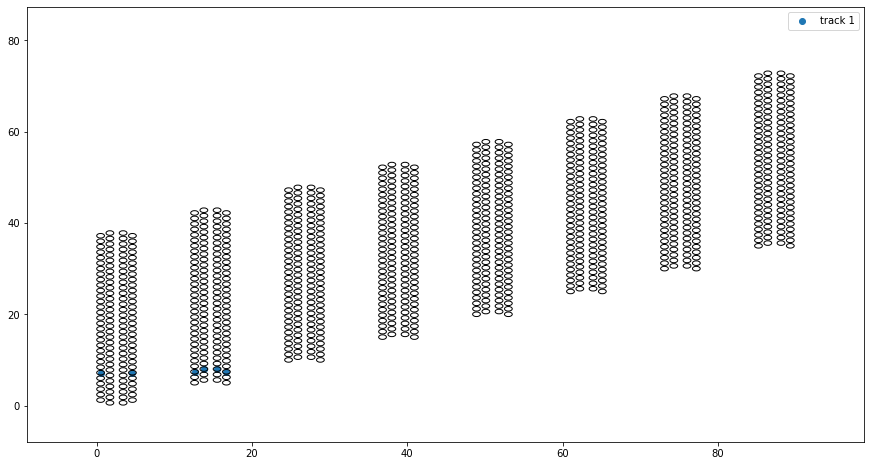

In [38]:
range_start=0
for i in range(range_start,range_start+10):
    print(' Event #', i)
    display_event(tracker, evts_hits[i], evts_ids[i])

In [104]:
## Event id that will be investigated in following cells
i_evt=3

No handles with labels found to put in legend.


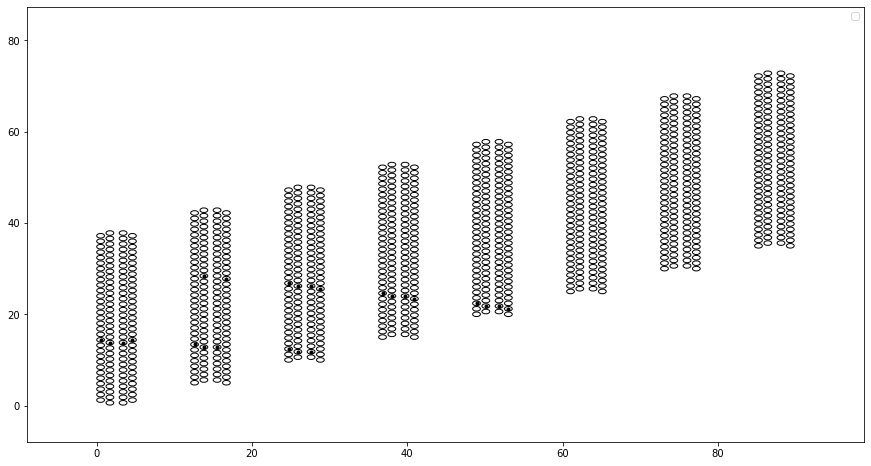

No handles with labels found to put in legend.


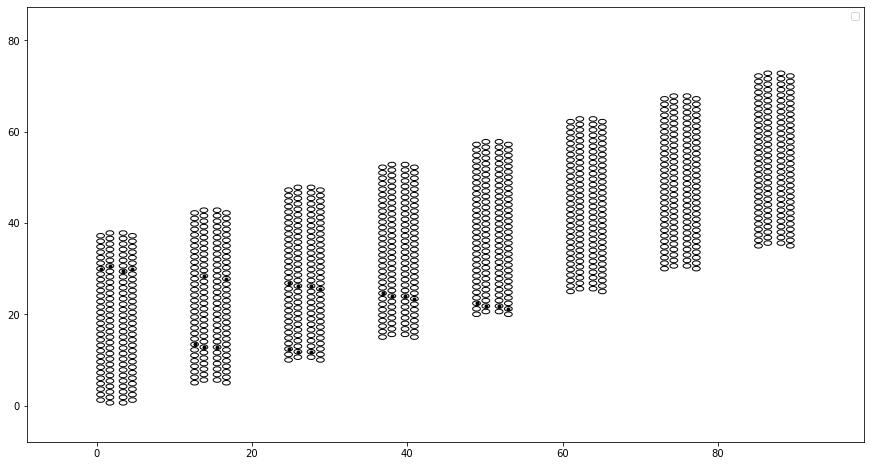

No handles with labels found to put in legend.


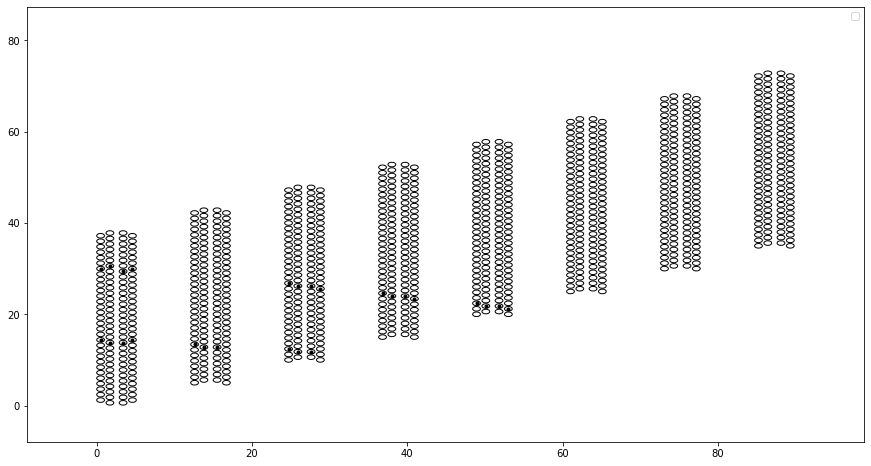

No handles with labels found to put in legend.


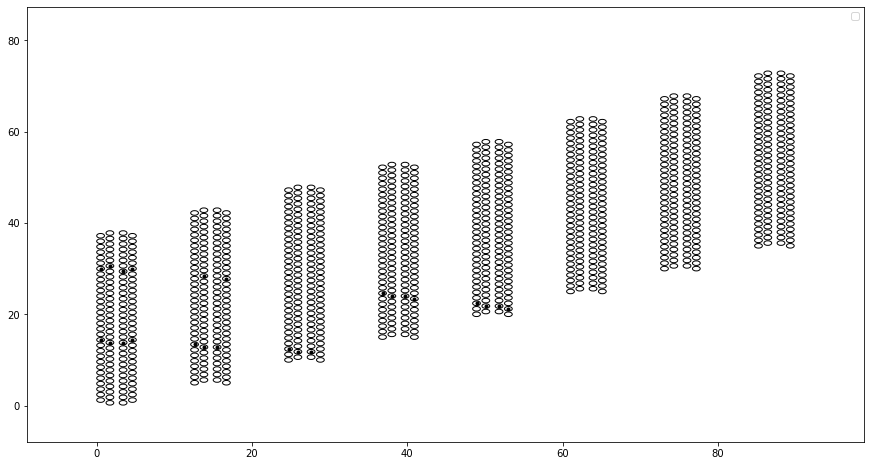

No handles with labels found to put in legend.


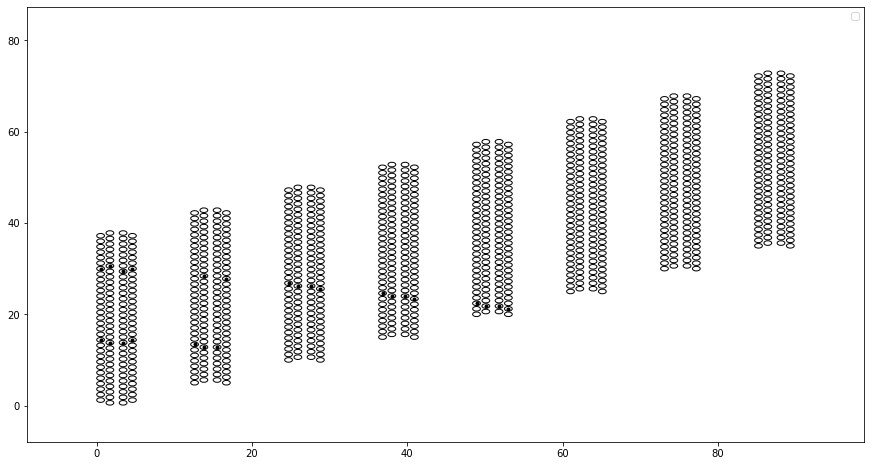

No handles with labels found to put in legend.


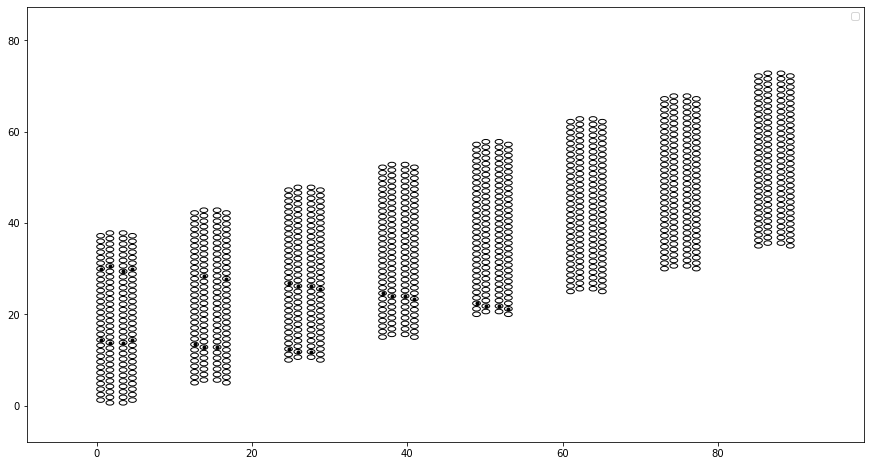

No handles with labels found to put in legend.


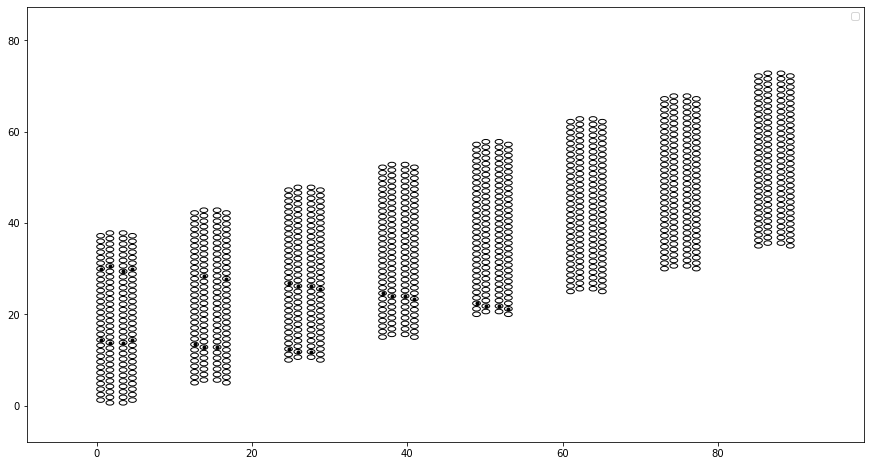

In [41]:
## All hits coordinates in this event
allhits_layers,allhits_straws=np.where(evts_hits[i_evt]>0)

## Get all seeds in this event
seeds=make_seeds_anywhere(evts_ids[i_evt])

## Step through each module
for i_module in range(tracker_NN.detector.n_modules):
    ## Get seeds in this module
    seed_ids = [i for i in np.unique(seeds[i_module*4:i_module*4+4]) if i>0]
    #n_seeds_evt = len(seed_ids)
    if len(seed_ids)==0: continue

    for i_seed in seed_ids:
        new_hits=np.zeros_like(evts_hits[i_evt])
        ## format input for this seed               

        ## first turn on the seed hits after finding their (layer,straw) location
        seed_layers,seed_straws = np.where(seeds[i_module*4:i_module*4+4]==i_seed)
        #for i,ilayer in enumerate(seed_layers):
        #istraw=seed_straws[i]
        new_hits[4*i_module+seed_layers,seed_straws] = 1   

        ## now turn on all the hits from different modules in the event
        not_module_mask = (allhits_layers<4*i_module) | (allhits_layers>=4*i_module+4)
        ilayers,istraws=allhits_layers[not_module_mask], allhits_straws[not_module_mask] # this excludes hits from the same module as the seed 
        #for i,ilayer in enumerate(ilayers):
        #istraw=istraws[i]
        new_hits[ilayers,istraws] = 1

        ## finished processing this seed
        display_event(tracker, straw_hits=new_hits)        

 Found 6 seeds in the event

Seeds processed:  6


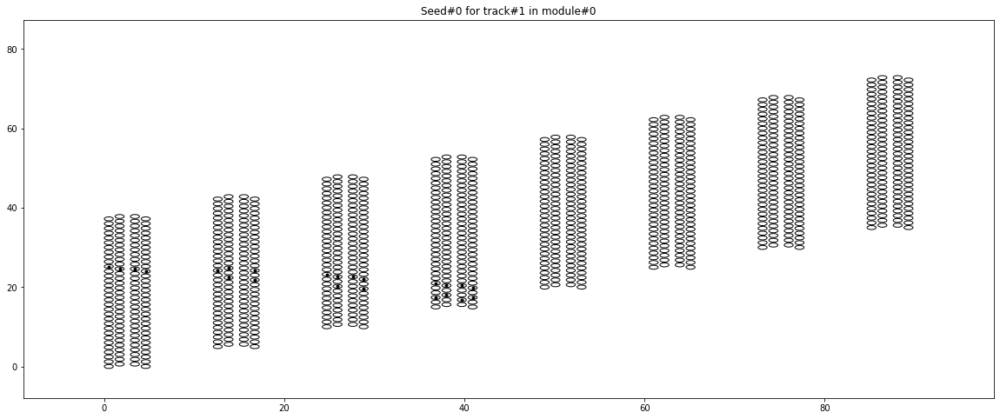

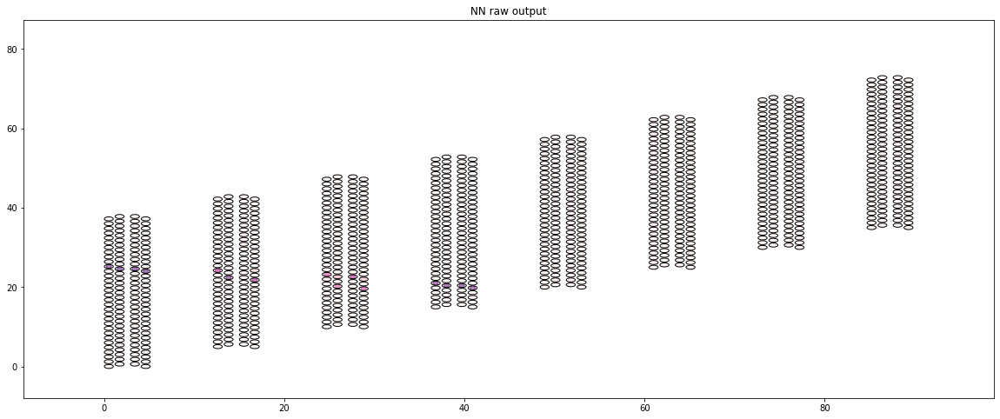

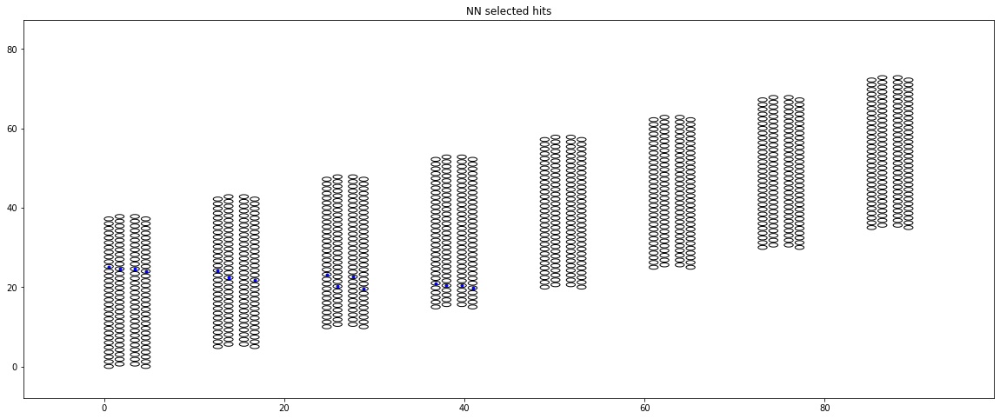

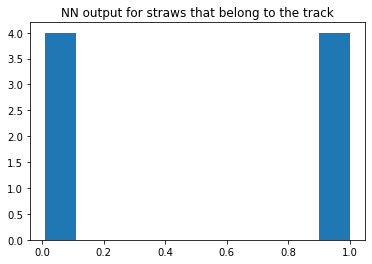

RMS = 0.4786


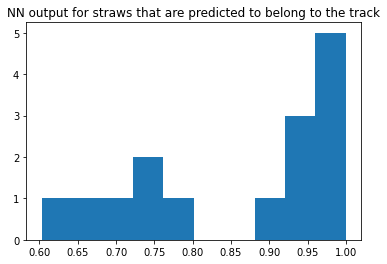

RMS = 0.1366


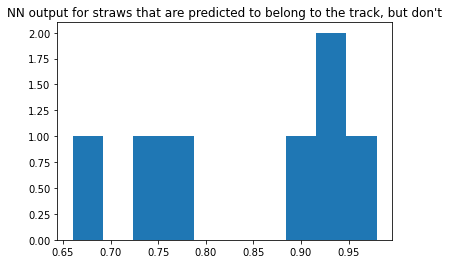

RMS = 0.1121


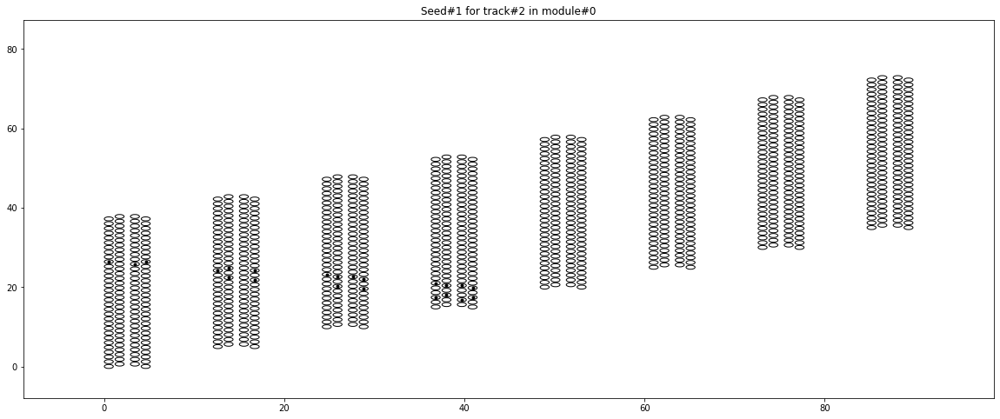

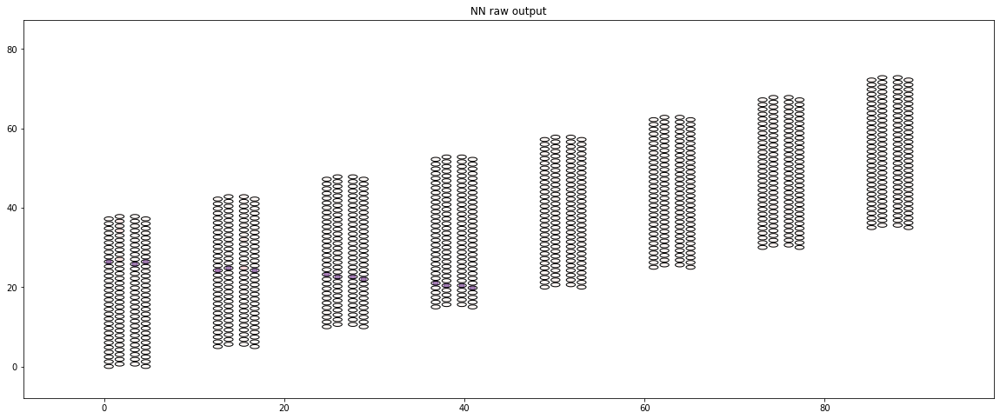

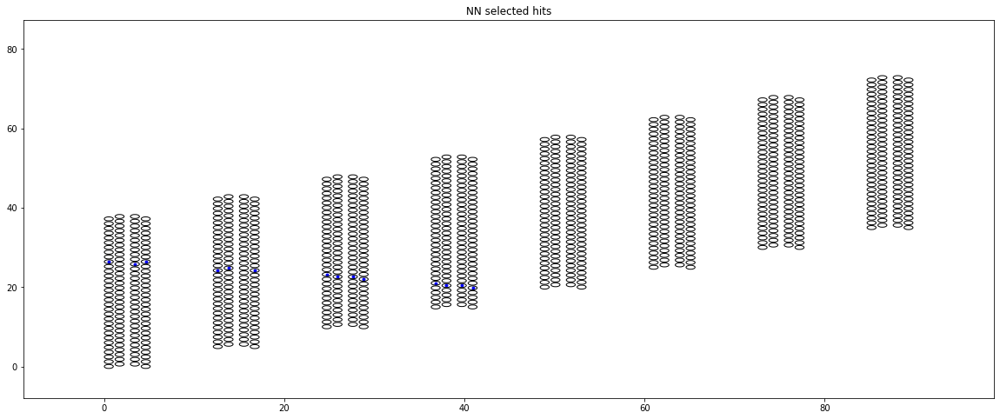

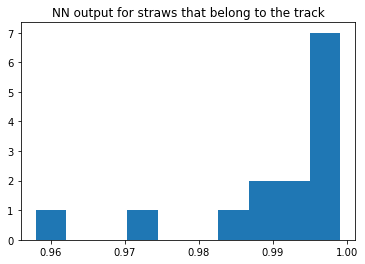

RMS = 0.0114


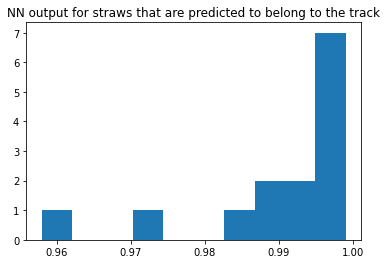

RMS = 0.0114


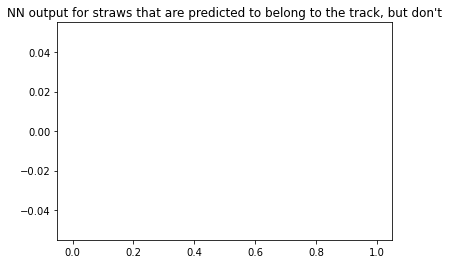

RMS = nan


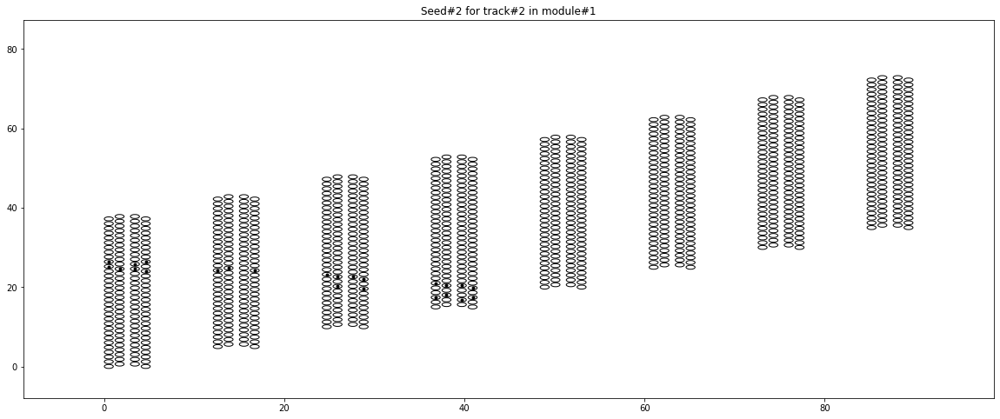

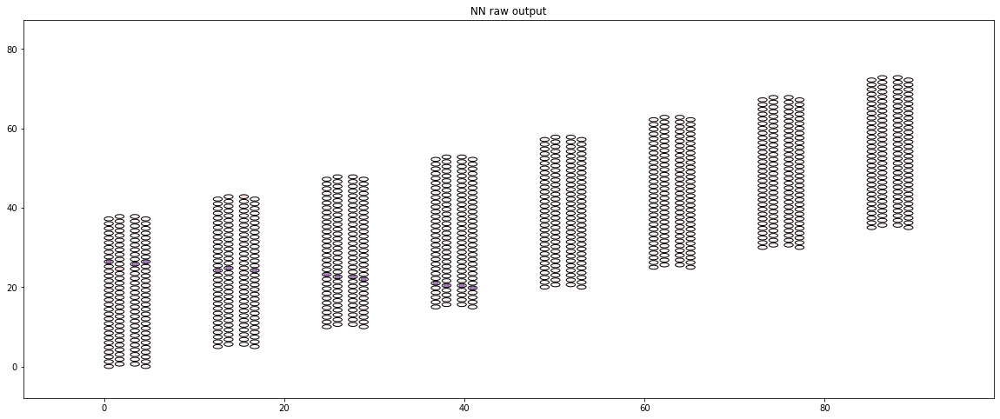

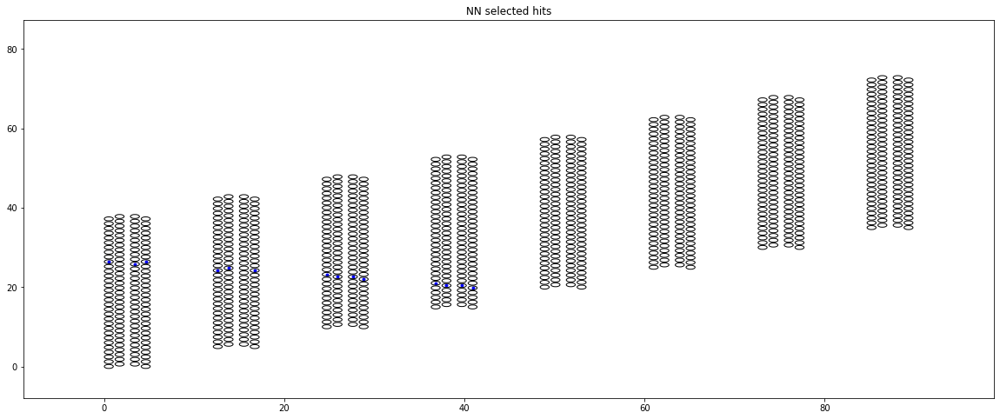

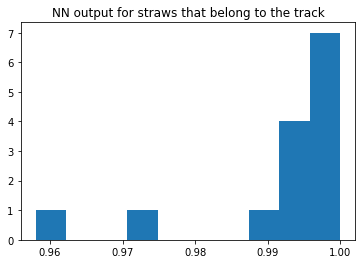

RMS = 0.0116


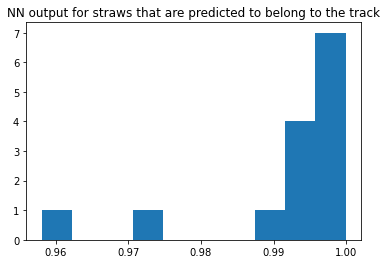

RMS = 0.0116


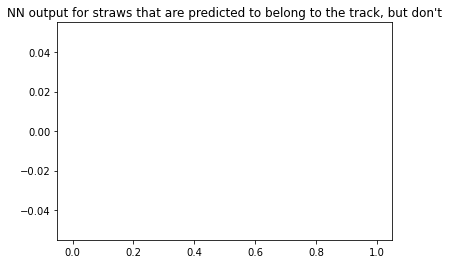

RMS = nan


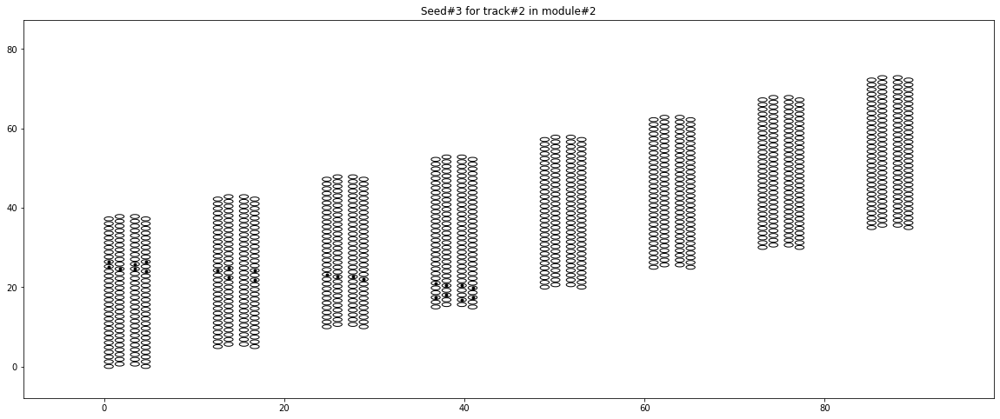

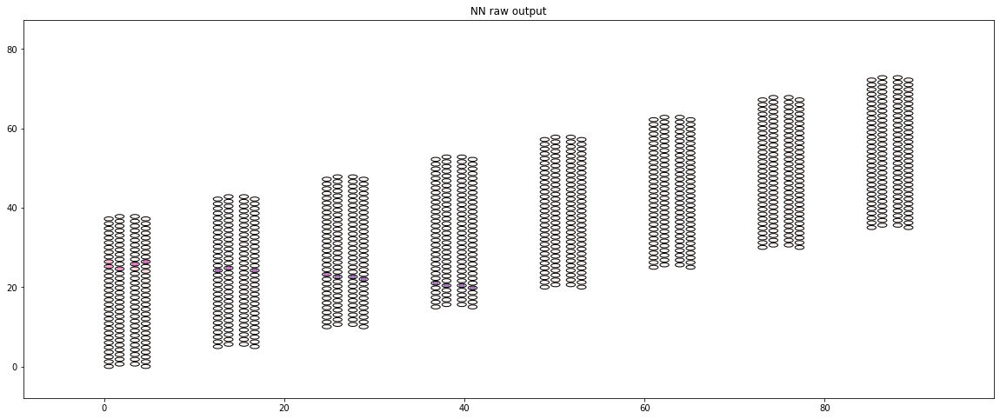

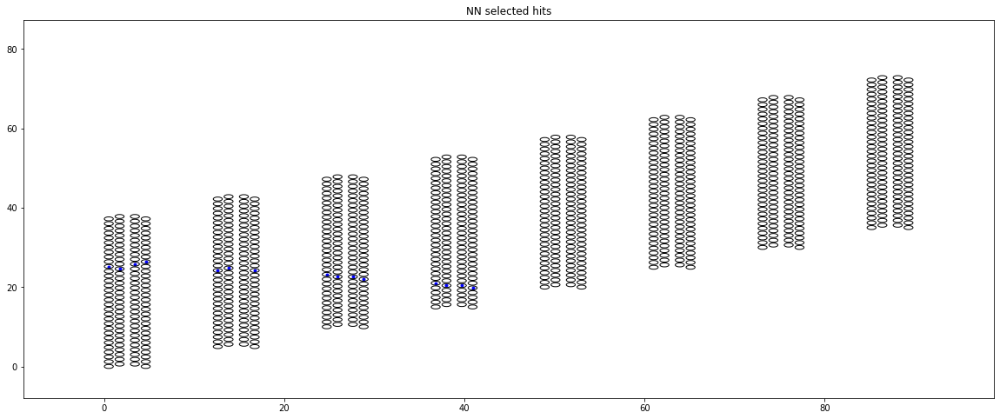

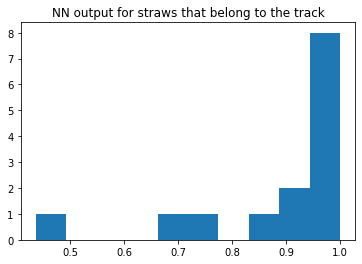

RMS = 0.1573


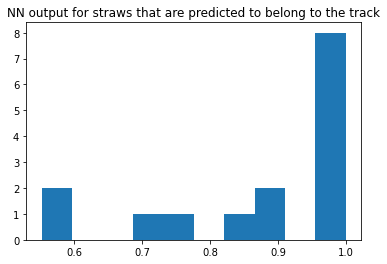

RMS = 0.1509


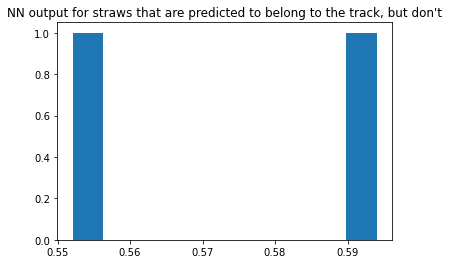

RMS = 0.0210


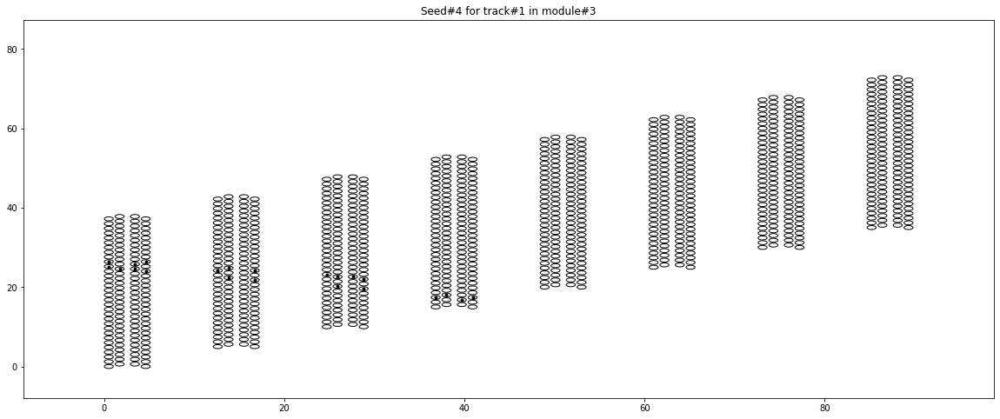

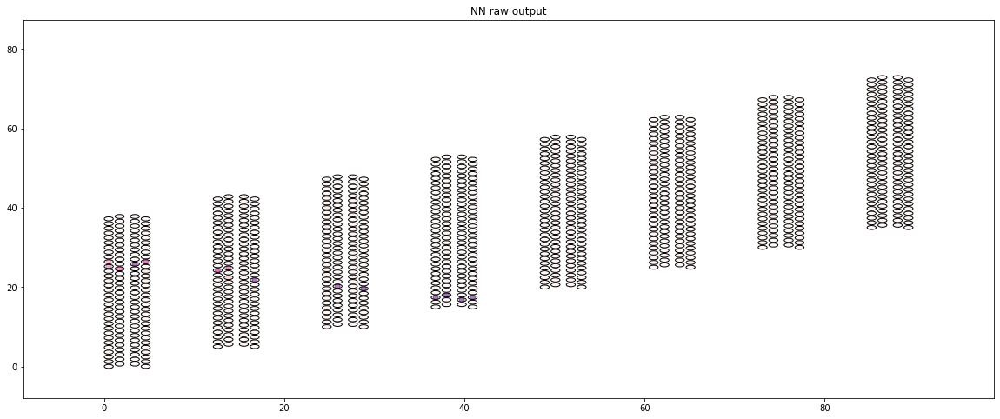

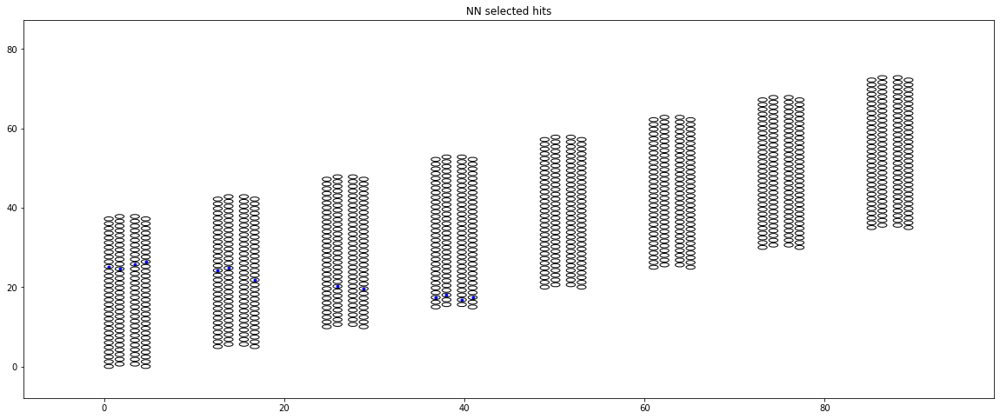

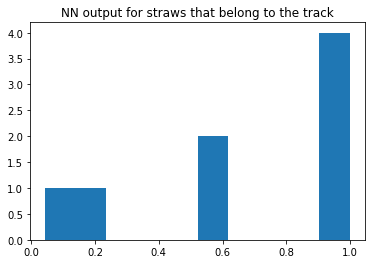

RMS = 0.3756


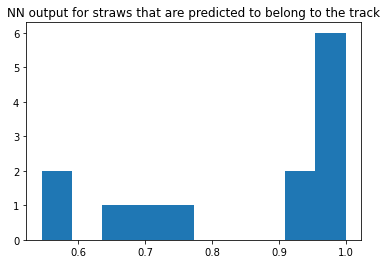

RMS = 0.1687


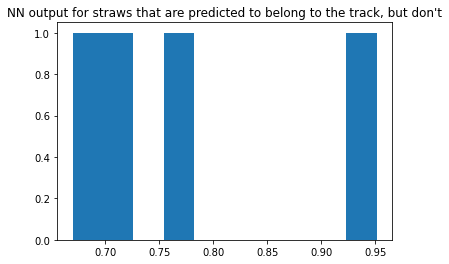

RMS = 0.1085


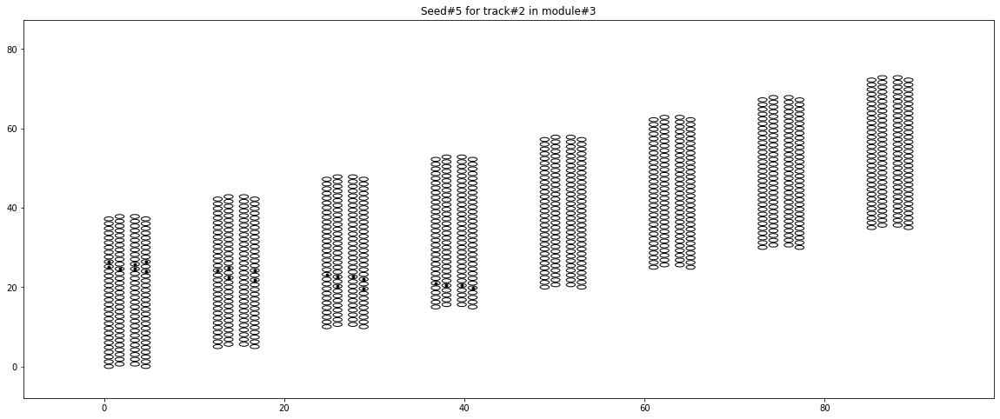

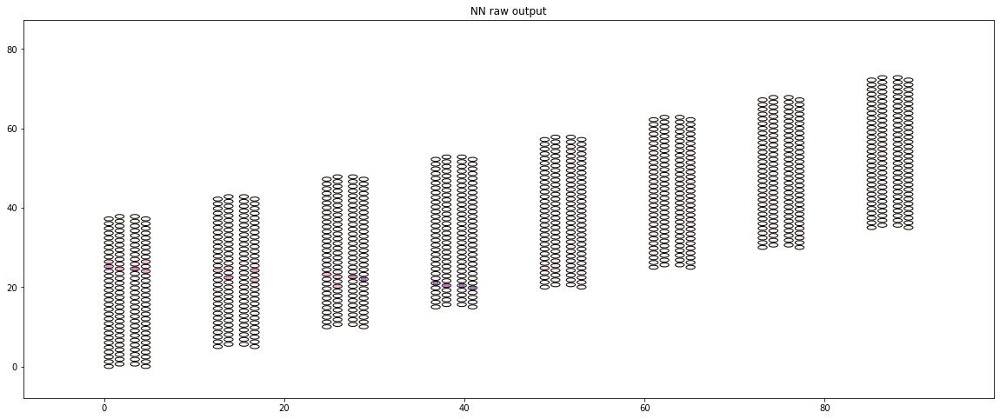

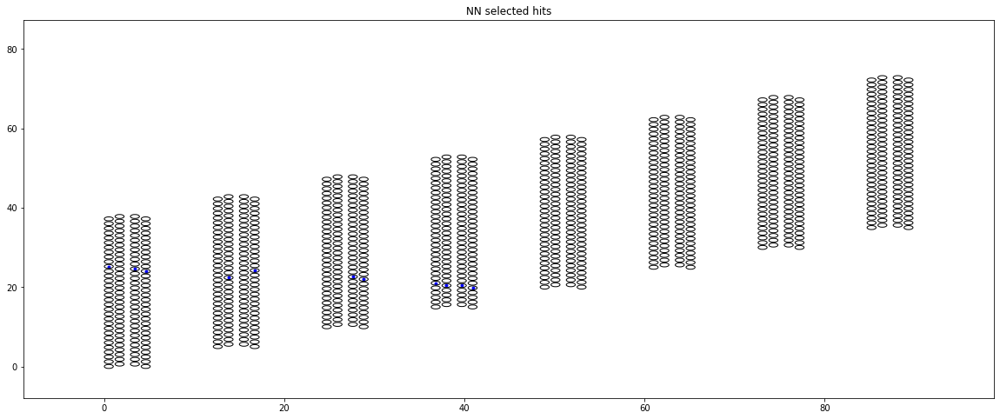

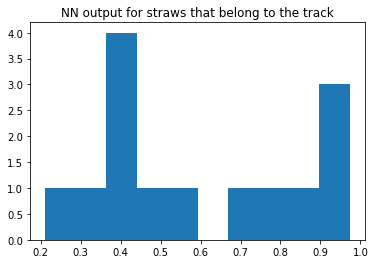

RMS = 0.2613


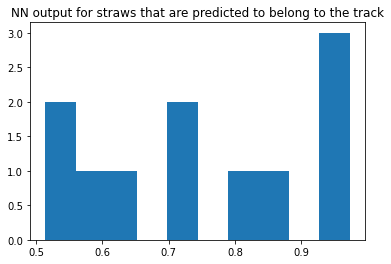

RMS = 0.1685


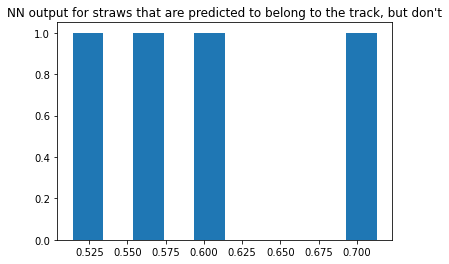

RMS = 0.0735


In [106]:
### Here we duplicate the functionality of predicting an event from the trained NN,
## but without editing the main class and therefore needing to retrain


## Get all seeds in the event
seeds=make_seeds_anywhere(evts_ids[i_evt])
seed_ids={}
n_seeds=0
## Step through each module to count seeds
for i_module in range(tracker_NN.detector.n_modules):
    ## Get seeds in this module
    seed_ids[i_module] = [i for i in np.unique(seeds[i_module*4:i_module*4+4]) if i>0]
    n_seeds += len(seed_ids[i_module])
if n_seeds==0: print('\n\n\nOops! Zero seeds\n\n\n\n\n')

## Format model input for event
model_input = tracker_NN.prepare_event_for_prediction(evts_hits[i_evt],evts_ids[i_evt])


## Get model prediction
model_prediction = tracker_NN.model.predict(model_input)
#model_prediction[np.where((model_input[:,:,:tracker_NN.detector.n_straws]==0))] = 0
selection_threshold=0.5
model_prediction_selected = np.zeros_like(model_prediction)
model_prediction_selected[np.where(model_prediction>selection_threshold)] = 1


### Now plot input and prediction per seed

full_detector_width = tracker_NN.detector.width + tracker_NN.detector.n_modules * tracker_NN.detector.yOffset_PerModule

## put all straw locations in a df
layer_v, straw_v, x_v, y_v =[],[],[],[]
for ilayer in range(tracker_NN.detector.n_layers):
    for istraw in range(tracker_NN.detector.n_straws):
        layer_v+= [ilayer]
        straw_v+= [istraw]
        x_v+= [tracker_NN.detector.x[ilayer] ]
        y_v+= [tracker_NN.detector.y[ilayer][istraw] ]
df = pd.DataFrame({'layer':layer_v, 'straw':straw_v, 'x':x_v, 'y':y_v})

## Step through each module to format input for each seed
input_seed=0       
for i_module in range(tracker_NN.detector.n_modules):
    for i_seed in seed_ids[i_module]:

        ## Make vectors with the model predictions at each straw for this seed,
        ## and add to the df.
        ## This is used for the color-coded plot of the model prediction, remove if no longer necessary
        ## (though it could also be useful for event-level analysis/disambiguation)
        prediction_v, prediction_selected_v =[],[]
        for ilayer in range(tracker_NN.detector.n_layers):
            for istraw in range(tracker_NN.detector.n_straws):
                prediction_v+= [ model_prediction[input_seed][ilayer][istraw] ]
                prediction_selected_v+= [ model_prediction_selected[input_seed][ilayer][istraw] ]
        df['prediction'] = prediction_v
        df['prediction_selected'] = prediction_selected_v


        fig, axs = plt.subplots(figsize=(20,8))        
        ## First plot the model input
        axs.set_title('Seed#%d for track#%d in module#%d'%(input_seed, i_seed,i_module))

        axs.set_xlim((-0.1*tracker_NN.detector.length, 1.1*tracker_NN.detector.length))
        axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))

        # plot a circle at the location of each straw
        for ilayer,straw_x in enumerate(tracker_NN.detector.x):
            for straw_y in tracker_NN.detector.y[ilayer]:
                circle = plt.Circle((straw_x, straw_y), tracker_NN.detector.straw_radius, color='black', fill=False)
                axs.add_patch(circle)

        # plot the model input for this seed/event
        hits_x,hits_y=np.where(model_input[input_seed][:,:tracker_NN.detector.n_straws]==1)
        axs.scatter(tracker_NN.detector.x[hits_x],tracker_NN.detector.y[hits_x,hits_y], marker='.', color='black')
        plt.show()

        ## Plot the raw NN output, which is a number that roughly translates 
        ## to the probability that each straw (even those that weren't hit)
        ## belongs to the same track as the seed
        fig, axs = plt.subplots(figsize=(20,8))        
        axs.set_title('NN raw output')

        axs.set_xlim((-0.1*tracker_NN.detector.length, 1.1*tracker_NN.detector.length))
        axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
        # plot a circle at the location of each straw
        for ilayer,straw_x in enumerate(tracker_NN.detector.x):
            for straw_y in tracker_NN.detector.y[ilayer]:
                circle = plt.Circle((straw_x, straw_y), tracker_NN.detector.straw_radius, color='black', fill=False)
                axs.add_patch(circle)

        plt.scatter( df['x'], df['y'] , c=df['prediction'], 
                    cmap = 'RdPu', alpha =0.5) 
        plt.show()


        ## Plot the rounded NN output, before any cleanup/disambiguation
        fig, axs = plt.subplots(figsize=(20,8))       
        axs.set_title('NN selected hits')

        axs.set_xlim((-0.1*tracker_NN.detector.length, 1.1*tracker_NN.detector.length))
        axs.set_ylim((-0.1*full_detector_width, 1.1*full_detector_width))
        # plot a circle at the location of each straw
        for ilayer,straw_x in enumerate(tracker_NN.detector.x):
            for straw_y in tracker_NN.detector.y[ilayer]:
                circle = plt.Circle((straw_x, straw_y), tracker_NN.detector.straw_radius, color='black', fill=False)
                axs.add_patch(circle)
        hits_x,hits_y=np.where(model_prediction_selected[input_seed]==1)
        axs.scatter(tracker_NN.detector.x[hits_x],tracker_NN.detector.y[hits_x,hits_y], marker='.', color='blue')
        plt.show()


        ### Plot the NN output values corresponding to the straws that belong to the track
        fig, axs = plt.subplots()    
        axs.set_title('NN output for straws that belong to the track')
        hits_x,hits_y=np.where(seeds==i_seed)
        axs.hist(model_prediction[input_seed][hits_x,hits_y])
        plt.show()
        print ('RMS = %.4f' % np.std(model_prediction[input_seed][hits_x,hits_y]))


        ### Plot the NN output values corresponding to the straws that are predicted to belong to the track
        fig, axs = plt.subplots()      
        axs.set_title('NN output for straws that are predicted to belong to the track')
        hits_x,hits_y=np.where(model_prediction_selected[input_seed]==1)
        axs.hist(model_prediction[input_seed][hits_x,hits_y])
        plt.show()
        print ('RMS = %.4f' % np.std(model_prediction[input_seed][hits_x,hits_y]))


        ### Plot the NN output values corresponding to the straws that are predicted to belong to the track,
        ### but actually don't
        fig, axs = plt.subplots()        
        axs.set_title("NN output for straws that are predicted to belong to the track, but don't")
        badpred_x,badpred_y=[],[]
        for i,ix in enumerate(hits_x):
            iy=hits_y[i]
            if evts_ids[i_evt][ix][iy]!=i_seed:
                badpred_x+=[ix]
                badpred_y+=[iy]                        
        axs.hist(model_prediction[input_seed][badpred_x,badpred_y])
        plt.show()
        print ('RMS = %.4f' % np.std(model_prediction[input_seed][badpred_x,badpred_y]))

        input_seed+=1

    





In [136]:
### Identify "golden" seeds that give great track candidates.
### Assume that all their hits are correct, therefore:
### * merge their seeds with other seeds that were included in the golden track hits
### * remove golden track hits from other seeds input


def merge_golden_seeds(model_input, #model_prediction=np.array(0),
                       removed_seed_ids=[], good_track_ids=[], 
                       selection_threshold=0.5):    

    print('removed_seed_ids : ', removed_seed_ids)
    print('good_track_ids : ', good_track_ids)
    
    n_seeds=model_input.shape[0]
    if n_seeds<=1: # no disambiguation needed
        print('\nOnly %d seeds in model input\n' % n_seeds)
        return model_input, np.nan, np.nan
    ## assign an ID to each seed, so that we can combine and delete them
    seed_ids=np.arange(n_seeds)
        
    ## Get model prediction
    #if model_prediction.size<=1:
    model_prediction = tracker_NN.model.predict(model_input)
    ## First set all straws that weren't hit to 0
    model_prediction[np.where((model_input[:,:,:tracker_NN.detector.n_straws]==0))] = 0
    model_prediction_selected = np.zeros_like(model_prediction)
    model_prediction_selected[np.where(model_prediction>selection_threshold)] = 1
    
    ## go through all seeds, search for "golden" tracks
    for seed_id in seed_ids:
        if seed_id in removed_seed_ids: continue
        print('processing seed id #', seed_id)

        layers,straws=np.where(model_input[seed_id]==1)
        seed_layers=layers[straws>=tracker_NN.detector.n_straws]
        seed_straws=straws[straws>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws
        predicted_layers,predicted_straws=np.where(model_prediction_selected[seed_id]==1)
        n_predicted_hits = len(predicted_layers)
        if n_predicted_hits<6: continue ## too few hits id'ed; if persists in later pass just remove seed

        prediction_min = min(    model_prediction[seed_id][predicted_layers,predicted_straws] )
        prediction_rms = np.std( model_prediction[seed_id][predicted_layers,predicted_straws] )
        nhits_track    = np.sum( model_prediction_selected[seed_id][predicted_layers,predicted_straws] )

        print('min prediction = ', prediction_min)
        print('rms prediction = ', prediction_rms)
        print('nhits_track = ', nhits_track)

        if (prediction_min>0.98) & (prediction_rms<0.005) & (nhits_track>=6):
            ## Very good track, likely with all predicted hits correct
            print('Accepting GOLDEN track with seed id #%d\n'%seed_id)
            good_track_ids += [seed_id]

            ## Now step through all other seeds, search for ones that belong to the same track
            for seed_id2 in seed_ids:
                if seed_id2 == seed_id: continue
                if seed_id2 in removed_seed_ids: continue

                layers2,straws2=np.where(model_input[seed_id2]==1)
                seed_layers2=layers2[straws2>=tracker_NN.detector.n_straws]
                seed_straws2=straws2[straws2>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws

                ## number of seed hits of seed_id2 that were selected in seed_id
                n_seed_same = np.sum( model_prediction_selected[seed_id][seed_layers2,seed_straws2] )
                ## number and fraction of common selected hits overall
                n_hits_same = np.sum( model_prediction_selected[seed_id2][predicted_layers,predicted_straws] )
                frac_hits_same = n_hits_same / n_predicted_hits

                print('Cross-checking with seed #',seed_id2)
                print('%d same seed hits '%n_seed_same)
                print('%d same hits overall '%n_hits_same)
                print('%dpc fractional same hits '%(100*frac_hits_same))

                if (n_seed_same>=2) & (n_hits_same>=6):
                    ## Since the original seed is high purity, assume that this seed is part of the same track.
                    ## Remove this seed_id2 from further consideration, and add its seed hits to seed_id
                    print('Merging seed#%d into seed#%d'%(seed_id2,seed_id))
                    removed_seed_ids += [seed_id2]
                    model_input[seed_id][seed_layers2,seed_straws2] = 1



            ## We assume that all its predicted hits are correct here, and remove them from all other inputs
            for seed_id2 in seed_ids:
                if seed_id2 == seed_id: continue
                if seed_id2 in removed_seed_ids: continue
                model_input[seed_id2][predicted_layers,predicted_straws] = 0

            print(' Good track identified:: ')
            display_event(tracker, straw_hits=model_prediction_selected[seed_id])        


    return model_input, removed_seed_ids, good_track_ids




In [137]:
### Identify "silver" seeds that give good track candidates, but don't assume that all their hits are correct.
### * merge with other seeds that have enough shared hits
### * remove the most reliable silver hits from other seeds input 
###   ** (provided they don't also have high output in other seeds)


def merge_silver_seeds(model_input, #model_prediction=np.array(0),
                       removed_seed_ids=[], good_track_ids=[], 
                       selection_threshold=0.5):    

    print('removed_seed_ids : ', removed_seed_ids)
    print('good_track_ids : ', good_track_ids)
    
    n_seeds=model_input.shape[0]
    if n_seeds<=1: # no disambiguation needed
        print('\nOnly %d seeds in model input\n' % n_seeds)
        return model_input, np.nan, np.nan
    ## assign an ID to each seed, so that we can combine and delete them
    seed_ids=np.arange(n_seeds)
        
    ## Get model prediction
    ## *** we probably don't need to predict every time, if nothing is changed since last prediction
    #if model_prediction.size<=1:
    model_prediction = tracker_NN.model.predict(model_input)
    ## First set all straws that weren't hit to 0
    model_prediction[np.where((model_input[:,:,:tracker_NN.detector.n_straws]==0))] = 0
    model_prediction_selected = np.zeros_like(model_prediction)
    model_prediction_selected[np.where(model_prediction>selection_threshold)] = 1
    
    ## go through all seeds, search for "silver" quality
    for seed_id in seed_ids:
        if seed_id in removed_seed_ids: continue
        print('processing seed id #', seed_id)

        layers,straws=np.where(model_input[seed_id]==1)
        seed_layers=layers[straws>=tracker_NN.detector.n_straws]
        seed_straws=straws[straws>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws
        predicted_layers,predicted_straws=np.where(model_prediction_selected[seed_id]==1)
        n_predicted_hits = len(predicted_layers)
        if n_predicted_hits<6: continue ## too few hits id'ed; if persists in later pass just remove seed

        prediction_min = min(    model_prediction[seed_id][predicted_layers,predicted_straws] )
        prediction_rms = np.std( model_prediction[seed_id][predicted_layers,predicted_straws] )
        nhits_track    = np.sum( model_prediction_selected[seed_id][predicted_layers,predicted_straws] )

        print('min prediction = ', prediction_min)
        print('rms prediction = ', prediction_rms)
        print('nhits_track = ', nhits_track)

        if (prediction_min>0.9):# & (prediction_rms<0.005) & (nhits_track>=6):
            ## Good track, but still some ambiguity
            ## don't assume that all its hits are necessarily correct
            print('Accepting SILVER track with seed id #%d\n'%seed_id)
            good_track_ids += [seed_id]
            

            ## Now step through all other seeds, search for ones that belong to the same track
            merged_seeds=[seed_id]
            for seed_id2 in seed_ids:
                if ((seed_id2 in good_track_ids) 
                    or (seed_id2 in removed_seed_ids) ): continue

                layers2,straws2=np.where(model_input[seed_id2]==1)
                seed_layers2=layers2[straws2>=tracker_NN.detector.n_straws]
                seed_straws2=straws2[straws2>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws

                ## number of seed hits of seed_id2 that were selected in seed_id
                n_seed_same = np.sum( model_prediction_selected[seed_id][seed_layers2,seed_straws2] )
                ## number and fraction of common selected hits overall
                n_hits_same = np.sum( model_prediction_selected[seed_id2][predicted_layers,predicted_straws] )
                frac_hits_same = n_hits_same / n_predicted_hits

                print('Cross-checking with seed #',seed_id2)
                print('%d same seed hits '%n_seed_same)
                print('%d same hits overall '%n_hits_same)
                print('%dpc fractional same hits '%(100*frac_hits_same))

                if (n_seed_same>=2) & (n_hits_same>=6):
                    ## Since the original seed is of good quality, we assume that this seed is part of the same track.
                    ## Remove this seed_id2 from further consideration.
                    ## We still don't assume that all its hits are correctly assigned
                    print('Merging seed#%d into seed#%d'%(seed_id2,seed_id))
                    merged_seeds += [seed_id2]
                    removed_seed_ids += [seed_id2]
                    model_input[seed_id][seed_layers2,seed_straws2] = 1



            ## Find the highest quality hits among the merged seeds
            for i,ilayer in enumerate(predicted_layers):
                istraw = predicted_straws[i]
                ## this hit is high-quality if its output is high enough among all merged seeds
                high_threshold=0.98
                if np.all(model_prediction[merged_seeds, ilayer, istraw]>high_threshold):
                    print('Good hit at (%d,%d)' % (ilayer,istraw))
                    ## Set it to 0 at other inputs, except if other seeds have selected it with high output also
                    for seed_id2 in seed_ids:
                        if ((seed_id2 in good_track_ids) 
                            or (seed_id2 in removed_seed_ids) ): continue
                        if model_prediction[seed_id2][ilayer][istraw]<high_threshold:
                            model_prediction[seed_id2][ilayer][istraw] = 0

            print(' Good track identified:: ')
            display_event(tracker, straw_hits=model_prediction_selected[seed_id])        


    return model_input, removed_seed_ids, good_track_ids





In [138]:
### Disambiguate hits that are selected by multiple tracks


def disambiguate_hits(model_input, #model_prediction=np.array(0),
                      removed_seed_ids=[], good_track_ids=[], 
                      selection_threshold=0.5):    

    print('removed_seed_ids : ', removed_seed_ids)
    print('good_track_ids : ', good_track_ids)
    
    n_seeds=model_input.shape[0]
    if n_seeds<=1: # no disambiguation needed
        print('\nOnly %d seeds in model input\n' % n_seeds)
        return model_input, np.nan, np.nan
    ## assign an ID to each seed, so that we can combine and delete them
    seed_ids=np.arange(n_seeds)
        
    ## Get model prediction
    ## *** we probably don't need to predict every time, if nothing is changed since last prediction
    #if model_prediction.size<=1:
    model_prediction = tracker_NN.model.predict(model_input)
    ## First set all straws that weren't hit to 0
    model_prediction[np.where((model_input[:,:,:tracker_NN.detector.n_straws]==0))] = 0
    model_prediction_selected = np.zeros_like(model_prediction)
    model_prediction_selected[np.where(model_prediction>selection_threshold)] = 1
    
    ## go through all seeds, search for "silver" quality
    for seed_id in seed_ids:
        if seed_id in removed_seed_ids: continue
        print('processing seed id #', seed_id)

        predicted_layers,predicted_straws=np.where(model_prediction_selected[seed_id]==1)
        n_predicted_hits = len(predicted_layers)
        if n_predicted_hits<6: 
            removed_seed_ids += [seed_id]
            continue

        for i,ilayer in enumerate(predicted_layers):
            istraw = predicted_straws[i]
            hit_output_value = model_prediction[seed_id][ilayer][istraw]
            ## Go through other seeds, check for other seeds that selected this hit
            for seed_id2 in seed_ids:
                if ((seed_id2 == seed_id) 
                    or (seed_id2 in removed_seed_ids) ): continue
                if model_prediction[seed_id2][ilayer][istraw]>hit_output_value:
                    model_input[seed_id][ilayer][istraw] = 0
                else: 
                    model_input[seed_id2][ilayer][istraw] = 0
                print('Disambiguating hit (%d,%d)' % (ilayer,istraw) )


    return model_input, removed_seed_ids, good_track_ids






 Found 6 seeds in the event

Seeds processed:  6
removed_seed_ids :  []
good_track_ids :  []
processing seed id # 0
min prediction =  0.90658087
rms prediction =  0.03476423
nhits_track =  9.0
processing seed id # 1
min prediction =  0.9579744
rms prediction =  0.011445217
nhits_track =  14.0
processing seed id # 2
min prediction =  0.9580526
rms prediction =  0.011591395
nhits_track =  14.0
processing seed id # 3
min prediction =  0.8435531
rms prediction =  0.05411521
nhits_track =  11.0
processing seed id # 4
min prediction =  0.9305932
rms prediction =  0.025885127
nhits_track =  8.0
processing seed id # 5
removed_seed_ids :  []
good_track_ids :  []
processing seed id # 0
min prediction =  0.6026956
rms prediction =  0.13659649
nhits_track =  15.0
processing seed id # 1
min prediction =  0.9579744
rms prediction =  0.011445217
nhits_track =  14.0
Accepting SILVER track with seed id #1

Cross-checking with seed # 0
0 same seed hits 
7 same hits overall 
50pc fractional same hits 
Cr

No handles with labels found to put in legend.


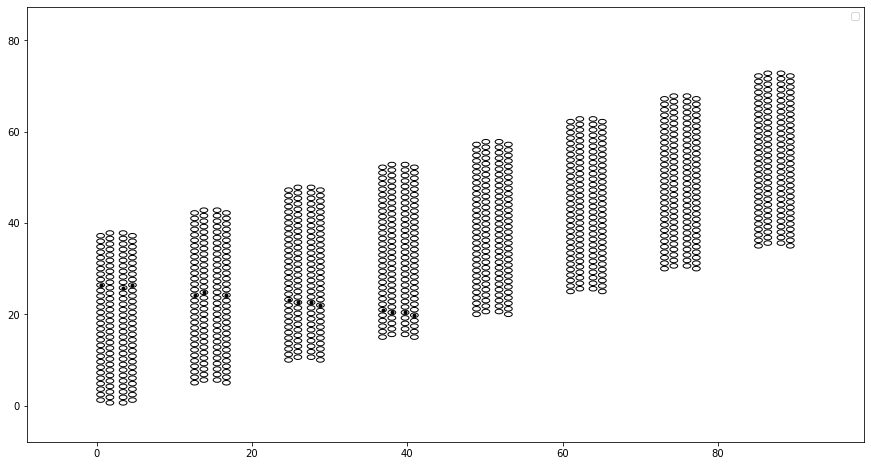

processing seed id # 4
min prediction =  0.5452452
rms prediction =  0.16874899
nhits_track =  13.0


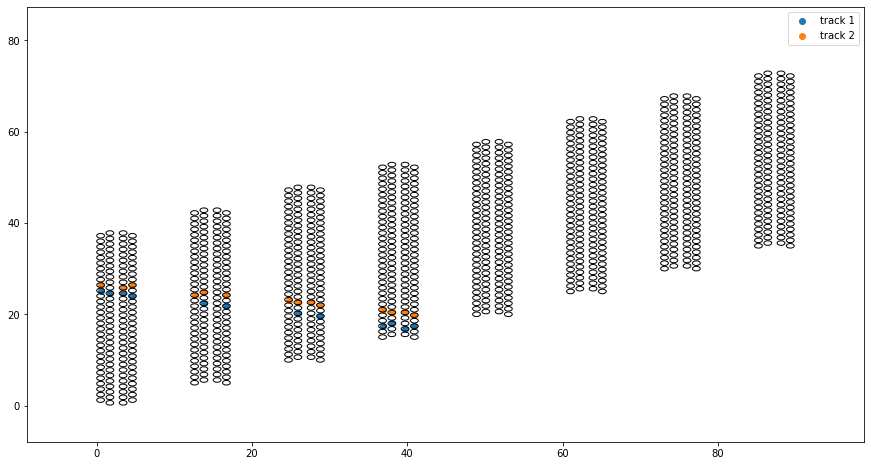

'## Disambiguate doubly assigned straw hits\nfor i_seed in range(n_seeds):\n    ## Here we should also assign input seeds definitely in output\n    ## (though that ultimately depends on seed format)\n\n    ## Check for ambiguities with all other tracks in event\n    for i_seed_check in [x for x in range(n_seeds) if x!=i_seed]:\n        ilayers,istraws = np.where((model_prediction_rounded[i_seed]>0) &\n                                   (model_prediction_rounded[i_seed]== model_prediction_rounded[i_seed_check]))\n        if len(ilayers)==0: continue\n        for i,ilayer in enumerate(ilayers):\n            istraw=istraws[i]\n            if model_prediction[i_seed][ilayer][istraw]>model_prediction[i_seed_check][ilayer][istraw]:\n                model_prediction[i_seed_check][ilayer][istraw]=0\n            else:\n                model_prediction[i_seed][ilayer][istraw]=0\n\nmodel_prediction_rounded = np.around(model_prediction)        \nreturn model_prediction_rounded\n\n'

In [119]:
## here duplicate functionality of cleanup_event_prediction
i_evt=3

"""
def cleanup_event_prediction(self, model_input, model_prediction):
Cleanup the model's prediction.
Note that input and prediction are expected to be both for a single event, 
potentially with many tracks and seeds.
The first dimension is equal to the number of seeds in the event. 
* Set all straws that weren't hit to 0
* Check whether some seeds can be combined into a single track
* Pass the combined seeds through a (new?) track search
* Disambiguate straw hits that are assigned to multiple tracks
* Round probabilistic track assignment to binary yes/no
* Return the prediction for tracks in the event
Note that the return prediction matrix will be of smaller dimension than the input
"""

## Format model input for event
model_input = tracker_NN.prepare_event_for_prediction(evts_hits[i_evt],evts_ids[i_evt])


'''
Ideas to consider:

* Extract directionality of each track candidate and seeds.
    ** Can use that information to exclude some hit outliers, changes in track direction, or veto some seed combinations.
    ** OTOH, this is too "algorithmic". That information should in principle have been "learnt" by the NN.

* First identify very good tracks
    ** They will have a high fraction of high-probability hits, and low variance in directionality
        *** We need this metric to be 100% "golden".
        *** If not (eg not fully accurate tracks still get golden output) then make loss function stricter
    ** Merge with other seeds that are included in the golden hits
        *** May mark those other seeds as seeds in the golden track
        *** Then run the track again through the NN, perhaps can gain something with more constraints
        *** Though the NN hasn't been trained to run with seeds in many modules
    ** Then remove the hits of good tracks from all other inputs, making all other tracks much more tractable
    ** Then pass everything through the NN in a second (and more simplified) pass, get better results
  
* Then after the second pass:
    ** Repeat a golden track search/merging
        *** In case another track has been made golden in the simplified problem
        *** Could consider a lowering of the selection threshold for golden
    ** Then start merging seeds between non-golden tracks
        *** Require a certain number/fraction of shared hits
        *** This might get messy, considering that late seeds have poor output
            **** If the output of a seed looks bad at this point (under some criteria) then just drop it.
            **** Its hits are probably contained in the track of an earlier seed anyway
    ** Run through model a 3rd and (probably) final time

* After 3rd pass:
    ** Repeat again golden track search/merging
    ** Do a seed merging between other candidates
    ** Lastly, disambiguate hits that are shared between tracks
        *** Based on the NN outputs
    ** May also consider a 4th pass, after the shared hits have been distributed (and nulled on the track that lost out).
        *** That should improve the tracks that wrongly selected hits
        *** Should test time/improvement balance to see if this is worth it
    
'''


### Go through all seeds. 
### Check if other seeds can be combined with it.
### For now just plot diagnostics.
## ** Best to go through first few seeds on one side, combining as needed,
##    then do the same in reverse with the last few seeds.
##    Reason is that seed combination is much more reliable among neighboring layers, 
##    and we are avoiding runaway issues from tracks wrongly combined and extrapolated

### 1st pass
### * Make prediction
### * Look for golden tracks
### * Merge their seeds
### * Remove their hits from other inputs
model_input, removed_seed_ids, good_track_ids = search_golden_seeds(model_input)
### Are we done?
if removed_seed_ids is np.nan:
    print('Hold up, only 1 or 0 seeds in event')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Need more seeds for disambiguation/merging")
if (model_input.shape[0]-len(removed_seed_ids) == len(good_track_ids) ):
    print('Lucky! Found all good tracks in 1st pass')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Donezo!")

    
### 2nd pass
### using modified/simplified input
### * Begin by another golden track search (only if a golden track was found previously)
if len(good_track_ids)>0: 
    model_input, removed_seed_ids, good_track_ids = merge_golden_seeds(model_input, 
                                                                       removed_seed_ids=removed_seed_ids, 
                                                                       good_track_ids=good_track_ids)
    if (model_input.shape[0]-len(removed_seed_ids) == len(good_track_ids) ):
        print('Finished right after 2nd pass prediction')
        display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
        raise SystemExit("Donezo!")

model_input, removed_seed_ids, good_track_ids = merge_silver_seeds(model_input, 
                                                                   removed_seed_ids=removed_seed_ids, 
                                                                   good_track_ids=good_track_ids)
if removed_seed_ids is np.nan:
    print('Hold up, only 1 or 0 seeds in event')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Need more seeds for disambiguation/merging")
if (model_input.shape[0]-len(removed_seed_ids) == len(good_track_ids) ):
    print('Finished after 2nd-pass silver seeds merging')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Donezo!")

    
### 3rd pass
### * Begin by another golden track search
model_input, removed_seed_ids, good_track_ids = merge_golden_seeds(model_input, 
                                                                   removed_seed_ids=removed_seed_ids, 
                                                                   good_track_ids=good_track_ids)
if (model_input.shape[0]-len(removed_seed_ids) == len(good_track_ids) ):
    print('Finished right after 3rd pass golden search')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Donezo!")

model_input, removed_seed_ids, good_track_ids = merge_silver_seeds(model_input, 
                                                                   removed_seed_ids=removed_seed_ids, 
                                                                   good_track_ids=good_track_ids)
if removed_seed_ids is np.nan:
    print('Hold up, only 1 or 0 seeds in event')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Need more seeds for disambiguation/merging")
if (model_input.shape[0]-len(removed_seed_ids) == len(good_track_ids) ):
    print('Finished after 3rd-pass silver seeds merging')
    display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])
    raise SystemExit("Donezo!")
    

### Endgame: disambiguate hits that are selected in multiple tracks
model_input, removed_seed_ids, good_track_ids = disambiguate_hits(model_input, 
                                                                  removed_seed_ids=removed_seed_ids, 
                                                                  good_track_ids=good_track_ids)
    

### Wrap up prediction
model_input, removed_seed_ids = wrapup_prediction(model_input, 
                                                  removed_seed_ids=removed_seed_ids, 
                                                  good_track_ids=good_track_ids)
### **** new function here ****





        
        
        
        
        
display_event(tracker, evts_hits[i_evt], evts_ids[i_evt])


        
    




    
'''
for i_seed1 in range(min(step_seeds,n_seeds-1)):
    ## Compare this seed with other seeds near it
    for i_seed2 in range(i_seed1+1,min(step_seeds+1,n_seeds)):

        print('\n', i_seed1, i_seed2)
        layers1,straws1=np.where(model_input[i_seed1]==1)
        seed_layers1=layers1[straws1>=tracker_NN.detector.n_straws]
        seed_straws1=straws1[straws1>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws

        layers2,straws2=np.where(model_input[i_seed2]==1)
        seed_layers2=layers2[straws2>=tracker_NN.detector.n_straws]
        seed_straws2=straws2[straws2>=tracker_NN.detector.n_straws] - tracker_NN.detector.n_straws

        ## if these two inputs have seeds in common layers, then skip
        if any(common_layers in seed_layers1 for common_layers in seed_layers2):
            print ('seeds in same module, skipping')
            continue
        
        same_seed_hits=np.sum(model_prediction_selected[i_seed1][seed_layers2,seed_straws2]==1)
        if same_seed_hits:
            print('Seed #%d selected %d hits from seed #%d'%(i_seed1, same_seed_hits, i_seed2))
        same_seed_hits=np.sum(model_prediction_selected[i_seed2][seed_layers1,seed_straws1]==1)
        if same_seed_hits:
            print('Seed #%d selected %d hits from seed #%d'%(i_seed2, same_seed_hits, i_seed1))
            
        
        all_layers1,all_straws1=np.where(model_prediction_selected[i_seed1]==1)
        all_layers2,all_straws2=np.where(model_prediction_selected[i_seed2]==1)
        f1 = np.sum(model_prediction_selected[i_seed1][all_layers2,all_straws2]) / np.sum(model_prediction_selected[i_seed1])
        print('%.f of seed1 were selected also by seed2'%(100*f1))
        f2 = np.sum(model_prediction_selected[i_seed2][all_layers1,all_straws1]) / np.sum(model_prediction_selected[i_seed2])
        print('%.f of seed2 were selected also by seed1'%(100*f2))
        

'''
        
        


'''## Disambiguate doubly assigned straw hits
for i_seed in range(n_seeds):
    ## Here we should also assign input seeds definitely in output
    ## (though that ultimately depends on seed format)

    ## Check for ambiguities with all other tracks in event
    for i_seed_check in [x for x in range(n_seeds) if x!=i_seed]:
        ilayers,istraws = np.where((model_prediction_rounded[i_seed]>0) &
                                   (model_prediction_rounded[i_seed]== model_prediction_rounded[i_seed_check]))
        if len(ilayers)==0: continue
        for i,ilayer in enumerate(ilayers):
            istraw=istraws[i]
            if model_prediction[i_seed][ilayer][istraw]>model_prediction[i_seed_check][ilayer][istraw]:
                model_prediction[i_seed_check][ilayer][istraw]=0
            else:
                model_prediction[i_seed][ilayer][istraw]=0

model_prediction_rounded = np.around(model_prediction)        
return model_prediction_rounded

'''

 Event # 0


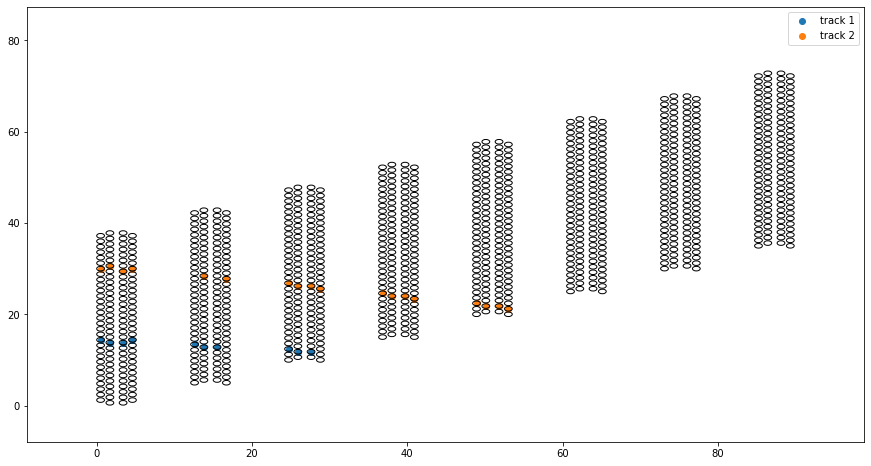

 Event # 1


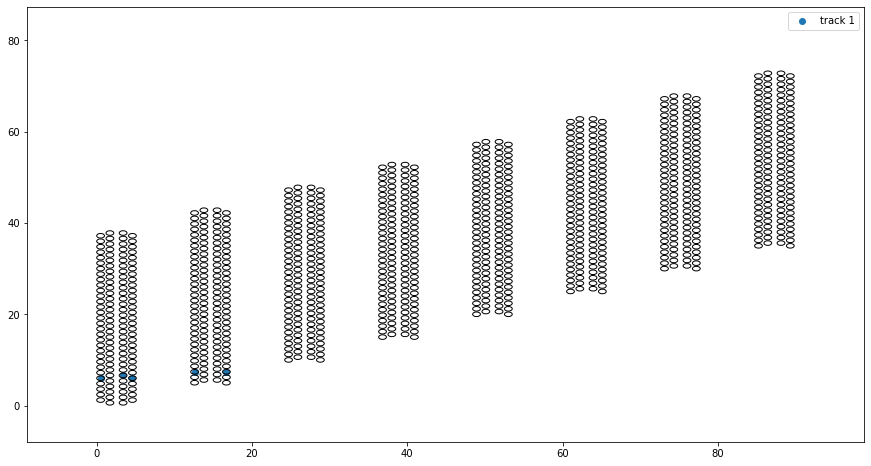

 Event # 2


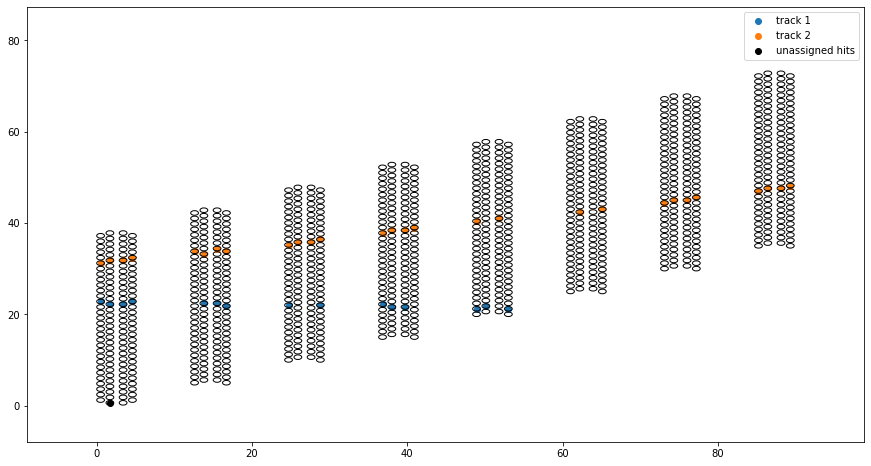

 Event # 3


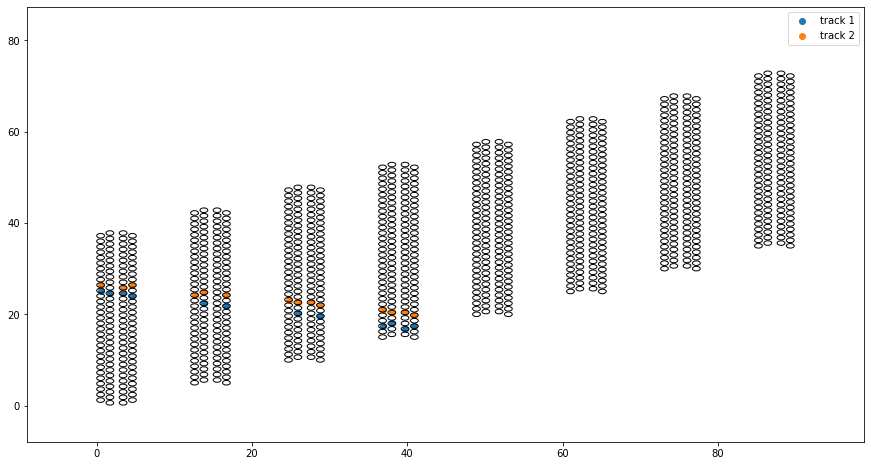

 Event # 4


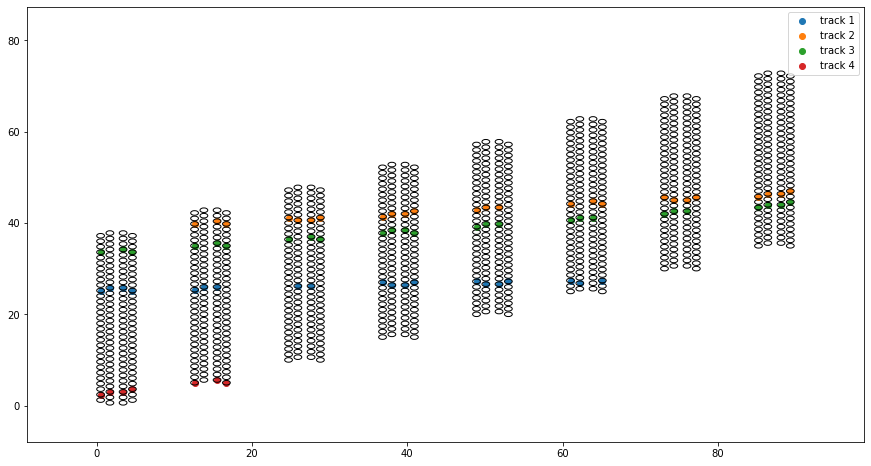

 Event # 5


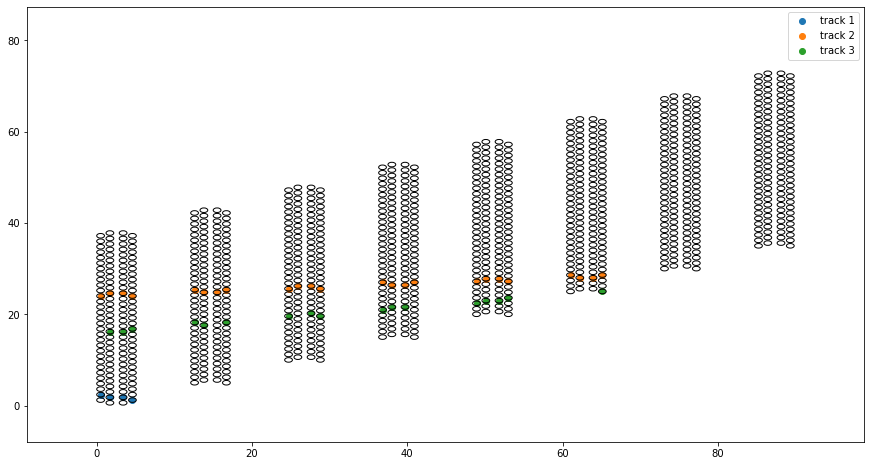

 Event # 6


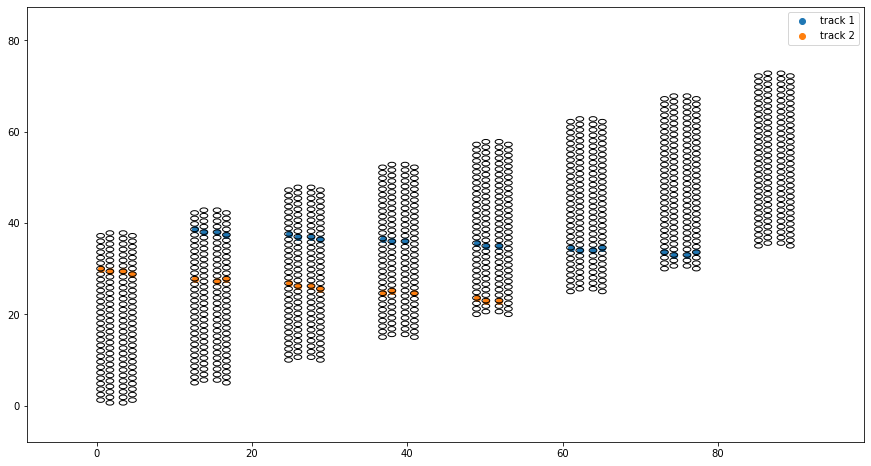

 Event # 7


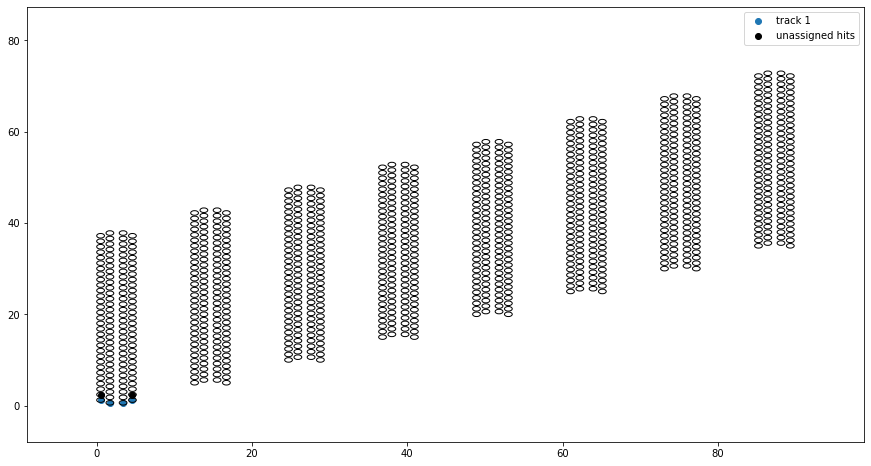

 Event # 8


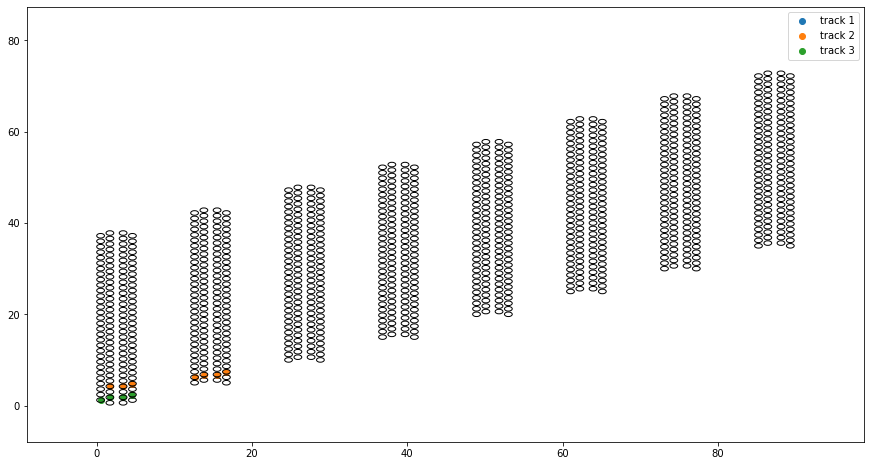

 Event # 9


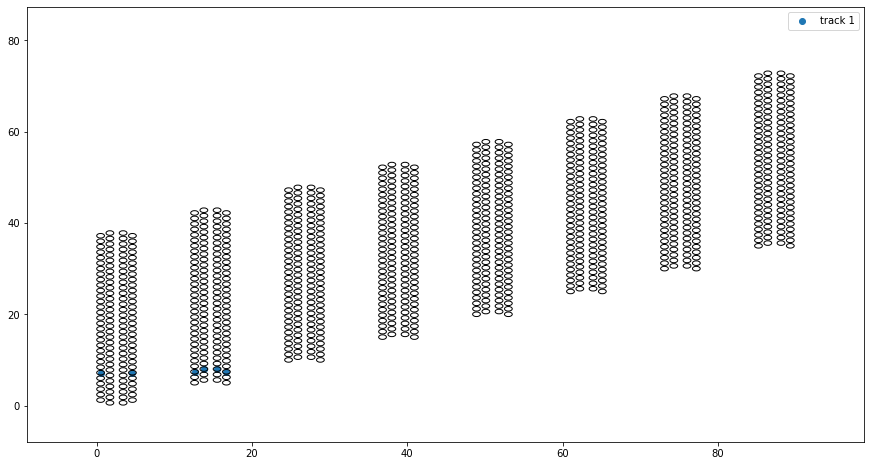

In [36]:
range_start=0
for i in range(range_start,range_start+10):
    print(' Event #', i)
    display_event(tracker, evts_hits[i], evts_ids[i])

 Event # 0
 Found 1 seeds in the event

Seeds processed:  1


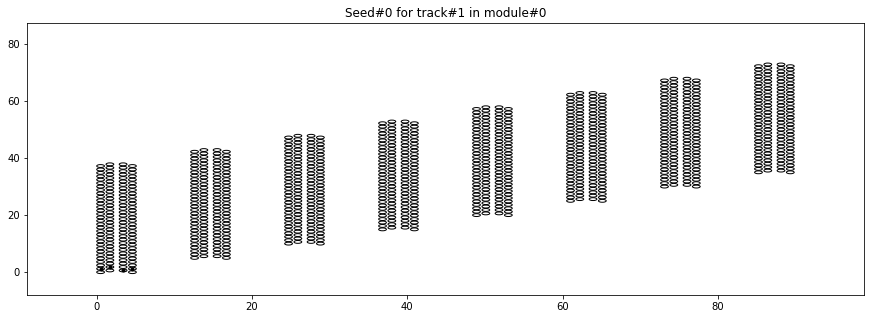

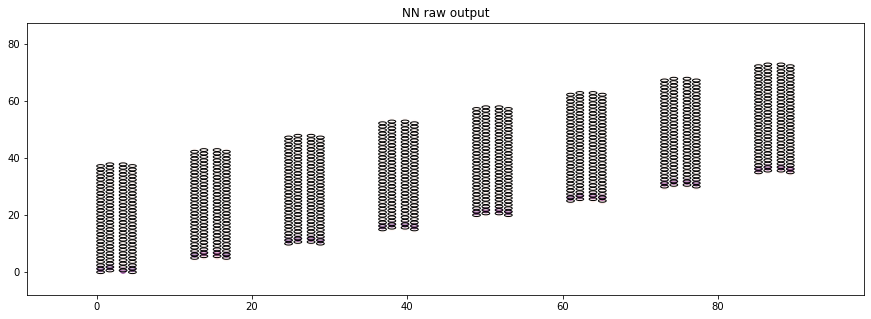

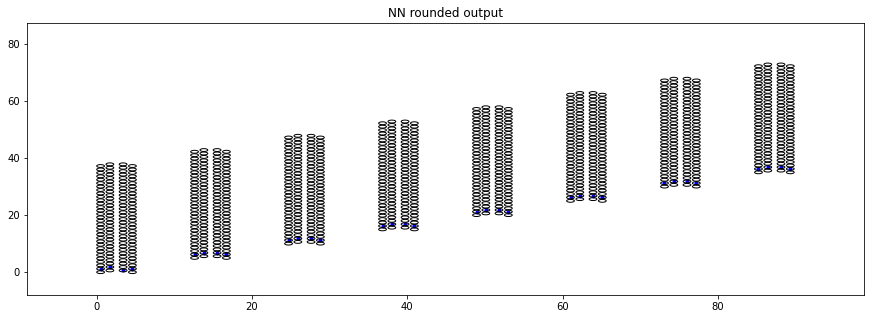

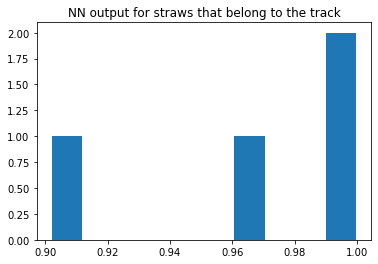

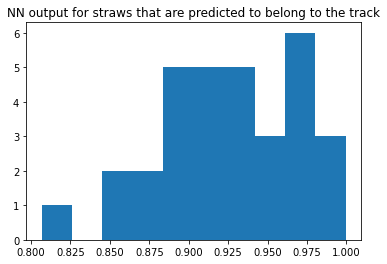

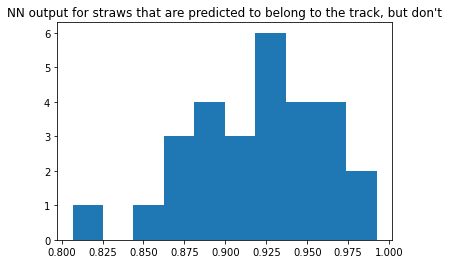

 Event # 1
 Found 5 seeds in the event

Seeds processed:  5


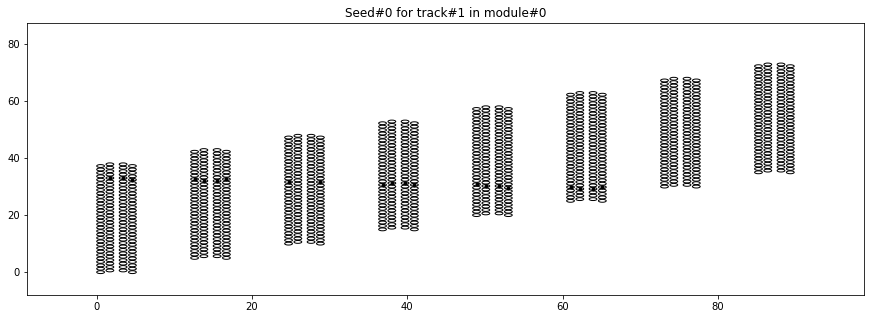

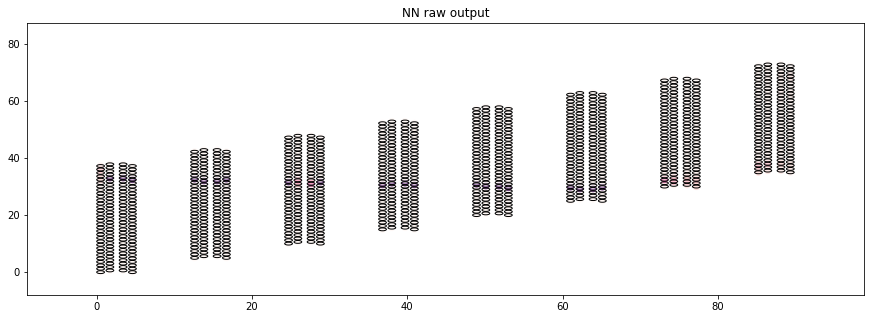

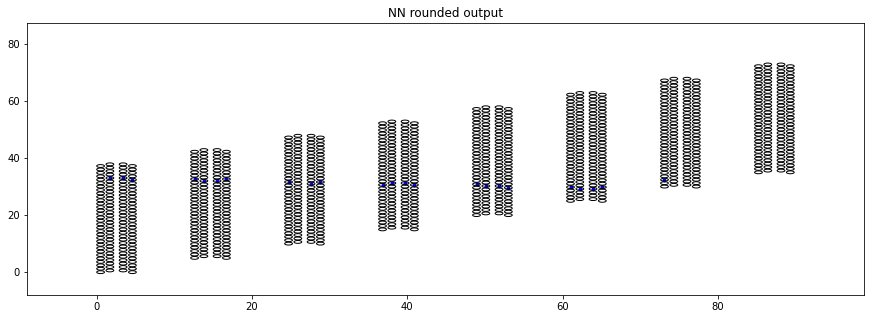

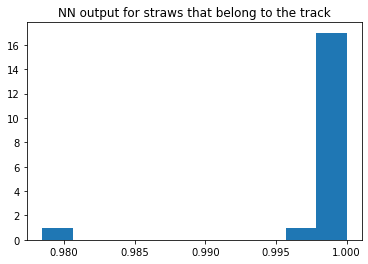

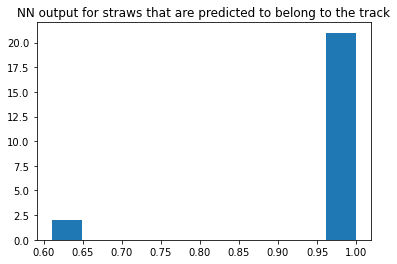

...

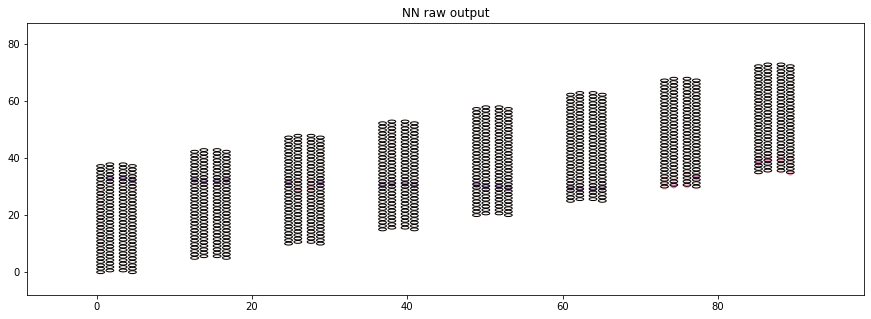

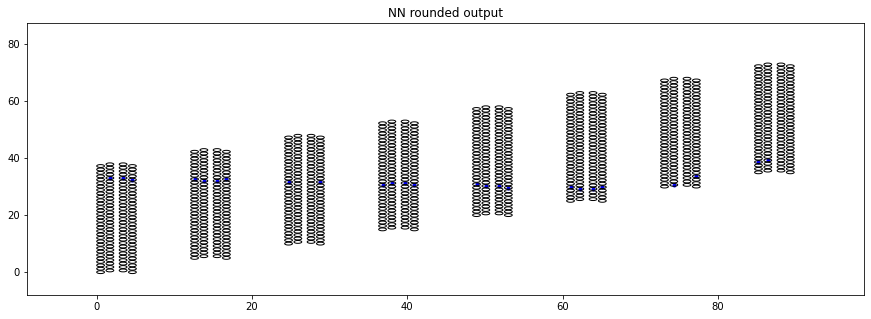

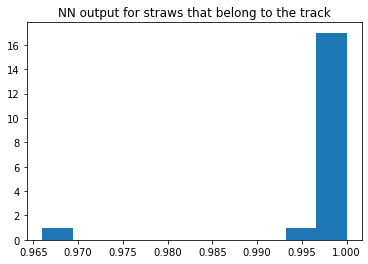

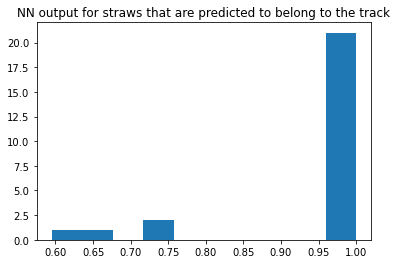

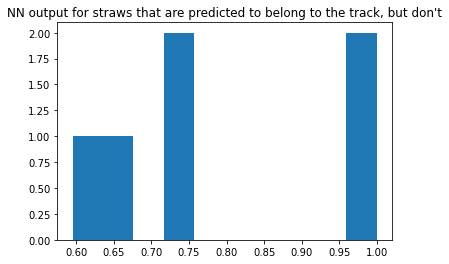

 Event # 2
 Found 19 seeds in the event

Seeds processed:  19


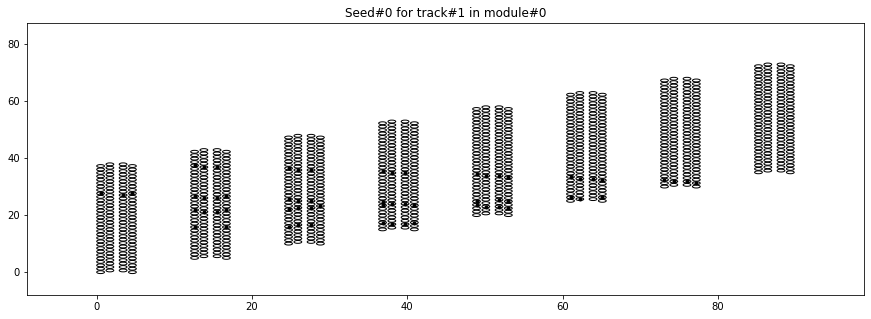

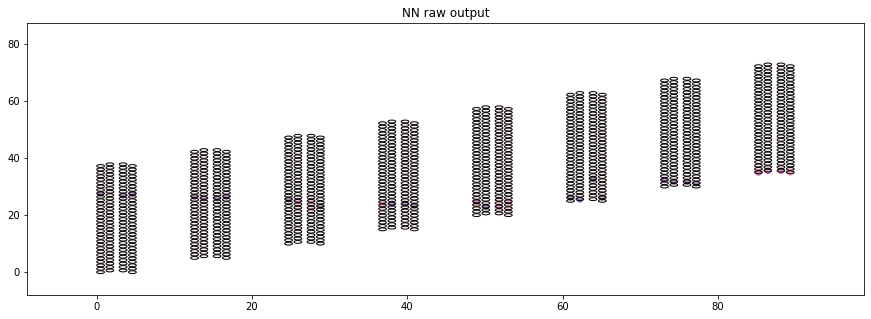

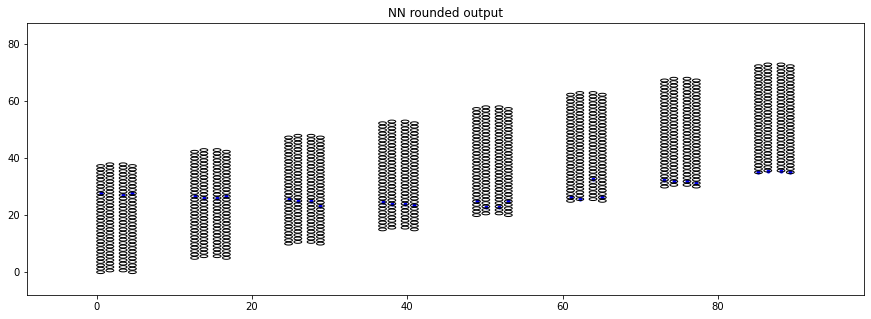

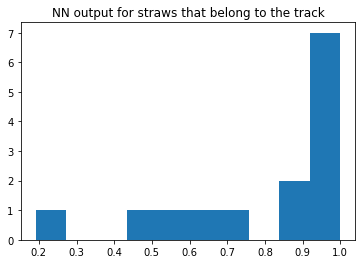

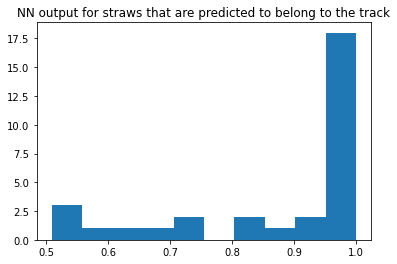

...

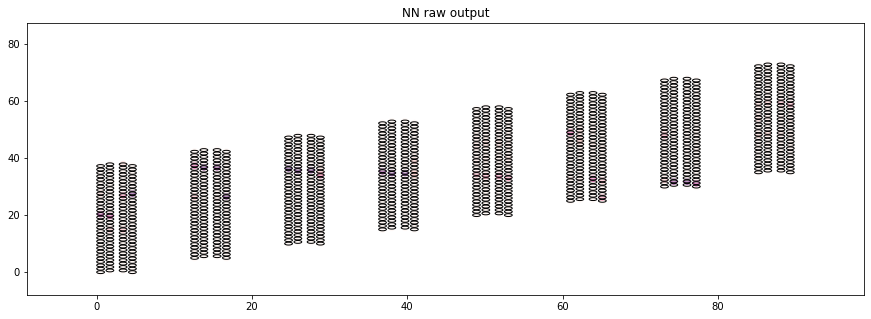

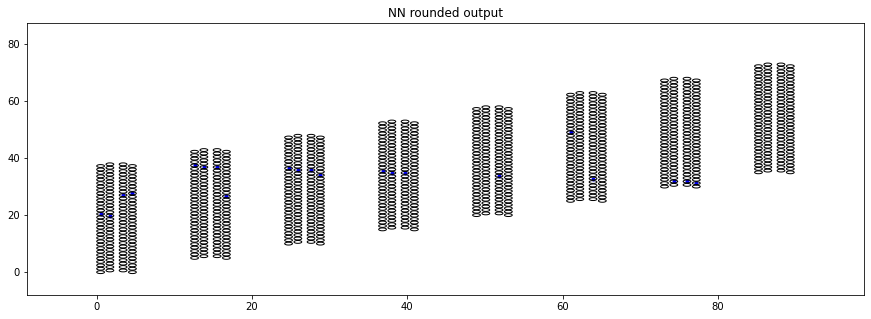

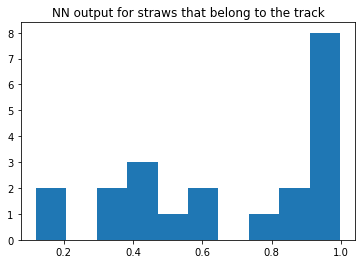

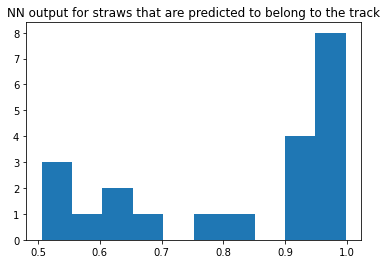

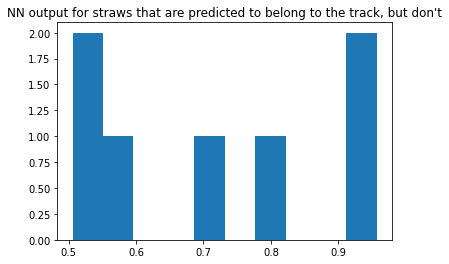

 Event # 3
 Found 10 seeds in the event

Seeds processed:  10


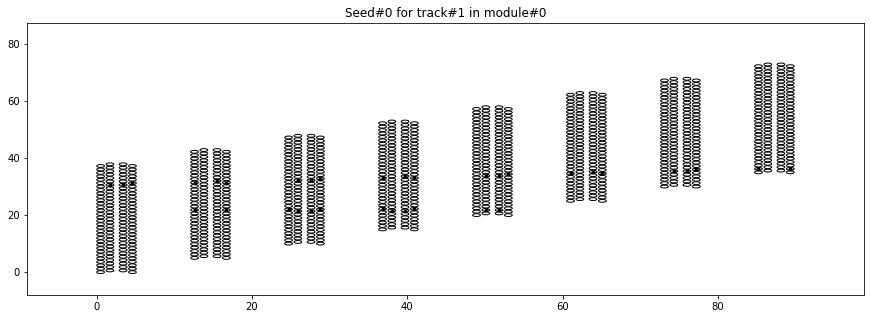

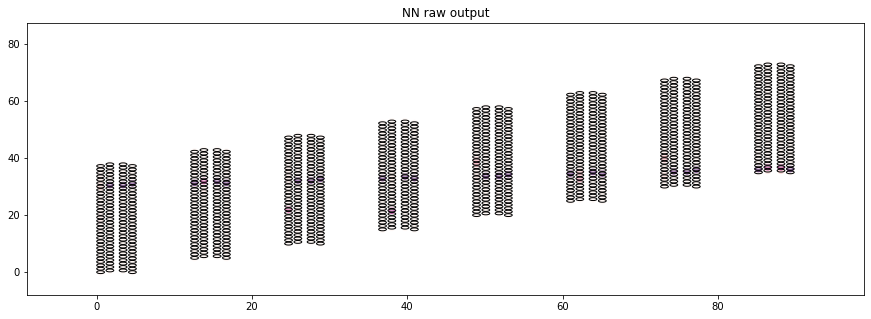

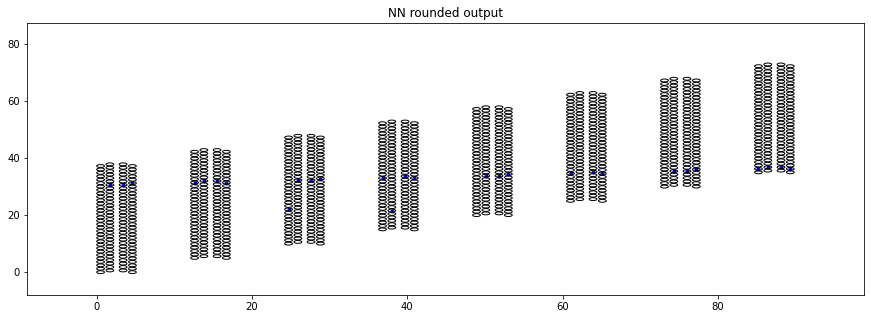

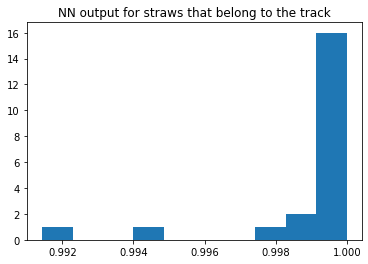

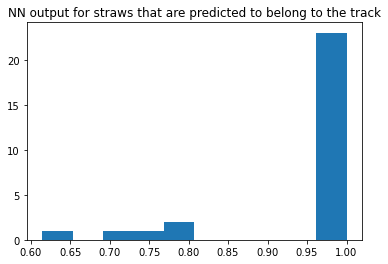

...

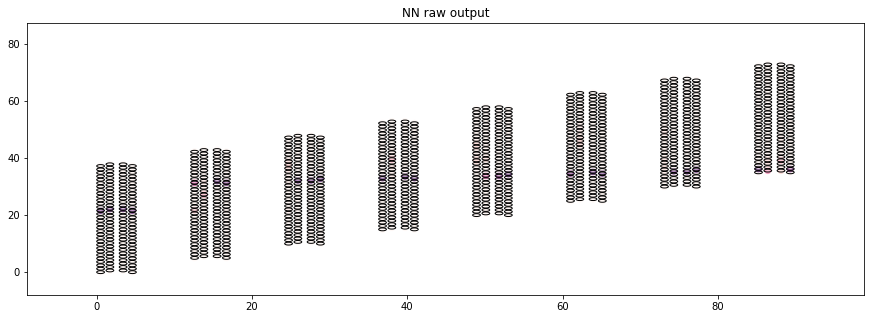

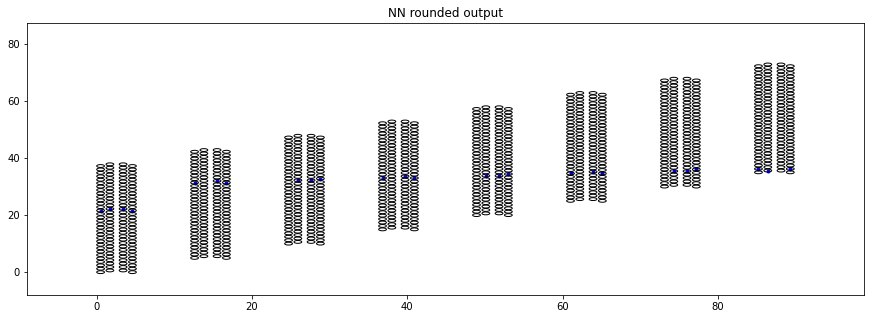

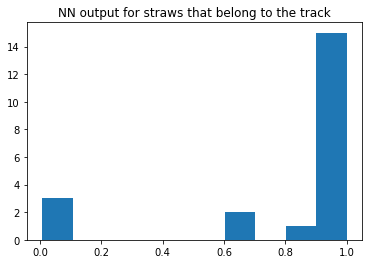

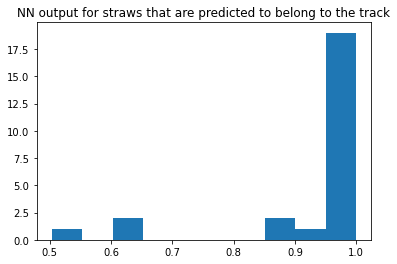

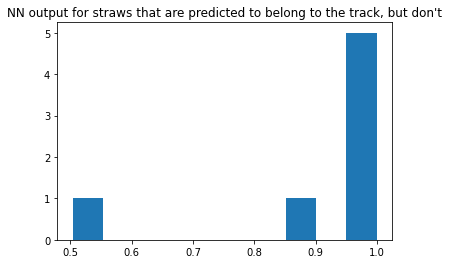

 Event # 4
 Found 4 seeds in the event

Seeds processed:  4


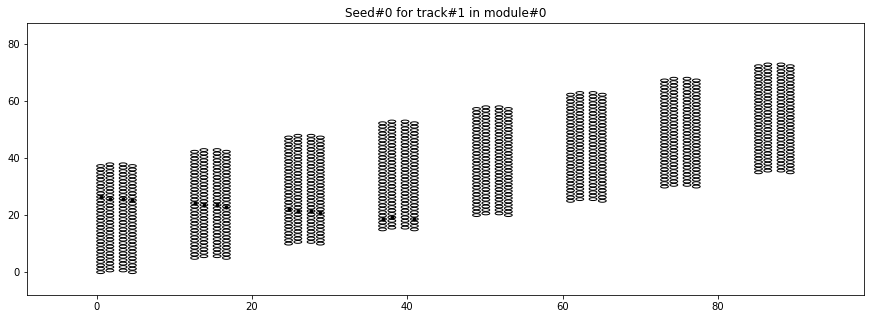

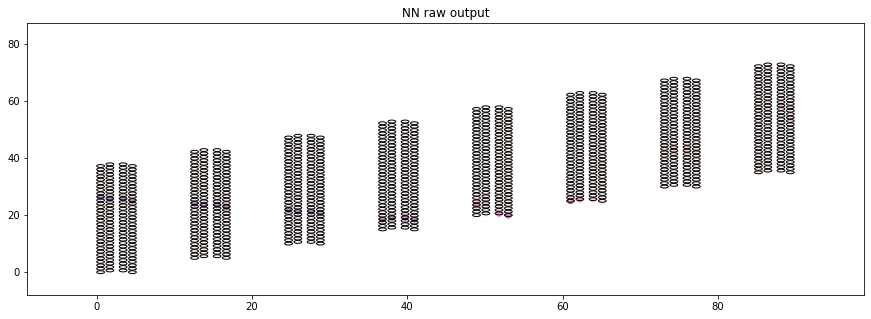

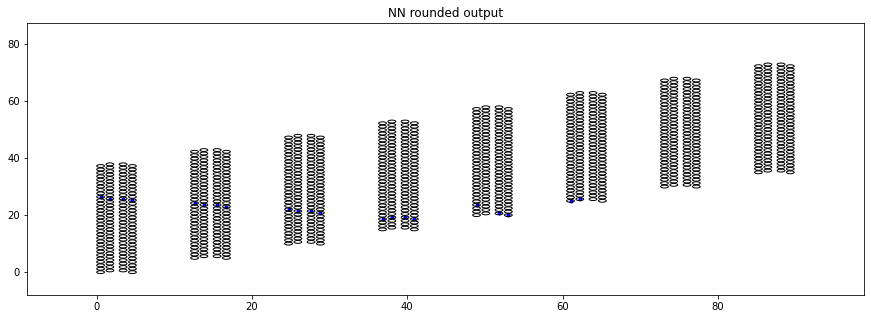

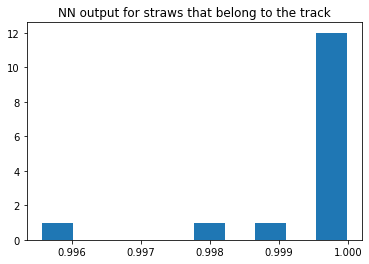

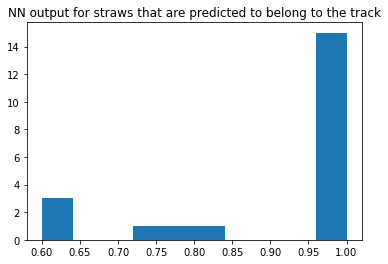

...

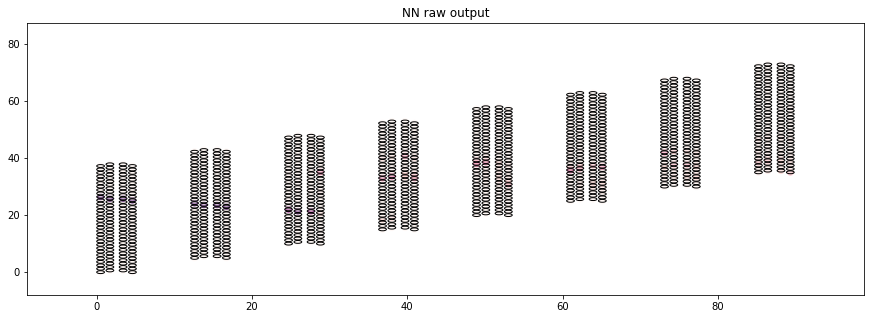

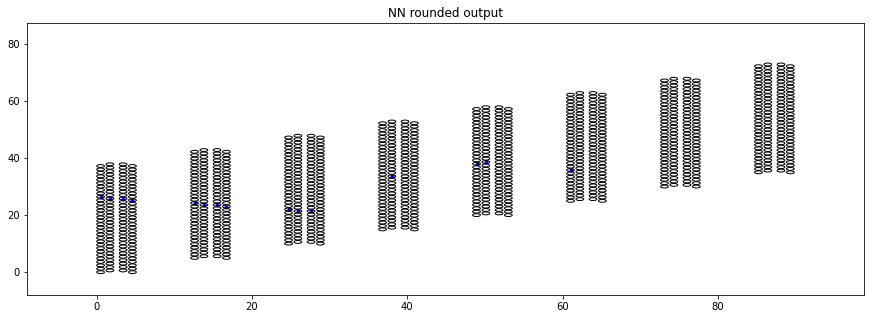

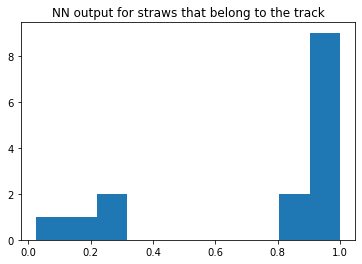

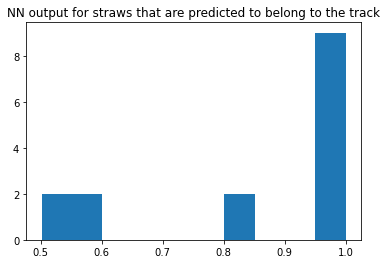

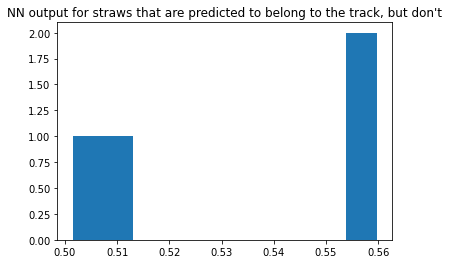

 Event # 5
 Found 9 seeds in the event

Seeds processed:  9


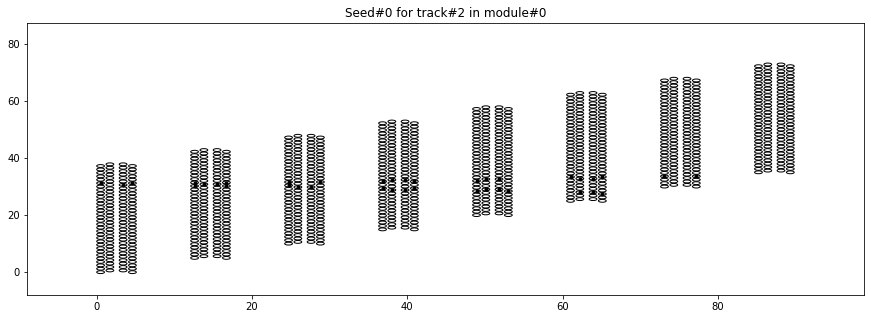

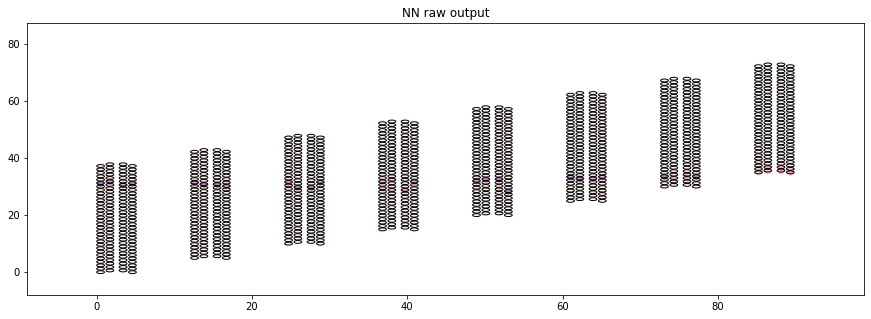

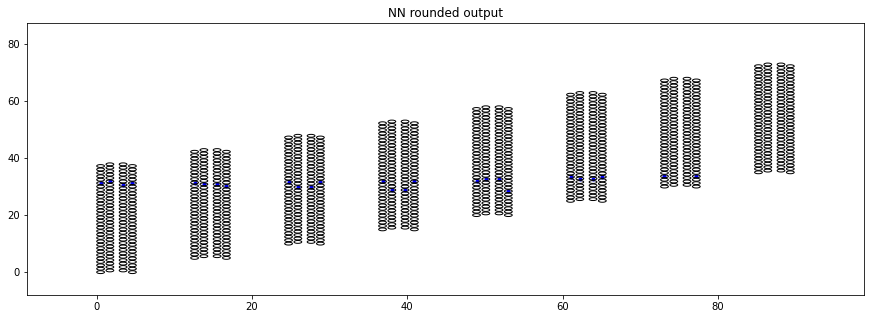

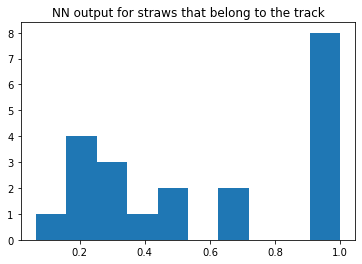

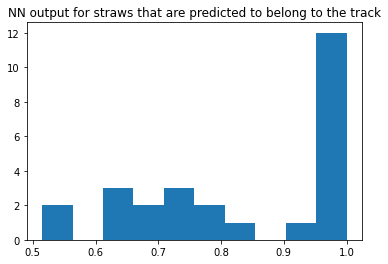

...

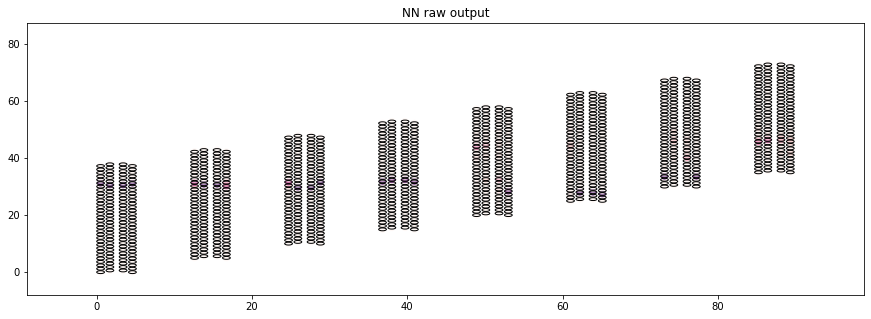

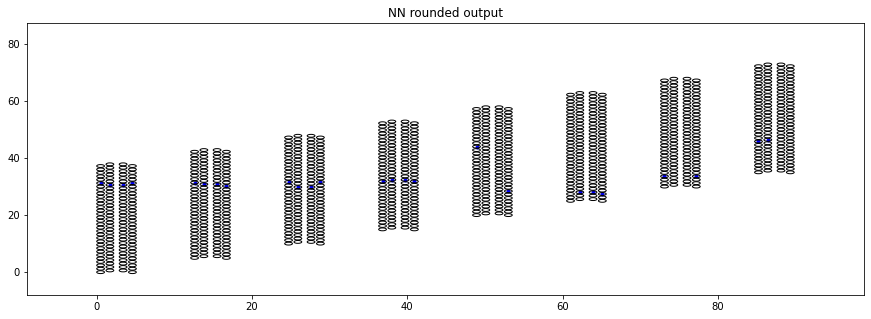

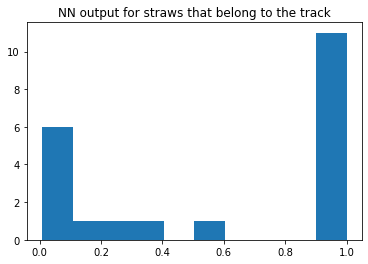

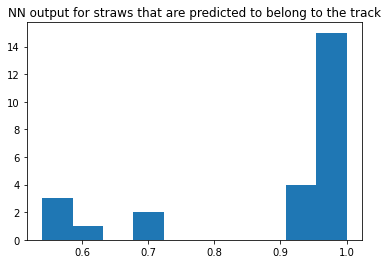

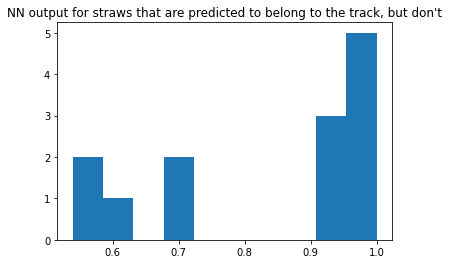

 Event # 6
 Found 5 seeds in the event

Seeds processed:  5


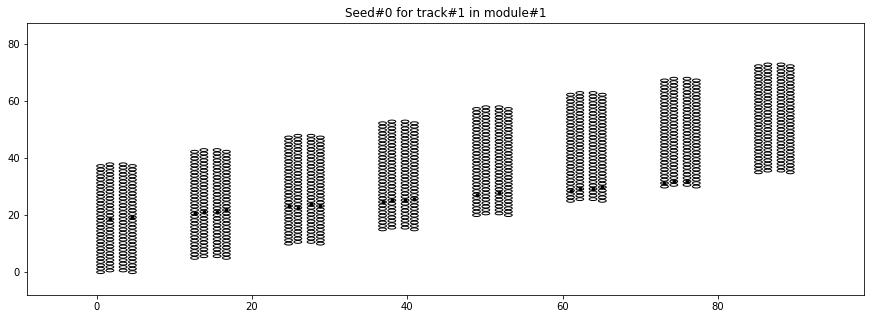

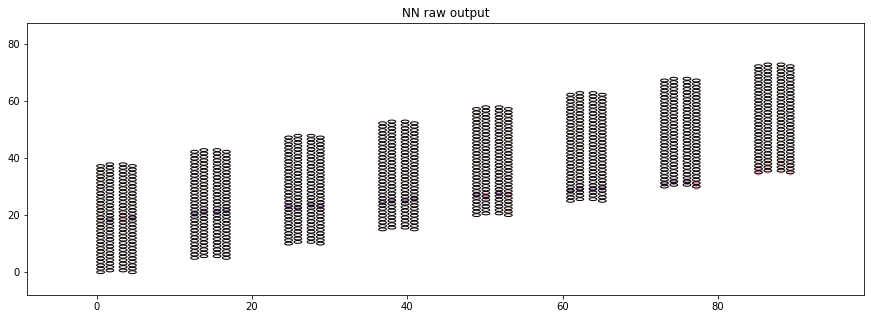

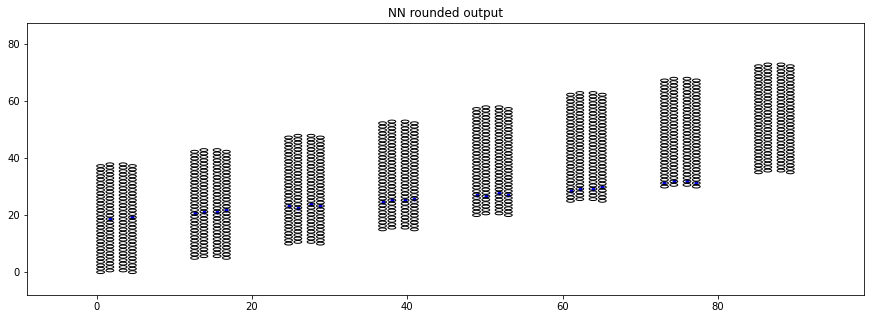

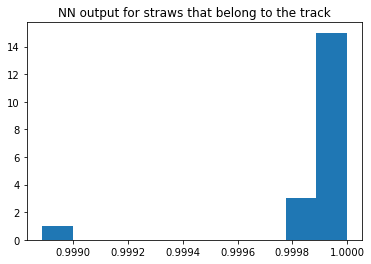

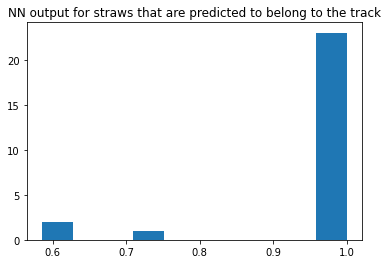

...

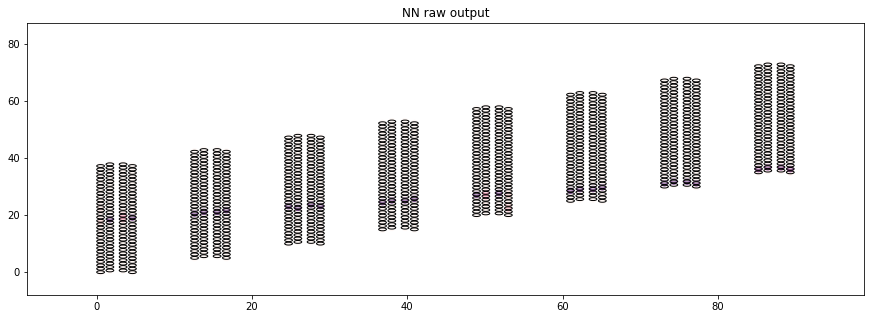

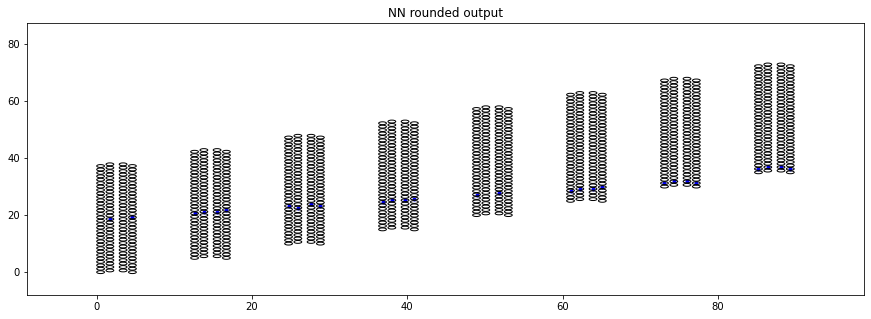

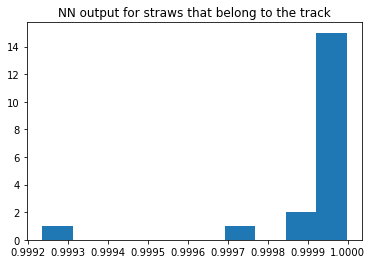

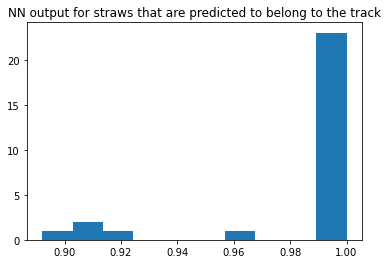

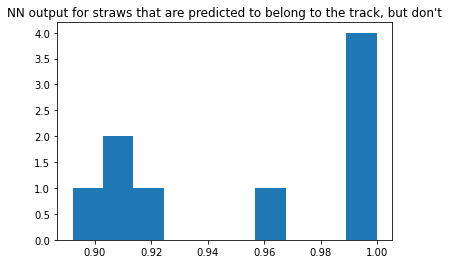

 Event # 7
 Found 9 seeds in the event

Seeds processed:  9


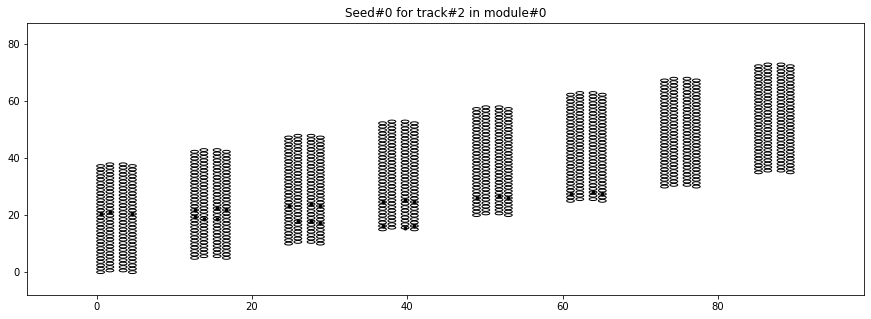

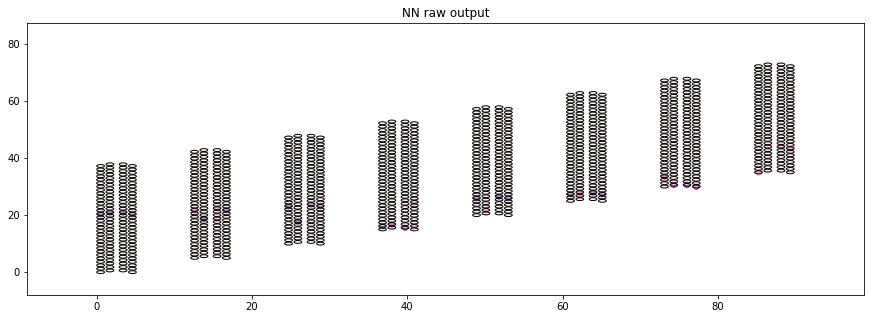

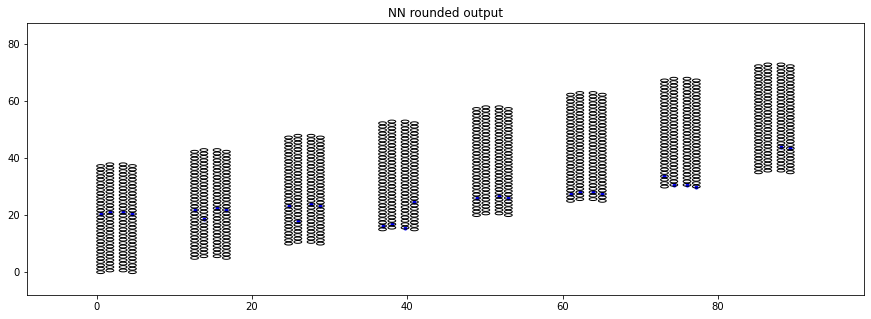

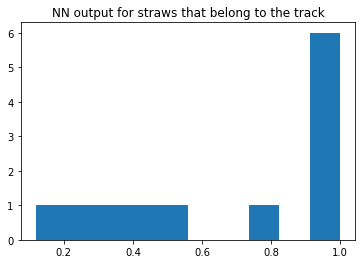

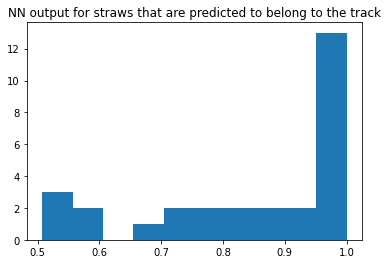

...

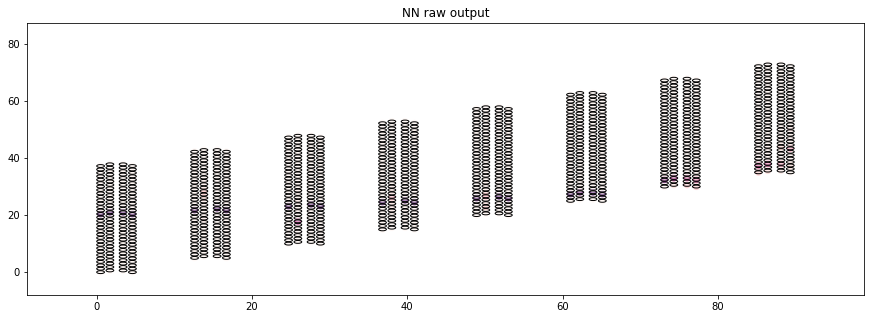

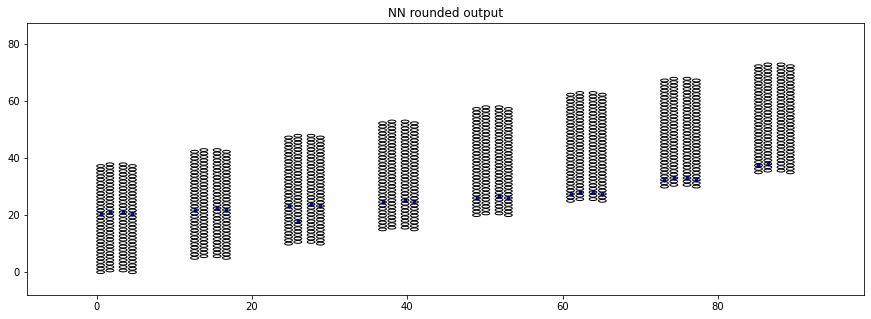

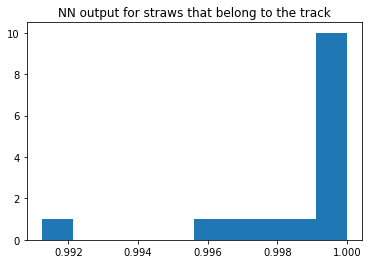

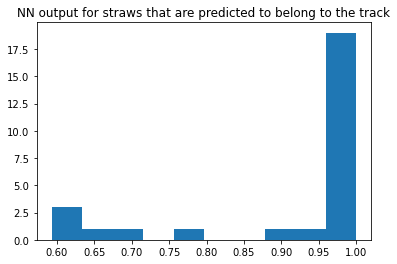

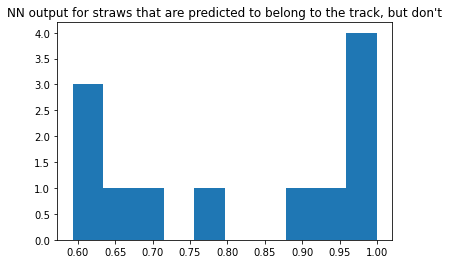

 Event # 8
 Found 8 seeds in the event

Seeds processed:  8


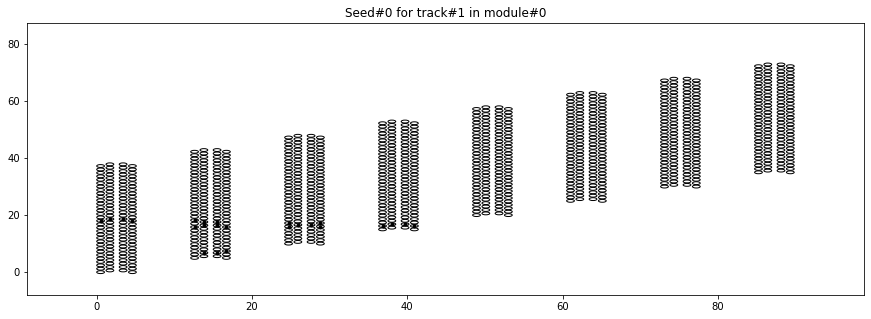

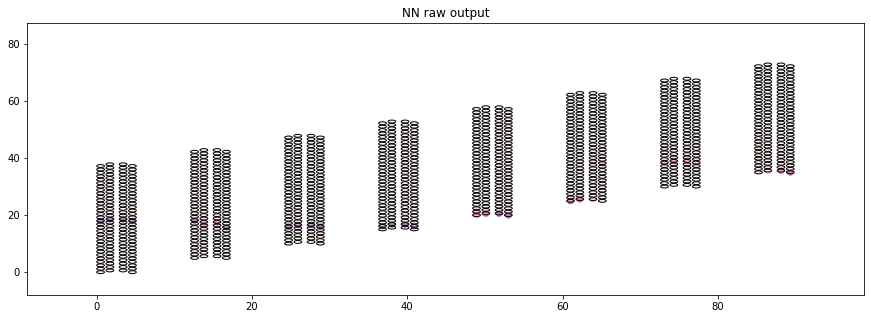

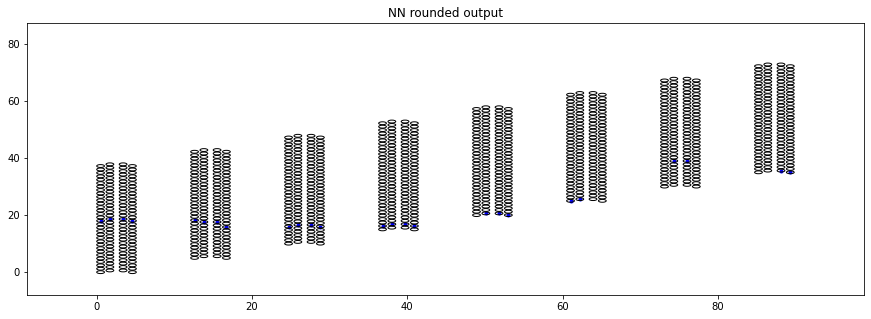

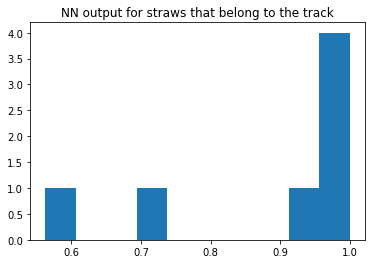

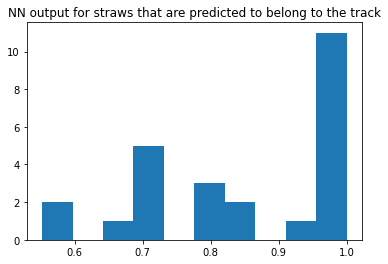

...

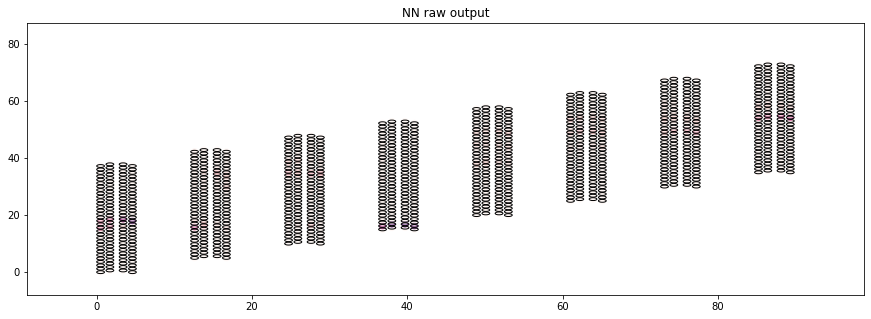

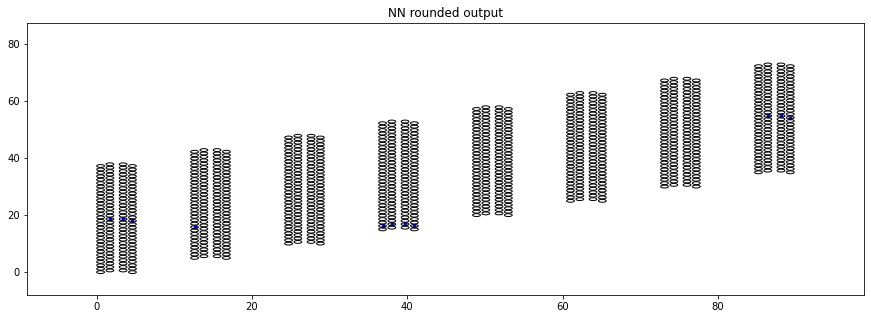

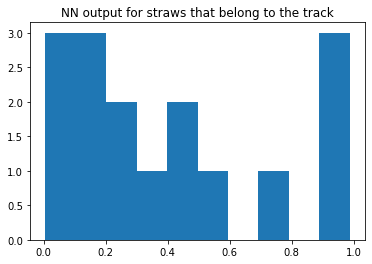

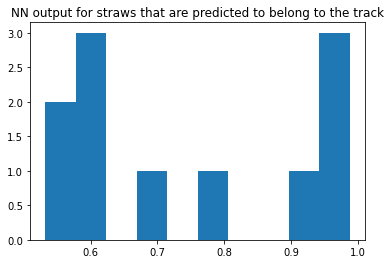

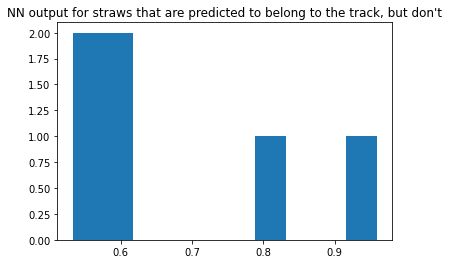

 Event # 9


In [53]:
range_start=0
for i in range(range_start,range_start+10):
    print(' Event #', i)
    tracker_NN.plot_event_and_NNoutput(evts_hits[i],evts_ids[i], figsize=(15,5))

## Build scoring function
The scoring function only examines hits in an event, assigns them to most likely seed in event

In [ ]:
i_evt=4
tracker.plot_event_and_prediction(evts_hits[i_evt],evts_ids[i_evt], figsize=(20,3))

In [55]:
def score_function(true_ids, predicted_ids):
    '''
    Calculate an accuracy score based on hits within events, which belong to seeded tracksa.
    Both true and predicted ids are of shape (n_evts, length, width).
    Accuracy score is calculated as the fraction of correctly assigned hits.
    '''
    n_trackhits, n_trackhits_correct=0,0
    n_predicted,n_predicted_correct=0,0
    
    n_evts=true_ids.shape[0]
    
    for i_evt in range(n_evts):
        
        ## get all seeds in this event
        seeds=make_seeds(true_ids[i_evt])
        seed_ids = np.unique([x for x in seeds[0] if x>0])
        n_seeds = len(seed_ids)
        if n_seeds==0: continue
        
        for seed_id in seed_ids:
            # all hits from the track with this seed
            layers,straws=np.where(true_ids[i_evt]==seed_id)
            n_trackhits += len(layers)
            
            # of these hits, get those predicted correctly
            # (exact seed id # doesn't have to match the "truth", just the seed)
            predicted_seed = predicted_ids[i_evt][layers[0]][straws[0]]## currently a little problematic, as it is possible for the 0th layer hit to be misidentified (ie not of the seed)
            n_trackhits_correct += len( np.where(predicted_ids[i_evt][layers,straws]==predicted_seed)[0] )
            
            # number of predicted hits in track
            layers,straws=np.where(predicted_ids[i_evt]==predicted_seed)
            n_predicted += len(layers)
            
            # of the predicted hits, get those that are correct
            n_predicted_correct += len( np.where((predicted_ids[i_evt]==predicted_seed) &
                                                (true_ids[i_evt]==seed_id))[0] )
    
    if n_trackhits==0:
        print('No seeds found in events passed')
        return 0
    
    print('Fraction of track hits identified correctly: ', n_trackhits_correct/n_trackhits)
    print('Fraction of predicted hits that belong to the correct track: ', n_predicted_correct/n_predicted)
    return n_predicted_correct/n_predicted



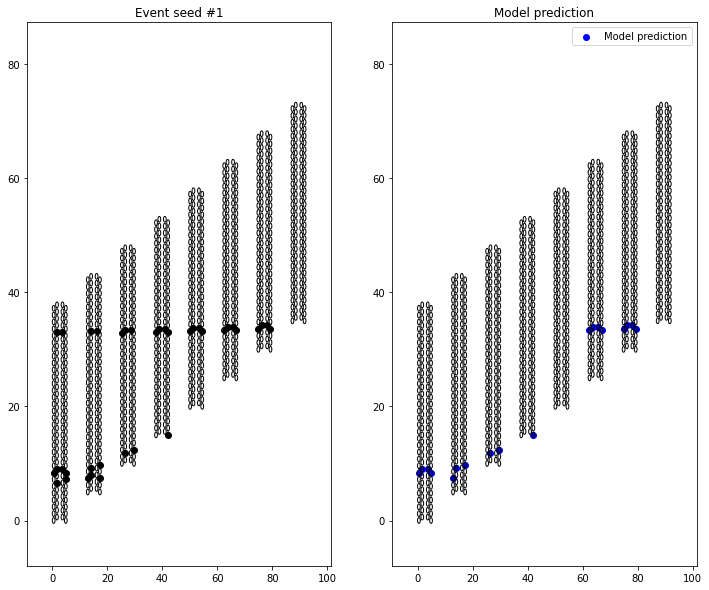

Fraction of track hits identified correctly:  0.7142857142857143
Fraction of predicted hits that belong to the correct track:  0.2777777777777778


0.2777777777777778

In [63]:
i_evt=1
tracker_NN.plot_event_and_prediction(evts_hits[i_evt],evts_ids[i_evt], figsize=(12,10))
predicted_ids=np.zeros(shape=(1,evts_hits[0].shape[0],evts_hits[0].shape[1] ))
predicted_ids[0]=tracker_NN.predict_event_ids(evts_hits[i_evt], evts_ids[i_evt])
evt_ids=np.zeros_like(predicted_ids)
evt_ids[0]=evts_ids[i_evt]
score_function(evt_ids, predicted_ids )

In [61]:
predicted_ids=tracker_NN.predict_ids(evts_hits, evts_ids)
score_function(evts_ids, predicted_ids )

Fraction of track hits identified correctly:  0.898925463190217
Fraction of predicted hits that belong to the correct track:  0.19295640673592424


0.19295640673592424

## Notes on current status

Looks like we are doing worse than before.  
The fraction of track hits that are identified correctly is doing a little bit worse, 90% down from ~95%.  
But we are really doing worse on the fraction of predicted hits that actually belong to the correct track.  

This arises out of the updated geometry, for two reasons:
1) I didn't update the direction of generated tracks, which means that the detector geometry is now not optimized to detect these tracks, likely resulting in missing the first layers on a few tracks.  
2) Increased requirement of 3 hits per seed, meaning it's even more likely that many tracks will have missed their seed.  

Both result in many more "unclaimed" hits, which are very likely to be claimed by existing seeded track searches, resulting in errors. This is a well understood mechanism.  

Improvements needed:
1) Search for seeds anywhere in the tracker. That will ensure that most tracks are searched for, and therefore there will be much fewer unclaimed hits.  
2) The above is doubly important!  
3) Improve pseudotrack generation, make it more symmetric to the detector's directionality.  
4) Add cleanup for hits that are impossible to belong to teh same track as the seed, after taking into account an average track directionality. That is probably too algorithmic and clunky to impose.

In [ ]:
'''
as used in the HEPTrkX

## prepare training input and labels
train_events = np.zeros((n_training_events, 1, det.length, det.width))
train_targets = -99 * np.ones((n_training_events, det.length, det.width))
train_weights = np.zeros((n_training_events, det.length, det.width))

for i_event in range(n_training_events):
    train_events[i_event,0] = np.clip( sum( tracks[:num_tracks] ), 0, 1)
    event_targets = np.asarray(targets[:num_tracks])
    train_targets[n,:num_tracks] = event_targets[event_targets[:,0].argsort()] # sort by first column
    train_weights[n,:num_tracks] = np.ones((num_tracks))
'''



In [ ]:

'''
def build_model_1():
    """Test model.  Consists of several convolutional layers followed by dense layers and an LSTM"""
    input_layer = layers.Input(shape=events_hits[0].shape)
    layer = layers.Convolution1D(8, 3, 3, border_mode='same')(input_layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Convolution1D(8, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    #layer = layers.MaxPooling2D(pool_size=(2,2))(layer) ## no pooling layers - they will reduce the dimension
    layer = layers.Convolution1D(32, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Convolution1D(32, 3, 3, border_mode='same')(layer)
    layer = layers.Activation('relu')(layer)
    layer = layers.Dense(400)(layer)
    layer = layers.RepeatVector(mean_tracks)(layer)
    layer = layers.LSTM(400, return_sequences=True)(layer)
    output_layer = layers.TimeDistributed(layers.Dense(2))(layer)
    outputs = layers.Dense(original_dim, activation="sigmoid")(x)

    model = models.Model(input=input_layer, output=output_layer)
    model.compile(loss='mean_squared_error', optimizer='Adam')
    return model

model = Sequential()
model.add(Conv1D(64, 
                 kernel_size=3, 
                 activation="relu", 
                 padding='same',
                 input_shape=(X_train.shape[1],X_train.shape[2])))
model.add(Conv1D(32, 
                 kernel_size=3, 
                 activation="relu",
                 padding='same'))
'''

In [67]:
# Model
from keras.models import Sequential
from keras.layers import Dense, LSTM, Conv1D, Conv2D, Conv3D, Activation, MaxPooling1D, MaxPooling2D
from keras.optimizers import Adam

input_shape=events_hits[0].shape


class Model_Conv1D():
    '''
    A convolutional NN with Conv1D layers.
    Currently does poorly. 
    Weirdly it does worst with more complexity and an extra convolutional layer, 
    compared to just two simple Conv1D.
    **** TO DO:
        ** set weights, according to the HEPTrkX example
        ** set seeds
        ** try different compilation, ie loss, optimizer...
    
    Probably not great to use 1D for a 2D picture of the tracker.
    Better to try adding a dummy dimension (corresponding to the "value" of each straw, ie whether hit or not)
    and do a Conv2D model. 
    (this is done in the next model cell)
    '''
    
    def __init__(self):
        self.learning_rate = 0.001
        self.build_model()

    def build_model(self):
        self.model = Sequential()

        ## Sequential applications of convolutional layer, followed by non-linearity, followed by pooling
        self.model.add(
            Conv1D(20, 
                   kernel_size=10, 
                   activation="relu", 
                   padding='same',
                   input_shape=input_shape )
        )
        self.model.add(Activation('relu'))
        self.model.add(
            MaxPooling1D(pool_size=2,strides=1,padding='same')
        )

        self.model.add(
            Conv1D(40, 
                   kernel_size=6, 
                   activation="relu",
                   padding='same')
        )
        self.model.add(Activation('relu'))
        self.model.add(
            MaxPooling1D(pool_size=2,strides=1,padding='same')
        )

        self.model.add(
            Conv1D(input_shape[-1], 
                   kernel_size=3, 
                   activation="relu",
                   padding='same')
        )
        self.model.add(Activation('relu'))
        self.model.add(
            MaxPooling1D(pool_size=2,strides=1,padding='same')
        )

        self.model.summary()
        #self.model.compile(loss='categorical_crossentropy', optimizer='adam')
        self.model.compile(loss='mse', 
                           optimizer=Adam(lr=self.learning_rate),
                           metrics=['accuracy'])

nn_Conv1D = Model_Conv1D()

#        model.fit(X_train, y_train)



Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_18 (Conv1D)           (None, 30, 20)            10020     
_________________________________________________________________
activation_18 (Activation)   (None, 30, 20)            0         
_________________________________________________________________
max_pooling1d_18 (MaxPooling (None, 30, 20)            0         
_________________________________________________________________
conv1d_19 (Conv1D)           (None, 30, 40)            4840      
_________________________________________________________________
activation_19 (Activation)   (None, 30, 40)            0         
_________________________________________________________________
max_pooling1d_19 (MaxPooling (None, 30, 40)            0         
_________________________________________________________________
conv1d_20 (Conv1D)           (None, 30, 50)           

In [43]:
events_hits[0].shape

(30, 50)

In [54]:
train_data_2D=np.asarray(events_hits)
dim1,dim2,dim3=train_data_2D.shape[:3]
train_data_2D=train_data_2D.reshape(dim1, dim2, dim3,1)
train_data_2D.shape

(48663, 30, 50, 1)

In [66]:
## Another model using Conv2D

train_data_2D=np.asarray(events_hits)
dim1,dim2,dim3=train_data_2D.shape[:3]
train_data_2D=train_data_2D.reshape(dim1, dim2, dim3,1)
input_shape=train_data_2D.shape

class Model_Conv2D():
    '''
    **** TO DO:
        ** add seeds!
        ** try locally connected layers, at least at first layers. Could be more suited to task.
        (would still probably need fully connected for deeper layers)'''
    def __init__(self):
        self.learning_rate = 0.001
        self.build_model()

    def build_model(self):
        self.model = Sequential()

        ## Sequential applications of convolutional layer, followed by non-linearity, followed by pooling
        self.model.add(
            Conv2D(32, 
                   kernel_size=(5,5), 
                   activation="relu", 
                   padding='same',
                   input_shape=input_shape )
        )
        self.model.add(
            Conv2D(64, 
                   kernel_size=(5,5), 
                   activation="relu", 
                   padding='same' )
        )
        self.model.add(
            MaxPooling2D(pool_size=(2,2),strides=1,padding='same')
        )
        
        self.model.add(
            Conv2D(128, 
                   kernel_size=(3,3), 
                   activation="relu", 
                   padding='same',
                   input_shape=input_shape )
        )
        self.model.add(
            Conv2D(256, 
                   kernel_size=(3,3), 
                   activation="relu", 
                   padding='same' )
        )
        self.model.add(
            MaxPooling2D(pool_size=(2,2),strides=1,padding='same')
        )





### Test layers

In [20]:
conv_layer_input = Conv1D(40, kernel_size=3, 
                          activation='relu',
                          padding='same',
                          input_shape=events_hits[0].shape ) (events_hits)
conv_layer_input.shape

TensorShape([48663, 30, 40])

In [25]:
from keras.layers import Activation
activation=Activation('relu')(conv_layer_input)
activation.shape

TensorShape([48663, 30, 40])

In [30]:
from keras.layers import MaxPooling1D
maxpooling=MaxPooling1D(pool_size=2,strides=1,padding='same')(activation)
maxpooling.shape


TensorShape([48663, 30, 40])

In [295]:
conv_layer_middle = Conv1D(det.width, kernel_size=3, 
                          activation='relu',
                          padding='same' ) (conv_layer_input)
conv_layer_middle.shape

TensorShape([9745, 30, 50])

In [68]:
train_data_2D=np.asarray(events_hits)
dim1,dim2,dim3=train_data_2D.shape[:3]
train_data_2D=train_data_2D.reshape(dim1, dim2, dim3,1)
input_shape=train_data_2D.shape

conv2D_layer_input = Conv2D(40, kernel_size=(3,3), 
                          activation='relu',
                          padding='same',
                          input_shape=input_shape ) (train_data_2D)
conv2D_layer_input.shape

TensorShape([48663, 30, 50, 40])

## Fit and plot history

In [64]:
history = nn_Conv1D.model.fit(
    events_hits, events_ids,
    epochs=50,
    #verbose=0,
    # Calculate validation results on 20% of the training data
    validation_split = 0.2)

Epoch 1/50
1217/1217 [==============================] - 15s 12ms/step - loss: 0.0754 - accuracy: 0.7105 - val_loss: 0.0868 - val_accuracy: 0.6914
Epoch 2/50
1217/1217 [==============================] - 16s 13ms/step - loss: 0.0754 - accuracy: 0.7106 - val_loss: 0.0870 - val_accuracy: 0.6931
Epoch 3/50
1217/1217 [==============================] - 16s 13ms/step - loss: 0.0753 - accuracy: 0.7107 - val_loss: 0.0875 - val_accuracy: 0.6905
Epoch 4/50
1217/1217 [==============================] - 15s 13ms/step - loss: 0.0753 - accuracy: 0.7106 - val_loss: 0.0871 - val_accuracy: 0.6911
Epoch 5/50
1217/1217 [==============================] - 16s 13ms/step - loss: 0.0754 - accuracy: 0.7109 - val_loss: 0.0867 - val_accuracy: 0.6899
Epoch 6/50
1217/1217 [==============================] - 20s 16ms/step - loss: 0.0753 - accuracy: 0.7112 - val_loss: 0.0866 - val_accuracy: 0.6925
Epoch 7/50
1217/1217 [==============================] - 23s 19ms/step - loss: 0.0752 - accuracy: 0.7110 - val_loss: 0.0870 -

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


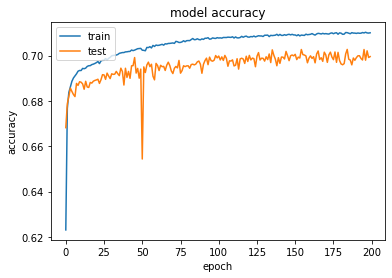

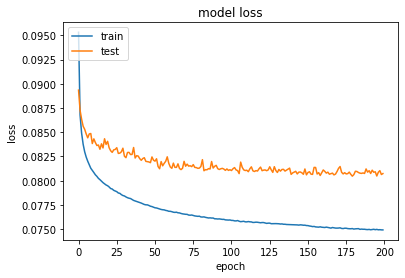

In [60]:
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [40]:
predict_ids=nn_2D.model.predict(events_hits)

## for now round predictions, though the decimal part could be interpreted
predict_ids=np.rint(predict_ids)
predict_ids

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [42]:
nn_2D.model.get_weights()

[array([[[-3.28366935e-01,  9.88107398e-02, -4.62551713e-02, ...,
          -7.01222615e-03, -5.28660901e-02,  3.90528068e-02],
         [-1.58148634e+00,  3.49321961e-02,  1.48382440e-01, ...,
           2.05728356e-02,  3.21738511e-01,  7.03698397e-02],
         [-2.67852038e-01,  1.03847578e-01, -6.31179512e-02, ...,
           1.35043589e-02,  1.01031214e-01,  1.14803746e-01],
         ...,
         [ 2.77482904e-03,  6.86274841e-02,  1.10869086e-03, ...,
           1.75363243e-01,  1.17385380e-01,  3.64953913e-02],
         [ 1.35255456e-01, -1.56535059e-01, -1.79295644e-01, ...,
           8.56510177e-02,  1.55519277e-01,  7.47138485e-02],
         [ 1.42096030e-02, -2.38672659e-01, -1.51683465e-01, ...,
           6.37889504e-02,  4.56718951e-02,  1.20878309e-01]],
 
        [[ 2.65273660e-01,  9.93591964e-01, -1.85979620e-01, ...,
           3.16404700e-02, -7.08584264e-02, -2.67067440e-02],
         [ 3.35044742e-01,  3.15704347e-05,  1.35415763e-01, ...,
           2.16400120

Truth for event #0 ::


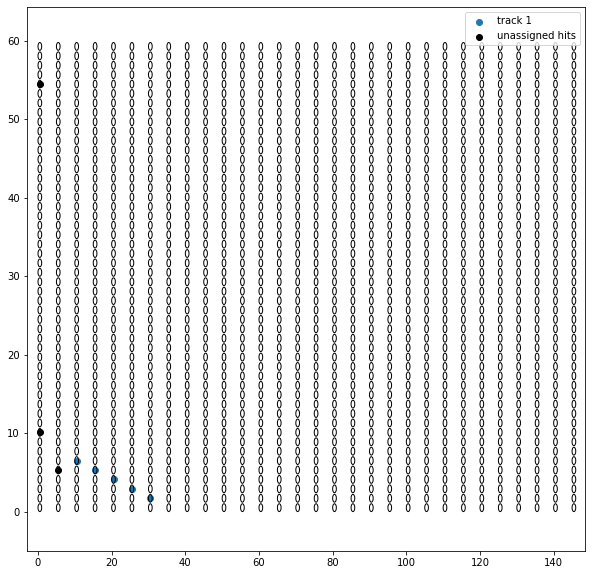

Prediction for event #0 ::


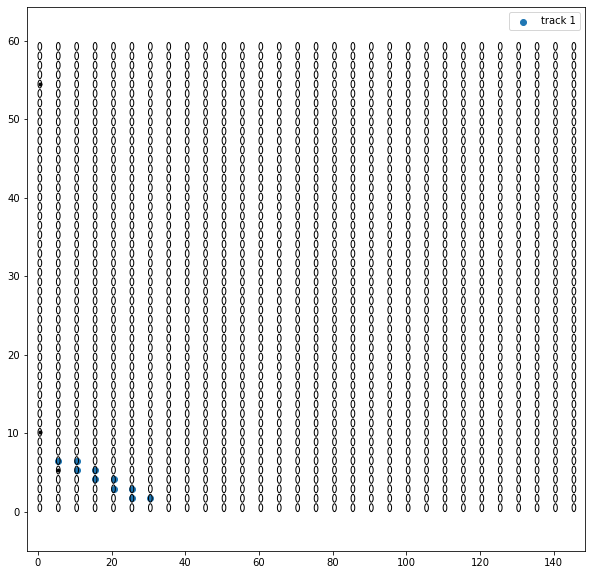

Truth for event #1 ::


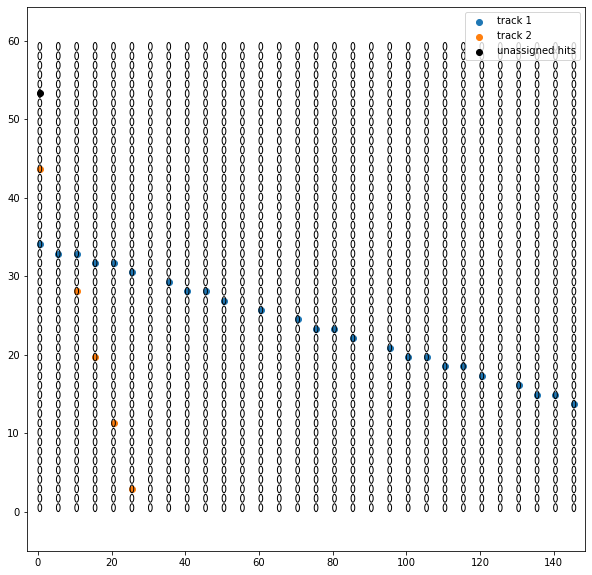

Prediction for event #1 ::


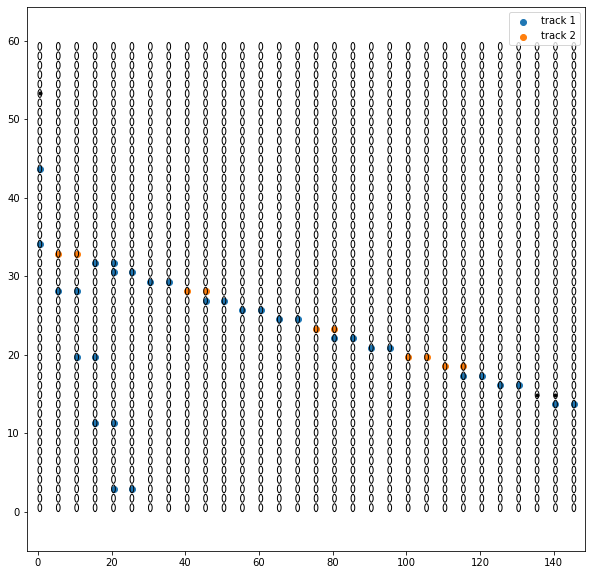

Truth for event #2 ::


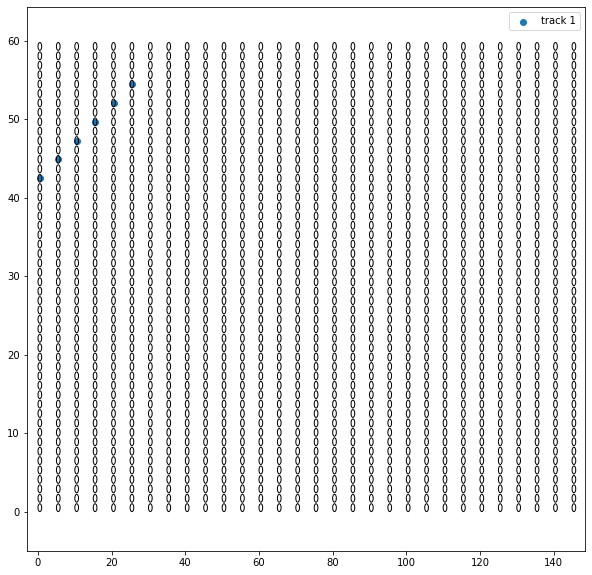

Prediction for event #2 ::


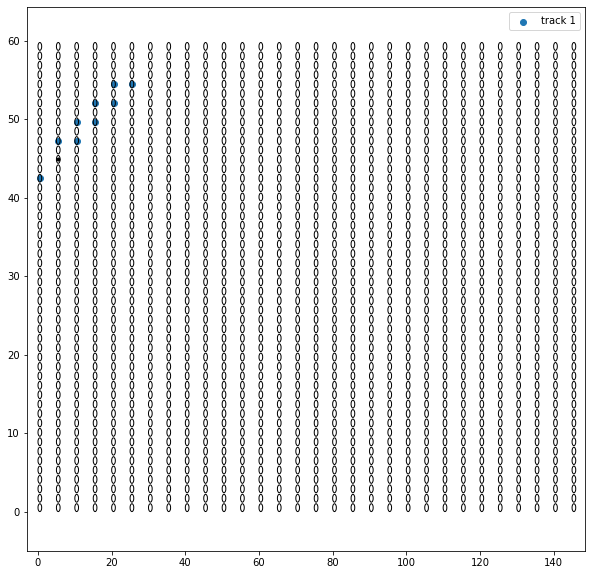

Truth for event #3 ::


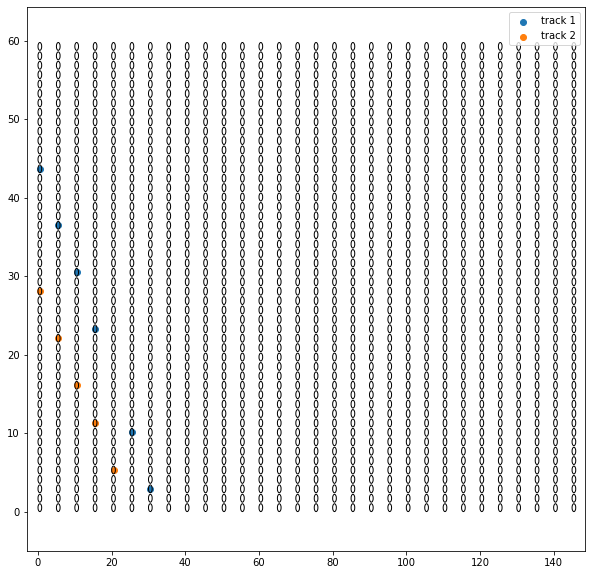

Prediction for event #3 ::


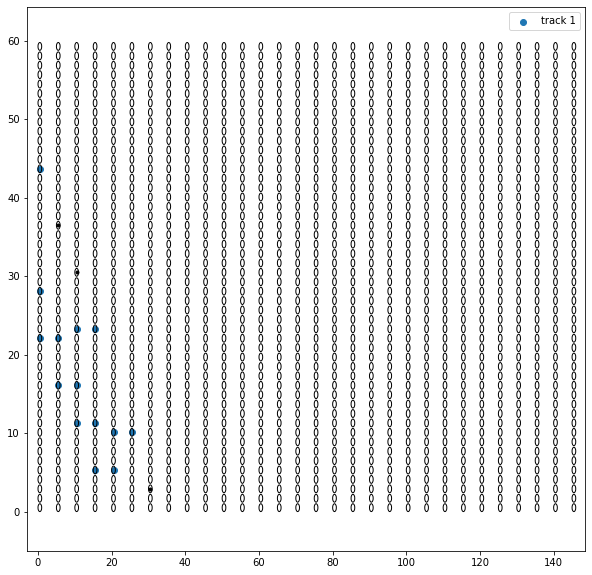

Truth for event #4 ::


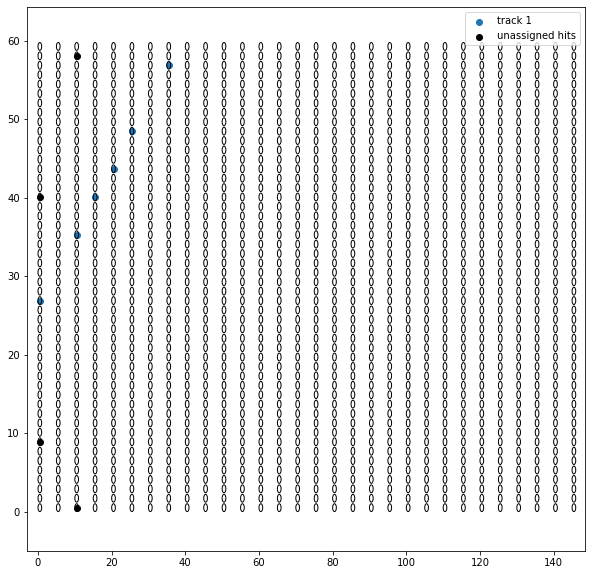

Prediction for event #4 ::


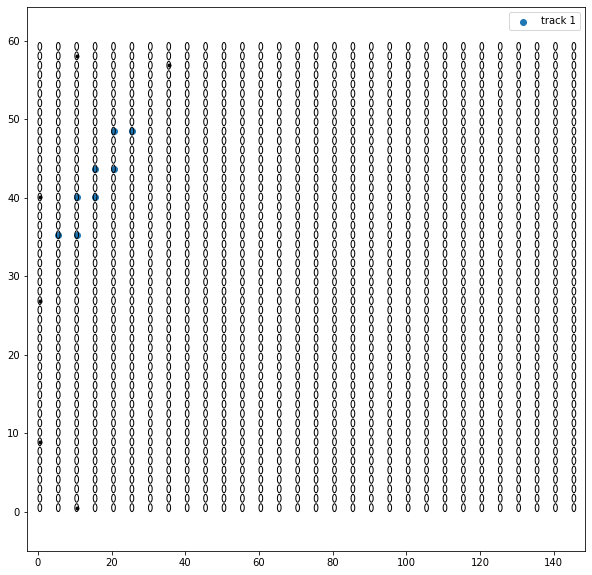

In [35]:
for i_evt in range(5):
    print ('Truth for event #%d ::'%i_evt)
    display_event(det, events_hits[i_evt], events_ids[i_evt])
    print ('Prediction for event #%d ::'%i_evt)
    display_event(det, events_hits[i_evt], predict_ids[i_evt])